# WT

In [168]:
np.random.permutation(x_train[:5,:2])

array([[-3.   , -3.   ],
       [-3.   , -3.   ],
       [-3.   , -3.   ],
       [-3.   , -3.   ],
       [ 0.035,  0.029]])

In [217]:
x_columns

['Coherency20',
 'Energy20',
 'MeanInt20',
 'VarInt20',
 'Density20',
 'VarDensity20',
 'OrientationRef20',
 'Coherency60',
 'Energy60',
 'MeanInt60',
 'VarInt60',
 'Density60',
 'VarDensity60',
 'OrientationRef60',
 'Coherency100',
 'Energy100',
 'MeanInt100',
 'VarInt100',
 'Density100',
 'VarDensity100',
 'OrientationRef100',
 'Coherency140',
 'Energy140',
 'MeanInt140',
 'VarInt140',
 'Density140',
 'VarDensity140',
 'OrientationRef140']

In [1]:
%matplotlib inline
# Import modules

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import graphviz
from sklearn import tree
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, matthews_corrcoef,\
    roc_curve, auc, confusion_matrix, ConfusionMatrixDisplay

# Local modules
import constantes
import auxiliary
import models
import plots

In [2]:
seed = 42  # random seed for reproductibility

# Selected phenotype
type = "cd3"
condition = "wt"
sess = f"{type}_{condition}"  # session condition

In [3]:
data_dirpath = auxiliary.to_dirpath(constantes.DATA_DIR)
out_dirpath = auxiliary.to_dirpath(constantes.OUTPUT_DIR)

# create path to {sess} output directory
sess_dirpath = auxiliary.create_dir(f"{out_dirpath}{sess}")
sess_perf_dirpath = auxiliary.create_dir(f"{sess_dirpath}{'performances'}")
sess_tree_dirpath = auxiliary.create_dir(f"{sess_dirpath}{'tree'}")
sess_imp_dirpath = auxiliary.create_dir(f"{sess_dirpath}{'importances'}")

In [4]:
# Used dataset
dataframe = auxiliary.read_dataframe(
    filepath=f"{data_dirpath}{'WT-KI'}_{type.upper()}_{'IN-TUMOR_aberrant'}.csv",
)

# Data first values
dataframe.head()

,Condition,FileName,X,Y,Coherency100,Energy100,MeanInt100,VarInt100,Density100,VarDensity100,...,CellEcc,Cells100um,MinDist100um,MedDist100um,CellArea100um,CellEcc100um,Frac,class_t_plus,class_t_enriched,class_t_enriched_2
0,WT,./12c_ZF_ MAX_12c_MW137_CD3FITC_SHG.tif,4987,625,-3.0,-3.0,-3.0,-3.0,0.0,-3.0,...,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0,0,0
1,WT,./12c_ZF_ MAX_12c_MW137_CD3FITC_SHG.tif,4867,665,-3.0,-3.0,-3.0,-3.0,0.0,-3.0,...,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0,0,0
2,WT,./12c_ZF_ MAX_12c_MW137_CD3FITC_SHG.tif,4907,665,-3.0,-3.0,-3.0,-3.0,0.0,-3.0,...,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0,0,0
3,WT,./12c_ZF_ MAX_12c_MW137_CD3FITC_SHG.tif,4947,665,-3.0,-3.0,-3.0,-3.0,0.0,-3.0,...,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0,0,0
4,WT,./12c_ZF_ MAX_12c_MW137_CD3FITC_SHG.tif,4987,665,-3.0,-3.0,-3.0,-3.0,0.0,-3.0,...,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0,0,0


In [5]:
# Mask for the studied phenotype
MASK_TYPE = dataframe["Type"] == type.upper()
MASK_COND = dataframe["Condition"] == condition.upper()

In [6]:
# Main data with selected phenotype
data = dataframe[MASK_TYPE & MASK_COND]

In [7]:
# Column features (without Dist & Angle information)
x_columns = [
    *constantes.float20_columns_unloc,
    *constantes.float60_columns_unloc,
    *constantes.float100_columns_unloc,
    *constantes.float140_columns_unloc
]

# Features columns with Dist & Angle attributes
x_loc_columns = [
    *constantes.float20_columns,
    *constantes.float60_columns,
    *constantes.float100_columns,
    *constantes.float140_columns,
    *constantes.dist_columns
]

# T plus

Prédiction des fenêtres de classe T+

In [8]:
# Respective directory for the designed class
plus_perf_dirpath = auxiliary.create_dir(f"{sess_perf_dirpath}{'plus'}")
plus_tree_dirpath = auxiliary.create_dir(f"{sess_tree_dirpath}{'plus'}")
plus_imp_dirpath = auxiliary.create_dir(f"{sess_imp_dirpath}{'plus'}")

### Jeu de données d'apprentissage et de validation (avec valeurs abérrantes)

In [9]:
# Target column
y_column = "class_t_plus"

# Define x and y dataframe
xy = data[x_loc_columns + [y_column]].dropna()

# features
x = xy[x_columns].values
x_loc = xy[x_loc_columns].values  # with distance/angle

# target value
y = xy[y_column].values

## Train and Validation
x_train, x_test, y_train, y_test = train_test_split(
    x, y, test_size=0.3, random_state=seed, stratify=y
)

# With (Angle & Dist)
x_loc_train, x_loc_test, y_loc_train, y_loc_test = train_test_split(
    x_loc, y, test_size=0.3, random_state=seed, stratify=y
)

In [10]:
print(f"----- T plus -----")
print(f"\n{'Comptage des classes :':<30s}{'0':<6s}{'':2s}{'1':>6s}")
print(f"{'y:':30s}{sum(y == 0):>6d}{'':2s}{sum(y == 1):>6d}")
print(f"{'y_train:':30s}{sum(y_train == 0):>6d}{'':2s}{sum(y_train == 1):>6d}")
print(f"{'y_test:':30s}{sum(y_test == 0):>6d}{'':2s}{sum(y_test == 1):>6d}")
print(f"\nNombre d'observations totales : {y.shape[0]:_}")

----- T plus -----

Comptage des classes :        0            1
y:                            204296  566470
y_train:                      143007  396529
y_test:                        61289  169941

Nombre d'observations totales : 770_766


#### Arbre de décision

In [11]:
depths_dtree = [2, 4, 6, 8, 10, 15, 20]

# Results with best selected depth
results_t_plus = models.forest_depth_acc(
    x_train, y_train, x_test, y_test,
    depths=depths_dtree, 
    classifier=DecisionTreeClassifier,
    random_state=seed,
    class_weight="balanced"
)

# Results with best selected depth (with Dist & Angle)
results_loc_t_plus = models.forest_depth_acc(
    x_loc_train, y_loc_train, x_loc_test, y_loc_test,
    depths=depths_dtree, 
    classifier=DecisionTreeClassifier,
    random_state=seed,
    class_weight="balanced"
)

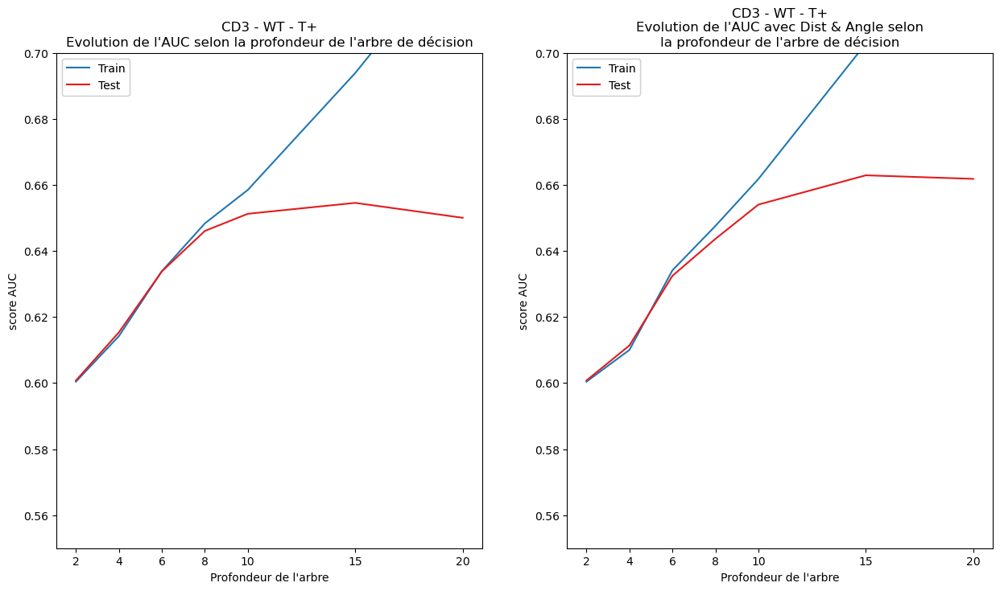

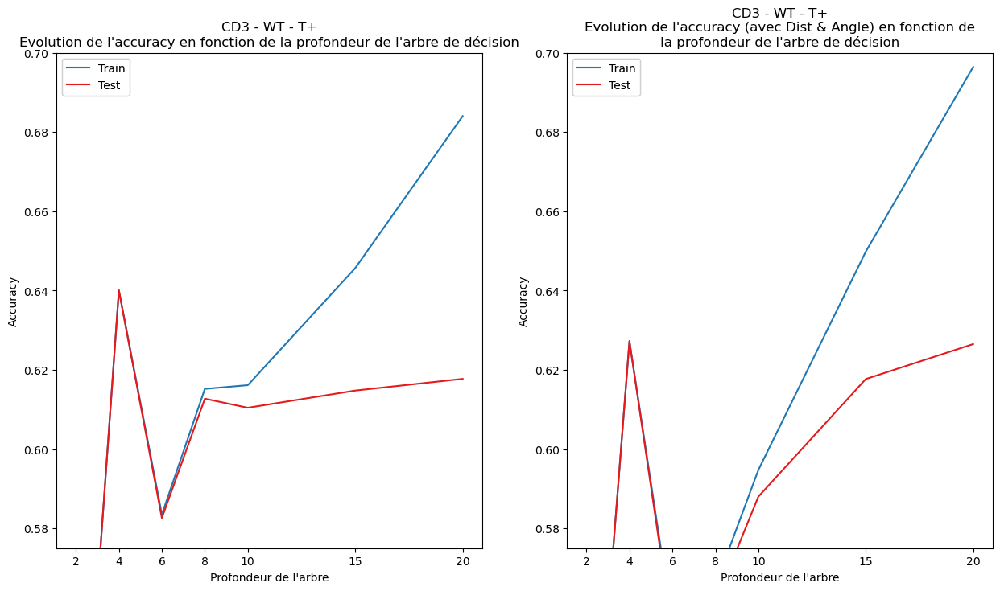

In [12]:
# Plot - AUC
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))
plots.plot(
    results_t_plus["auc_train"],
    results_t_plus["auc_test"],
    indices=results_t_plus["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T+\n"
          "Evolution de l'AUC selon la profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=depths_dtree, showR2=False, showY=False,
    ybottom=0.55, ytop=0.7, figure=(fig, ax1)
)

plots.plot(
    results_loc_t_plus["auc_train"],
    results_loc_t_plus["auc_test"],
    indices=results_loc_t_plus["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T+\n"
          "Evolution de l'AUC avec Dist & Angle selon\n"
          "la profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=depths_dtree, showR2=False, showY=False,
    ybottom=0.55, ytop=0.7, figure=(fig, ax2),
)

# Saving plot
fig.savefig(f"{plus_perf_dirpath}{sess}_t-plus_auc-decisiontree")

# Showing plot
plt.show()

# Plot - Accuracy
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_t_plus["acc_train"],
    results_t_plus["acc_test"],
    indices=results_t_plus["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T+\n"
          "Evolution de l'accuracy en fonction de la "
          "profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=depths_dtree, showR2=False, showY=False,
    ybottom=0.575, ytop=0.7, figure=(fig, ax1)
)

plots.plot(
    results_loc_t_plus["acc_train"],
    results_loc_t_plus["acc_test"],
    indices=results_loc_t_plus["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T+\n"
          "Evolution de l'accuracy (avec Dist & Angle) en "
          "fonction de\nla profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=depths_dtree, showR2=False, showY=False,
    ybottom=0.575, ytop=0.7, figure=(fig, ax2),
)

# Saving plot
fig.savefig(f"{plus_perf_dirpath}{sess}_t-plus_accuracy-decisiontree")

# Showing plot
plt.show()

In [13]:
print("----- Résumé des performances en classe T plus, arbre de décision -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_t_plus["depths"]] ; print("\n")

print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus["auc_test"]] ; print("\n")
print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus["acc_test"]] ; print("\n")
print(f"{'MCC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus["mcc_train"]] ; print()
print(f"{'MCC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus["mcc_test"]] ; print("\n")

print("--- with Dist & Angle")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_plus["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_plus["auc_test"]] ; print("\n")
print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_plus["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_plus["acc_test"]] ; print("\n")
print(f"{'MCC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_plus["mcc_train"]] ; print()
print(f"{'MCC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_plus["mcc_test"]] ; print()

----- Résumé des performances en classe T plus, arbre de décision -----
Profondeur          : 2     4     6     8     10    15    20    

AUC_train           : 0.60  0.61  0.63  0.65  0.66  0.69  0.73  
AUC_test            : 0.60  0.62  0.63  0.65  0.65  0.65  0.65  

Accuracy_train      : 0.49  0.64  0.58  0.62  0.62  0.65  0.68  
Accuracy_test       : 0.49  0.64  0.58  0.61  0.61  0.61  0.62  

MCC_train           : 0.19  0.21  0.24  0.26  0.28  0.34  0.41  
MCC_test            : 0.19  0.21  0.24  0.26  0.27  0.27  0.26  

--- with Dist & Angle
AUC_train_dist      : 0.60  0.61  0.63  0.65  0.66  0.70  0.75  
AUC_test_dist       : 0.60  0.61  0.63  0.64  0.65  0.66  0.66  

Accuracy_train_dist : 0.49  0.63  0.56  0.57  0.59  0.65  0.70  
Accuracy_test_dist  : 0.49  0.63  0.55  0.56  0.59  0.62  0.63  

MCC_train_dist      : 0.19  0.20  0.24  0.27  0.29  0.36  0.44  
MCC_test_dist       : 0.19  0.20  0.24  0.26  0.27  0.29  0.29  


In [14]:
# TODO: Save auc, accuracy, mcc values to performances directory

In [15]:
# Decision Tree (CART)
dtree_plus = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=12,
    random_state=seed,
    class_weight="balanced"
)

# Decision Tree (CART) with Dist column
dtree_loc_plus = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=12,
    random_state=seed,
    class_weight="balanced"
)

In [16]:
# Fitting models on data
dtree_plus.fit(x_train, y_train)
dtree_loc_plus.fit(x_loc_train, y_loc_train)

# Prediction on train and validation
y_train_pred = dtree_plus.predict(x_train)
y_test_pred = dtree_plus.predict(x_test)

y_loc_train_pred = dtree_loc_plus.predict(x_loc_train)
y_loc_test_pred = dtree_loc_plus.predict(x_loc_test)

# Labels (for re-assignment)
dtree_plus.classes_ = \
dtree_loc_plus.classes_ = \
labels_class_plus = pd.Series(dtree_plus.classes_).map(
    {0: 'not_plus', 1: 'plus'}
).values

In [17]:
# ROC values - false positive rate (fpr), and true positive rate (tpr)
fpr_train, tpr_train, _ = roc_curve(y_train, y_train_pred)
fpr_test, tpr_test, _ = roc_curve(y_test, y_test_pred)

fpr_loc_train, tpr_loc_train, _ = roc_curve(y_loc_train, y_loc_train_pred)
fpr_loc_test, tpr_loc_test, _ = roc_curve(y_loc_test, y_loc_test_pred)

# Model performances, how often is the classifier correct?
# train
acc_train = accuracy_score(y_train, y_train_pred)
mcc_train = matthews_corrcoef(y_train, y_train_pred)
auc_train = auc(fpr_train, tpr_train)
# test
acc_test = accuracy_score(y_test, y_test_pred)
mcc_test = matthews_corrcoef(y_test, y_test_pred)
auc_test = auc(fpr_test, tpr_test)

# with dist & angle
# train
acc_loc_train = accuracy_score(y_loc_train, y_loc_train_pred)
mcc_loc_train = matthews_corrcoef(y_loc_train, y_loc_train_pred)
auc_loc_train = auc(fpr_loc_train, tpr_loc_train)
# test
acc_loc_test = accuracy_score(y_loc_test, y_loc_test_pred)
mcc_loc_test = matthews_corrcoef(y_loc_test, y_loc_test_pred)
auc_loc_test = auc(fpr_loc_test, tpr_loc_test)

----- Arbre de décision T+ -----
Train
Accuracy   = 0.620
AUC        = 0.668
MCC        = 0.297

Test
Accuracy   = 0.609
AUC        = 0.654
MCC        = 0.272


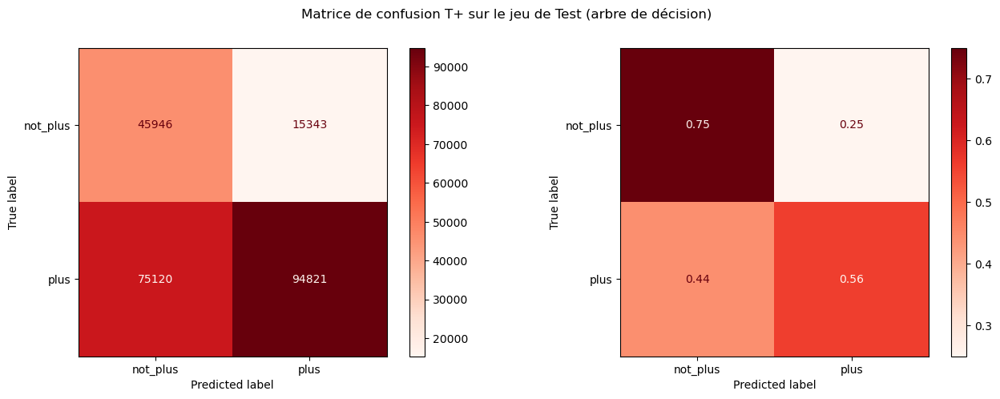

In [18]:
print("----- Arbre de décision T+ -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_train:2.3f}")
print(f"{'AUC':<10s} = {auc_train:2.3f}")
print(f"{'MCC':<10s} = {mcc_train:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_test:2.3f}")
print(f"{'AUC':<10s} = {auc_test:2.3f}")
print(f"{'MCC':<10s} = {mcc_test:2.3f}")

# Confusion matrix
cmap_color = "Reds"
cmatrix = confusion_matrix(y_test, y_test_pred)
cmatrix_norm = confusion_matrix(y_test, y_test_pred, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T+ sur le jeu de Test (arbre de décision)")
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix,
    display_labels=labels_class_plus,
).plot(ax=ax1, cmap=cmap_color)

ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_norm,
    display_labels=labels_class_plus,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{plus_perf_dirpath}{sess}_t-plus_cmatrix-dtree-test")

# Show Figure
plt.show()

----- Arbre de décision T+ (with Dist & Angle) -----
Train
Accuracy   = 0.628
AUC        = 0.674
MCC        = 0.307

Test
Accuracy   = 0.615
AUC        = 0.659
MCC        = 0.280


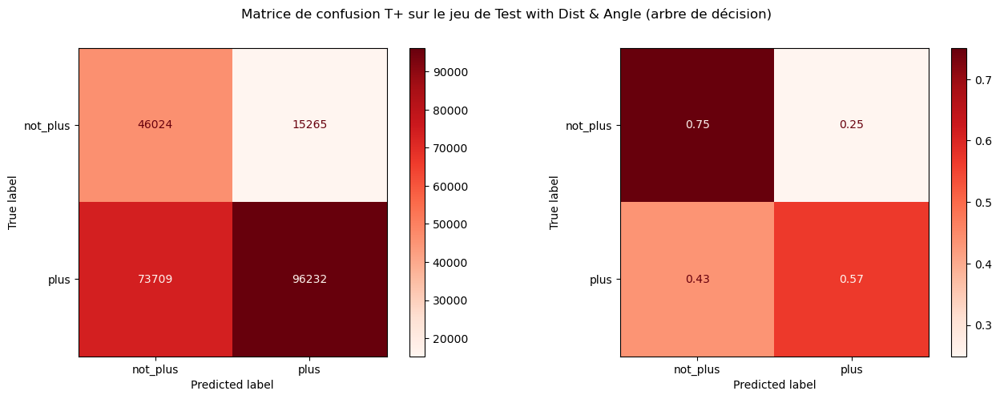

In [19]:
print("----- Arbre de décision T+ (with Dist & Angle) -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_loc_train:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_train:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_train:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_loc_test:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_test:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_test:2.3f}")

# Confusion matrix
cmap_color = "Reds"
cmatrix_loc = confusion_matrix(y_loc_test, y_loc_test_pred)
cmatrix_loc_norm = confusion_matrix(y_loc_test, y_loc_test_pred, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T+ sur le jeu de Test with Dist & Angle (arbre de décision)")

# Confusion Matrix displaying count
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc,
    display_labels=labels_class_plus,
).plot(ax=ax1, cmap=cmap_color)

# Confusion Matrix displaying ratio on true label
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc_norm,
    display_labels=labels_class_plus,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{plus_perf_dirpath}{sess}_t-plus_loc-cmatrix-dtree-test")

# Show Figure
plt.show()

In [20]:
# Decision tree text representation
dtree_text = tree.export_text(
    dtree_plus,
    feature_names=x_columns,
    #class_names=dtree_plus.classes_,  # sklearn > 1.3.0
    max_depth=16
)

with open(f"{plus_tree_dirpath}{sess}_t-plus_text-dtree.txt", "w") as txt:
    txt.write(dtree_text)

# Decision tree plot (too large)
dtree_dot = tree.export_graphviz(
    dtree_plus,
    feature_names=x_columns,
    class_names=dtree_plus.classes_,
    filled=True
)
dtree_dot = plots.node_color(dtree_dot)

dtree_graph = graphviz.Source(dtree_dot, format="png")
dtree_graph.render(f"{plus_tree_dirpath}{sess}_t-plus_dtree")
dtree_graph

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.0931304 to fit


In [21]:
# Decision tree text representation
dtree_loc_text = tree.export_text(
    dtree_loc_plus,
    feature_names=x_loc_columns,
    #class_names=dtree_loc_plus.classes_,  # sklearn > 1.3.0
    max_depth=16
)

with open(f"{plus_tree_dirpath}{sess}_t-plus_loc-text-dtree.txt", "w") as txt:
    txt.write(dtree_loc_text)

# Decision tree plot (too large)
dtree_loc_dot = tree.export_graphviz(
    dtree_loc_plus,
    feature_names=x_loc_columns,
    class_names=dtree_loc_plus.classes_,
    filled=True
)
dtree_loc_dot = plots.node_color(dtree_loc_dot)

dtree_loc_graph = graphviz.Source(dtree_dot, format="png")
dtree_loc_graph.render(f"{plus_tree_dirpath}{sess}_t-plus_loc-dtree")
dtree_loc_graph

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.0931304 to fit


# Random Forest

In [22]:
depths_rf = [2, 6, 10, 20, 25]

# Results with best selected depth
results_t_plus_rf = models.forest_depth_acc(
    x_train, y_train, x_test, y_test,
    depths=depths_rf, 
    classifier=RandomForestClassifier,
    class_weight="balanced",
    random_state=seed,
    n_estimators = 100,
    n_jobs=-1
)

# Results with best selected depth (with Dist & Angle)
results_loc_t_plus_rf = models.forest_depth_acc(
    x_loc_train, y_loc_train, x_loc_test, y_loc_test,
    depths=depths_rf, 
    classifier=RandomForestClassifier,
    class_weight="balanced",
    random_state=seed,
    n_estimators = 100,
    n_jobs=-1
)

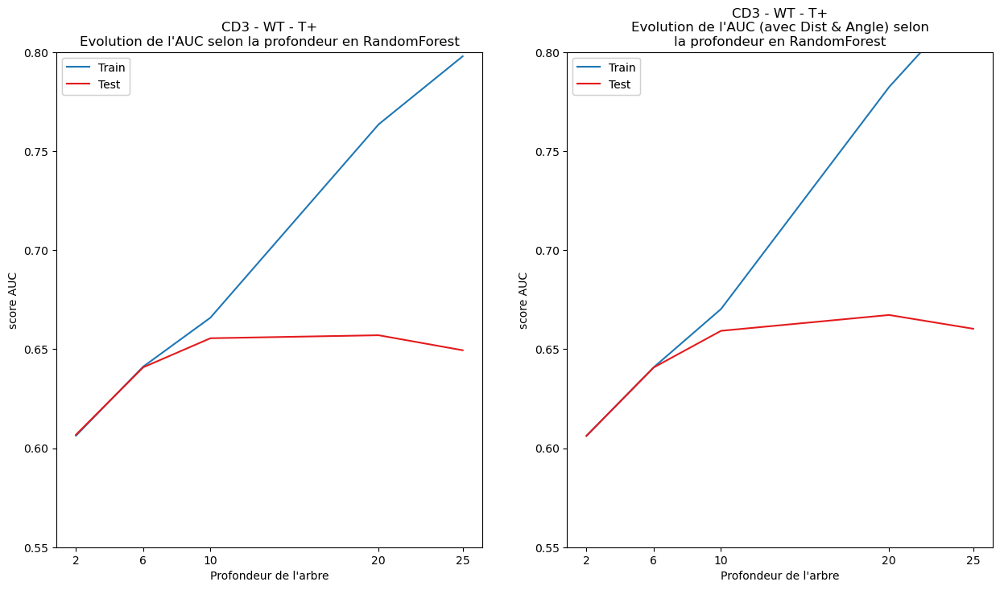

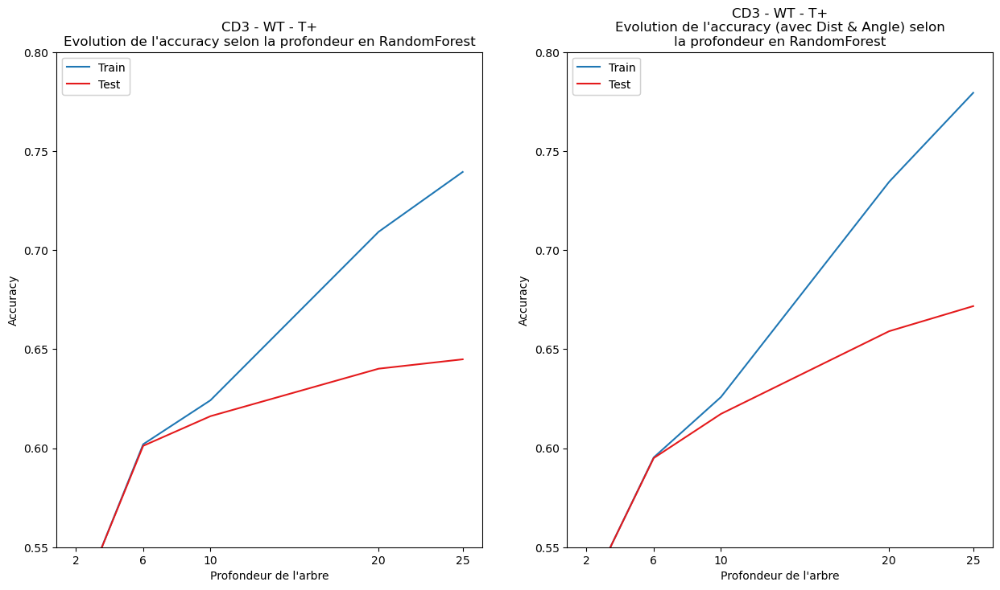

In [23]:
# Plot - auc
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_t_plus_rf["auc_train"],
    results_t_plus_rf["auc_test"],
    indices=results_t_plus_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T+\n"
          "Evolution de l'AUC selon la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=results_t_plus_rf["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=0.8, figure=(fig, ax1)
)

plots.plot(
    results_loc_t_plus_rf["auc_train"],
    results_loc_t_plus_rf["auc_test"],
    indices=results_loc_t_plus_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T+\n"
          "Evolution de l'AUC (avec Dist & Angle) selon\n"
          "la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=results_loc_t_plus_rf["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=0.8, figure=(fig, ax2)
)

# Saving plot
fig.savefig(f"{plus_perf_dirpath}{sess}_t-plus_auc-rforest")

# Showing plot
plt.show()

# Plot - accuracy
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_t_plus_rf["acc_train"],
    results_t_plus_rf["acc_test"],
    indices=results_t_plus_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T+\n"
          "Evolution de l'accuracy selon la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=results_t_plus_rf["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=0.8, figure=(fig, ax1)
)

plots.plot(
    results_loc_t_plus_rf["acc_train"],
    results_loc_t_plus_rf["acc_test"],
    indices=results_loc_t_plus_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T+\n"
          "Evolution de l'accuracy (avec Dist & Angle) selon\n"
          "la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=results_loc_t_plus_rf["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=0.8, figure=(fig, ax2)
)

# Saving plot
fig.savefig(f"{plus_perf_dirpath}{sess}_t-plus_accuracy-rforest")

# Showing plot
plt.show()

In [24]:
print("----- Résumé des performances en classe T plus, random forest -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_t_plus_rf["depths"]] ; print("\n")

print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus_rf["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus_rf["auc_test"]] ; print("\n")
print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus_rf["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus_rf["acc_test"]] ; print("\n")
print(f"{'MCC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus_rf["mcc_train"]] ; print()
print(f"{'MCC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus_rf["mcc_test"]] ; print("\n")

print("--- with Dist & Angle")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_plus_rf["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_plus_rf["auc_test"]] ; print("\n")
print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_plus_rf["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_plus_rf["acc_test"]] ; print("\n")
print(f"{'MCC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_plus_rf["mcc_train"]] ; print()
print(f"{'MCC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_plus_rf["mcc_test"]] ; print()

----- Résumé des performances en classe T plus, random forest -----
Profondeur          : 2     6     10    20    25    

AUC_train           : 0.61  0.64  0.67  0.76  0.80  
AUC_test            : 0.61  0.64  0.66  0.66  0.65  

Accuracy_train      : 0.52  0.60  0.62  0.71  0.74  
Accuracy_test       : 0.52  0.60  0.62  0.64  0.64  

MCC_train           : 0.20  0.25  0.29  0.47  0.53  
MCC_test            : 0.20  0.25  0.27  0.28  0.27  

--- with Dist & Angle
AUC_train_dist      : 0.61  0.64  0.67  0.78  0.83  
AUC_test_dist       : 0.61  0.64  0.66  0.67  0.66  

Accuracy_train_dist : 0.53  0.60  0.63  0.73  0.78  
Accuracy_test_dist  : 0.53  0.60  0.62  0.66  0.67  

MCC_train_dist      : 0.19  0.25  0.30  0.50  0.58  
MCC_test_dist       : 0.19  0.25  0.28  0.30  0.29  


In [25]:
# Random search parameters
n_estimators_plus = (10, 15, 20, 30)
n_depths_plus = (2, 4, 8, 10, 15)

Best hyperparameters: {'n_estimators': 15, 'max_depth': 15}
Test Accuracy: 0.6225533019071919
Computing MDI importances
Elapsed time to compute mean decrease impurity (MDI) importance: 0.003 seconds

Computing permutation importances 
Elapsed time to compute permutation importance: 16.532 seconds



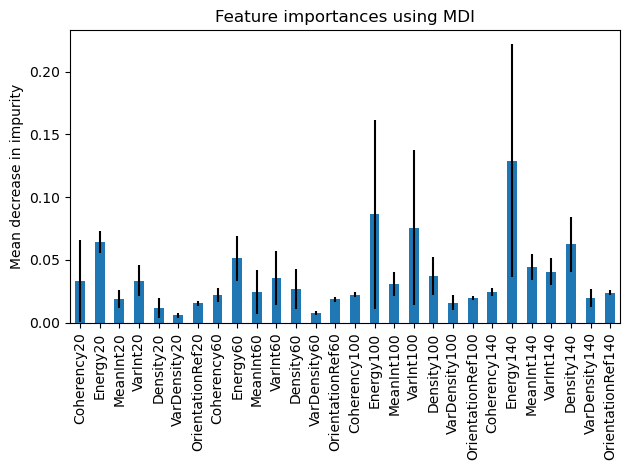

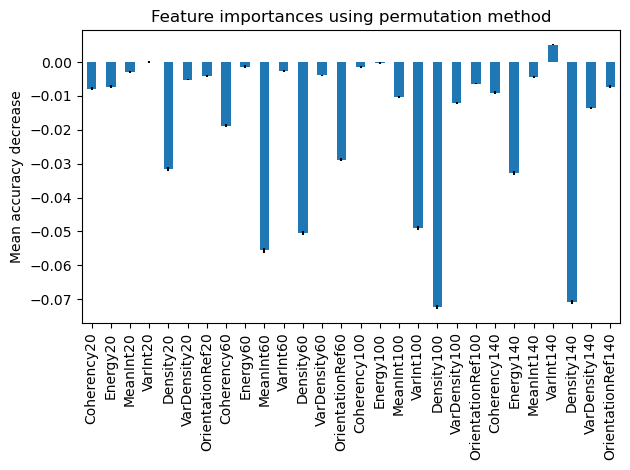

In [26]:
# RandomForest model
results_rf_plus = models.perform_random_forest(
    x_train=x_train,
    x_test=x_test,
    y_train=y_train,
    y_test=y_test,
    columns=x_columns,
    n_estimators=n_estimators_plus,
    n_depths=n_depths_plus,
    class_weight="balanced",
    scale=False,
    seed=seed
)

# Save MDI importances
df_mdi_rf_plus = pd.DataFrame(
    {
        "mean": results_rf_plus["importance_mdi"]["mean"],
        "std": results_rf_plus["importance_mdi"]["std"]
    }, index=x_columns
)

df_mdi_rf_plus.to_csv(f"{plus_imp_dirpath}{sess}_t-plus_mdi_rforest.csv")  # save

# Save permutation importances
df_permutation_rf_plus = pd.DataFrame(
    {
        "mean": results_rf_plus["importance_permutation"]["mean"],
        "std": results_rf_plus["importance_permutation"]["std"]
    }, index=x_columns
)

df_permutation_rf_plus.to_csv(f"{plus_imp_dirpath}{sess}_t-plus_permu_rforest.csv")  # save

# Model with best parameters
rf_plus = results_rf_plus["model"]

Best hyperparameters: {'n_estimators': 15, 'max_depth': 15}
Test Accuracy: 0.6374432383341262
Computing MDI importances
Elapsed time to compute mean decrease impurity (MDI) importance: 0.010 seconds

Computing permutation importances 
Elapsed time to compute permutation importance: 37.088 seconds



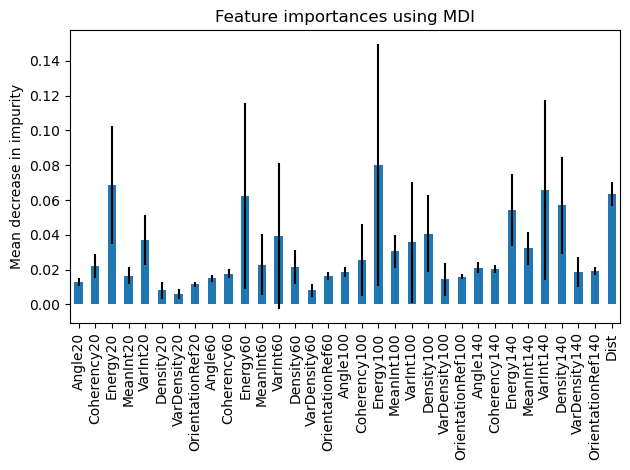

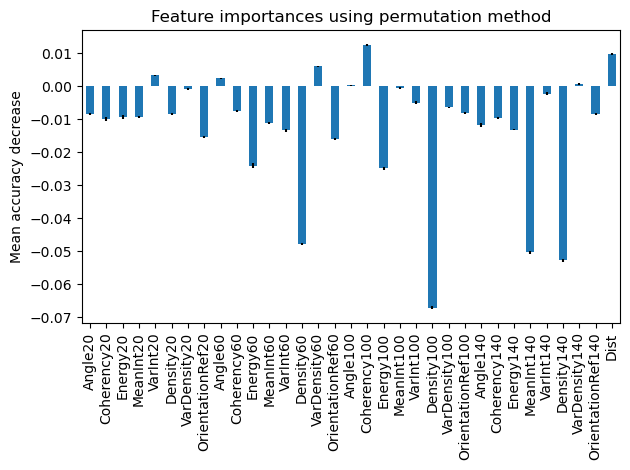

In [27]:
# RandomForest model with Dist & Angle
results_rf_loc_plus = models.perform_random_forest(
    x_train=x_loc_train,
    x_test=x_loc_test,
    y_train=y_loc_train,
    y_test=y_loc_test,
    columns=x_loc_columns,
    n_estimators=n_estimators_plus,
    n_depths=n_depths_plus,
    class_weight="balanced",
    scale=False,
    seed=seed
)

# Save MDI importances
df_mdi_rf_loc_plus = pd.DataFrame(
    {
        "mean": results_rf_loc_plus["importance_mdi"]["mean"],
        "std": results_rf_loc_plus["importance_mdi"]["std"]
    }, index=x_loc_columns
)

df_mdi_rf_loc_plus.to_csv(f"{plus_imp_dirpath}{sess}_t-plus_loc-mdi_rforest.csv")  # save

# Save permutation importances
df_permutation_rf_loc_plus = pd.DataFrame(
    {
        "mean": results_rf_loc_plus["importance_permutation"]["mean"],
        "std": results_rf_loc_plus["importance_permutation"]["std"]
    }, index=x_loc_columns
)

df_permutation_rf_loc_plus.to_csv(f"{plus_imp_dirpath}{sess}_t-plus_loc-permu_rforest.csv")

# Model with best parameters
rf_loc_plus = results_rf_loc_plus["model"]

In [28]:
# Prediction on train and validation
y_train_pred_rf = rf_plus.predict(x_train)
y_test_pred_rf = rf_plus.predict(x_test)

y_loc_train_pred_rf = rf_loc_plus.predict(x_loc_train)
y_loc_test_pred_rf = rf_loc_plus.predict(x_loc_test)

# Labels
labels_class_plus

array(['not_plus', 'plus'], dtype=object)

In [29]:
# ROC values - false positive rate (fpr), and true positive rate (tpr)
fpr_train_rf, tpr_train_rf, _ = roc_curve(y_train, y_train_pred_rf)
fpr_test_rf, tpr_test_rf, _ = roc_curve(y_test, y_test_pred_rf)

fpr_loc_train_rf, tpr_loc_train_rf, _ = roc_curve(y_loc_train, y_loc_train_pred_rf)
fpr_loc_test_rf, tpr_loc_test_rf, _ = roc_curve(y_loc_test, y_loc_test_pred_rf)

# Model performances, how often is the classifier correct?
# train
acc_train_rf = accuracy_score(y_train, y_train_pred_rf)
mcc_train_rf = matthews_corrcoef(y_train, y_train_pred_rf)
auc_train_rf = auc(fpr_train_rf, tpr_train_rf)
# test
acc_test_rf = accuracy_score(y_test, y_test_pred_rf)
mcc_test_rf = matthews_corrcoef(y_test, y_test_pred_rf)
auc_test_rf = auc(fpr_test_rf, tpr_test_rf)

# with dist & angle
# train
acc_loc_train_rf = accuracy_score(y_loc_train, y_loc_train_pred_rf)
mcc_loc_train_rf = matthews_corrcoef(y_loc_train, y_loc_train_pred_rf)
auc_loc_train_rf = auc(fpr_loc_train_rf, tpr_loc_train_rf)
# test
acc_loc_test_rf = accuracy_score(y_loc_test, y_loc_test_pred_rf)
mcc_loc_test_rf = matthews_corrcoef(y_loc_test, y_loc_test_pred_rf)
auc_loc_test_rf = auc(fpr_loc_test_rf, tpr_loc_test_rf)

----- Random Forest T+ -----
Train
Accuracy   = 0.657
AUC        = 0.709
MCC        = 0.369

Test
Accuracy   = 0.623
AUC        = 0.661
MCC        = 0.283


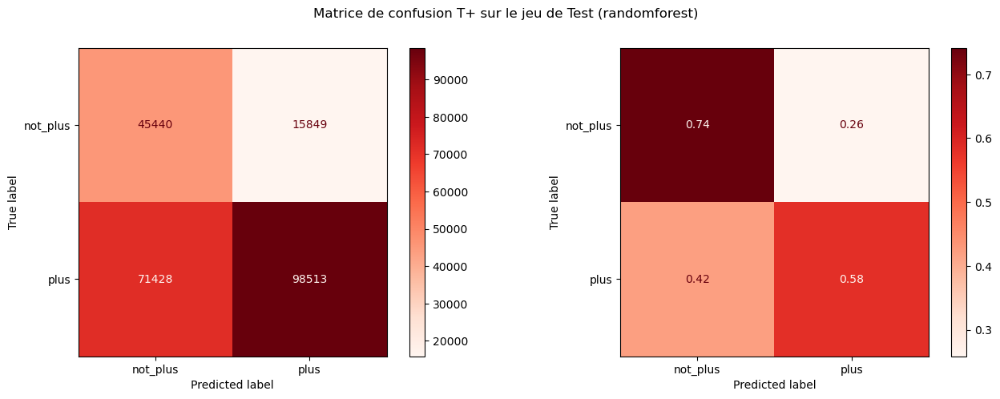

In [30]:
print("----- Random Forest T+ -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_train_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_train_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_train_rf:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_test_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_test_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_test_rf:2.3f}")


# Confusion matrix
cmap_color = "Reds"
cmatrix = confusion_matrix(y_test, y_test_pred_rf)
cmatrix_norm = confusion_matrix(y_test, y_test_pred_rf, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T+ sur le jeu de Test (randomforest)")
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix,
    display_labels=labels_class_plus,
).plot(ax=ax1, cmap=cmap_color)

ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_norm,
    display_labels=labels_class_plus,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{plus_perf_dirpath}{sess}_t-plus_cmatrix-rforest-test")

# Show Figure
plt.show()

----- Random Forest T+ (with Dist & Angle) -----
Train
Accuracy   = 0.673
AUC        = 0.719
MCC        = 0.386

Test
Accuracy   = 0.637
AUC        = 0.668
MCC        = 0.297


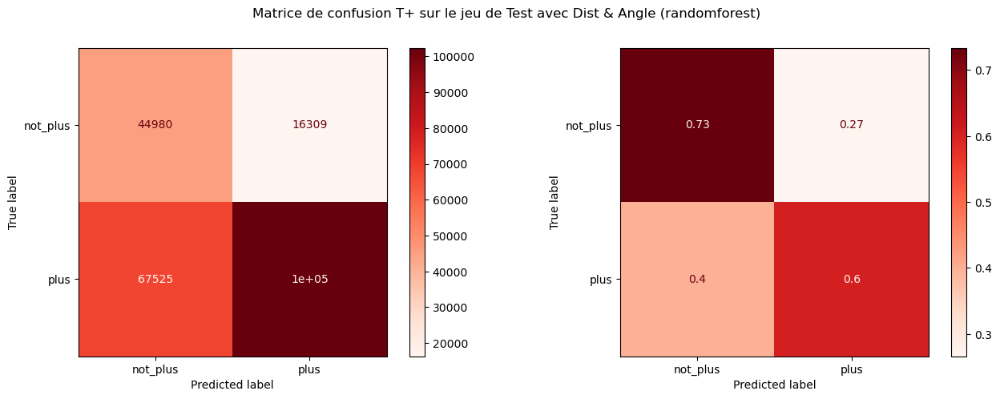

In [31]:
print("----- Random Forest T+ (with Dist & Angle) -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_loc_train_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_train_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_train_rf:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_loc_test_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_test_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_test_rf:2.3f}")


# Confusion matrix
cmap_color = "Reds"
cmatrix_loc = confusion_matrix(y_loc_test, y_loc_test_pred_rf)
cmatrix_loc_norm = confusion_matrix(y_loc_test, y_loc_test_pred_rf, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T+ sur le jeu de Test avec Dist & Angle (randomforest)")

# Confusion Matrix displaying count
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc,
    display_labels=labels_class_plus,
).plot(ax=ax1, cmap=cmap_color)

# Confusion Matrix displaying ratio on true label
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc_norm,
    display_labels=labels_class_plus,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{plus_perf_dirpath}{sess}_t-plus_loc-cmatrix-rforest-test")

# Show Figure
plt.show()

# T plus & Density20 > 0

Prédictions des fenêtres avec fibres de classes T+

### Jeu de données d'apprentissage et de validation à densité20 > 0 (sans valeurs aberrantes)

In [32]:
mask_cd3_density_in = data["Density20"] > 0

In [33]:
# Target column
y_column = "class_t_plus"

# Define x and y dataframe
xy = data[mask_cd3_density_in][x_loc_columns + [y_column]].dropna()

# features
x_dens = xy[x_columns].values  # x
x_dens_loc = xy[x_loc_columns].values  # x_loc

# target value
y_dens = xy[y_column].values  # y

# Train and Validation set
x_dens_train, x_dens_test, y_dens_train, y_dens_test = train_test_split(
    x_dens, y_dens, test_size=0.3, random_state=seed, stratify=y_dens
)

# Train and Validation set with Angle & Dist
x_loc_dens_train, x_loc_dens_test, y_loc_dens_train, y_loc_dens_test = train_test_split(
    x_dens_loc, y_dens, test_size=0.3, random_state=seed, stratify=y_dens
)

In [34]:
print(f"----- T plus - density20 > 0 -----")
print(f"\n{'Comptage des classes :':<30s}{'0':<6s}{'':2s}{'1':>6s}")
print(f"{'y:':30s}{sum(y_dens == 0):>6d}{'':2s}{sum(y_dens == 1):>6d}")
print(f"{'y_train:':30s}{sum(y_dens_train == 0):>6d}{'':2s}{sum(y_dens_train == 1):>6d}")
print(f"{'y_test:':30s}{sum(y_dens_test == 0):>6d}{'':2s}{sum(y_dens_test == 1):>6d}")
print(f"\nNombre d'observations totales : {y_dens.shape[0]:_}")

----- T plus - density20 > 0 -----

Comptage des classes :        0            1
y:                             79460  291680
y_train:                       55622  204176
y_test:                        23838   87504

Nombre d'observations totales : 371_140


#### Arbre de décision

In [35]:
depths_dtree = [2, 4, 6, 8, 10, 15, 20]

# Results with best selected depth
results_dens_t_plus = models.forest_depth_acc(
    x_dens_train, y_dens_train,
    x_dens_test, y_dens_test,
    depths=depths_dtree, 
    classifier=DecisionTreeClassifier,
    random_state=seed,
    class_weight="balanced",
)

# Results with best selected depth (with Dist & Angle)
results_loc_dens_t_plus = models.forest_depth_acc(
    x_loc_dens_train, y_loc_dens_train,
    x_loc_dens_test, y_loc_dens_test,
    depths=depths_dtree, 
    classifier=DecisionTreeClassifier,
    random_state=seed,
    class_weight="balanced",
)

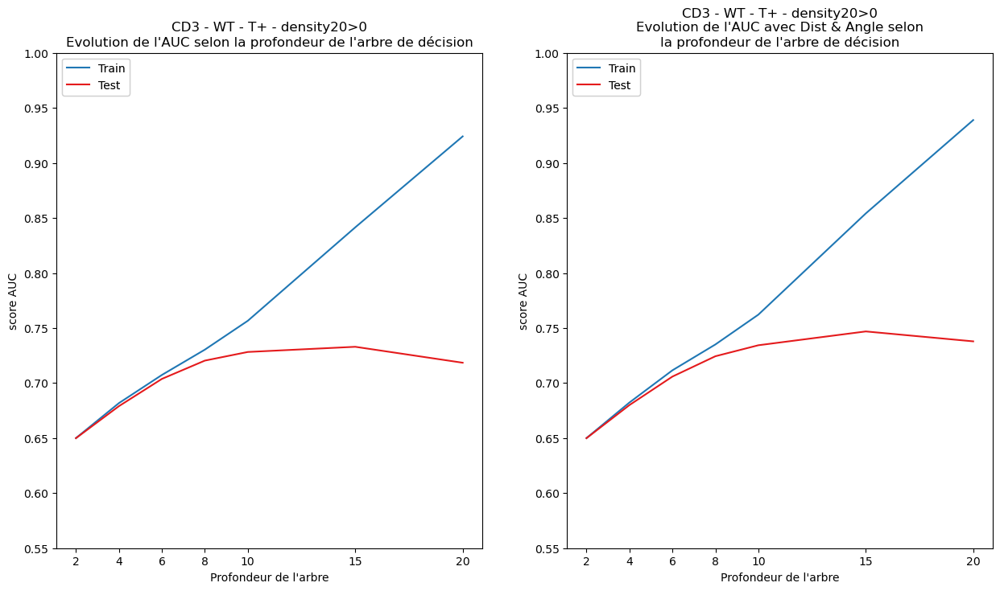

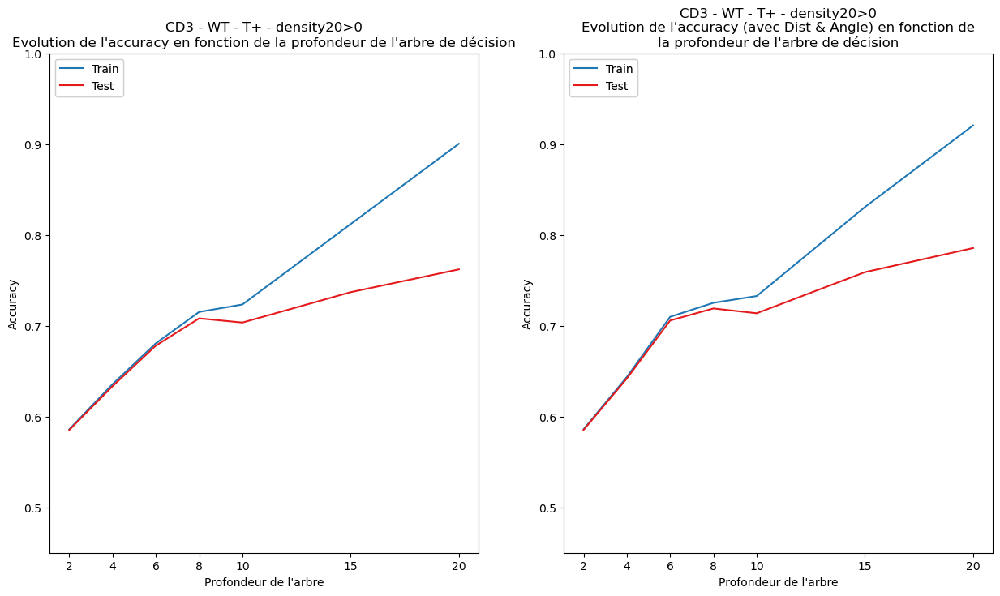

In [36]:
# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))
plots.plot(
    results_dens_t_plus["auc_train"],
    results_dens_t_plus["auc_test"],
    indices=results_dens_t_plus["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T+ - density20>0\n"
          "Evolution de l'AUC selon la profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=results_dens_t_plus["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=1, figure=(fig, ax1)
)

plots.plot(
    results_loc_dens_t_plus["auc_train"],
    results_loc_dens_t_plus["auc_test"],
    indices=results_loc_dens_t_plus["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T+ - density20>0\n"
          "Evolution de l'AUC avec Dist & Angle selon\n"
          "la profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=results_loc_dens_t_plus["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=1, figure=(fig, ax2),
)

# Saving plot
fig.savefig(f"{plus_perf_dirpath}{sess}_t-plus-density_auc-decisiontree")

# Showing plot
plt.show()

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_dens_t_plus["acc_train"],
    results_dens_t_plus["acc_test"],
    indices=results_dens_t_plus["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T+ - density20>0\n"
          "Evolution de l'accuracy en fonction de la "
          "profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=results_dens_t_plus["depths"], showR2=False, showY=False,
    ybottom=0.45, ytop=1, figure=(fig, ax1)
)

plots.plot(
    results_loc_dens_t_plus["acc_train"],
    results_loc_dens_t_plus["acc_test"],
    indices=results_loc_dens_t_plus["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T+ - density20>0\n"
          "Evolution de l'accuracy (avec Dist & Angle) en "
          "fonction de\nla profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=results_loc_dens_t_plus["depths"], showR2=False, showY=False,
    ybottom=0.45, ytop=1, figure=(fig, ax2),
)

# Saving plot
fig.savefig(f"{plus_perf_dirpath}{sess}_t-plus-density_accuracy-decisiontree")

# Showing plot
plt.show()

In [37]:
print("----- Résumé des performances en classe T plus - density, arbre de décision -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_dens_t_plus["depths"]] ; print("\n")

print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_plus["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_plus["auc_test"]] ; print("\n")
print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_plus["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_plus["acc_test"]] ; print("\n")
print(f"{'MCC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_plus["mcc_train"]] ; print()
print(f"{'MCC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_plus["mcc_test"]] ; print("\n")

print("--- with Dist & Angle")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_plus["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_plus["auc_test"]] ; print("\n")
print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_plus["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_plus["acc_test"]] ; print("\n")
print(f"{'MCC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_plus["mcc_train"]] ; print()
print(f"{'MCC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_plus["mcc_test"]] ; print()

----- Résumé des performances en classe T plus - density, arbre de décision -----
Profondeur          : 2     4     6     8     10    15    20    

AUC_train           : 0.65  0.68  0.71  0.73  0.76  0.84  0.92  
AUC_test            : 0.65  0.68  0.70  0.72  0.73  0.73  0.72  

Accuracy_train      : 0.59  0.64  0.68  0.72  0.72  0.81  0.90  
Accuracy_test       : 0.59  0.63  0.68  0.71  0.70  0.74  0.76  

MCC_train           : 0.25  0.30  0.34  0.39  0.43  0.58  0.76  
MCC_test            : 0.25  0.29  0.34  0.37  0.38  0.40  0.39  

--- with Dist & Angle
AUC_train_dist      : 0.65  0.68  0.71  0.74  0.76  0.85  0.94  
AUC_test_dist       : 0.65  0.68  0.71  0.72  0.73  0.75  0.74  

Accuracy_train_dist : 0.59  0.64  0.71  0.73  0.73  0.83  0.92  
Accuracy_test_dist  : 0.59  0.64  0.71  0.72  0.71  0.76  0.79  

MCC_train_dist      : 0.25  0.30  0.36  0.40  0.44  0.61  0.80  
MCC_test_dist       : 0.25  0.30  0.35  0.38  0.39  0.43  0.43  


In [38]:
# Decision Tree (CART)
dtree_dens_plus = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=10,
    random_state=seed,
    class_weight="balanced",
)

# Decision Tree (CART) with Dist column
dtree_loc_dens_plus = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=10,
    random_state=seed,
    class_weight="balanced",
)

In [39]:
# Fitting models to the data
dtree_dens_plus.fit(x_dens_train, y_dens_train)
dtree_loc_dens_plus.fit(x_loc_dens_train, y_loc_dens_train)

# Prediction on train and validation
y_dens_train_pred = dtree_dens_plus.predict(x_dens_train)
y_dens_test_pred = dtree_dens_plus.predict(x_dens_test)

y_loc_dens_train_pred = dtree_loc_dens_plus.predict(x_loc_dens_train)
y_loc_dens_test_pred = dtree_loc_dens_plus.predict(x_loc_dens_test)

# Labels
dtree_dens_plus.classes_ = \
dtree_loc_dens_plus.classes_ = \
labels_class_plus = pd.Series(dtree_dens_plus.classes_).map(
    {0: 'not_plus', 1: 'plus'}
).values

In [40]:
# Performance
fpr_dens_train, tpr_dens_train, _ = roc_curve(y_dens_train, y_dens_train_pred)
fpr_dens_test, tpr_dens_test, _ = roc_curve(y_dens_test, y_dens_test_pred)

fpr_loc_dens_train, tpr_loc_dens_train, _ = roc_curve(y_loc_dens_train, y_loc_dens_train_pred)
fpr_loc_dens_test, tpr_loc_dens_test, _ = roc_curve(y_loc_dens_test, y_loc_dens_test_pred)

# Model performances, how often is the classifier correct?
# train
acc_dens_train = accuracy_score(y_dens_train, y_dens_train_pred)
mcc_dens_train = matthews_corrcoef(y_dens_train, y_dens_train_pred)
auc_dens_train = auc(fpr_dens_train, tpr_dens_train)
# test
acc_dens_test = accuracy_score(y_dens_test, y_dens_test_pred)
mcc_dens_test = matthews_corrcoef(y_dens_test, y_dens_test_pred)
auc_dens_test = auc(fpr_dens_test, tpr_dens_test)

# with dist & angle
# train
acc_loc_dens_train = accuracy_score(y_loc_dens_train, y_loc_dens_train_pred)
mcc_loc_dens_train = matthews_corrcoef(y_loc_dens_train, y_loc_dens_train_pred)
auc_loc_dens_train = auc(fpr_loc_dens_train, tpr_loc_dens_train)
# test
acc_loc_dens_test = accuracy_score(y_loc_dens_test, y_loc_dens_test_pred)
mcc_loc_dens_test = matthews_corrcoef(y_loc_dens_test, y_loc_dens_test_pred)
auc_loc_dens_test = auc(fpr_loc_dens_test, tpr_loc_dens_test)

----- Arbre de décision - T+ - density20 > 0 -----
Train
Accuracy   = 0.714
AUC        = 0.754
MCC        = 0.422

Test
Accuracy   = 0.697
AUC        = 0.730
MCC        = 0.381


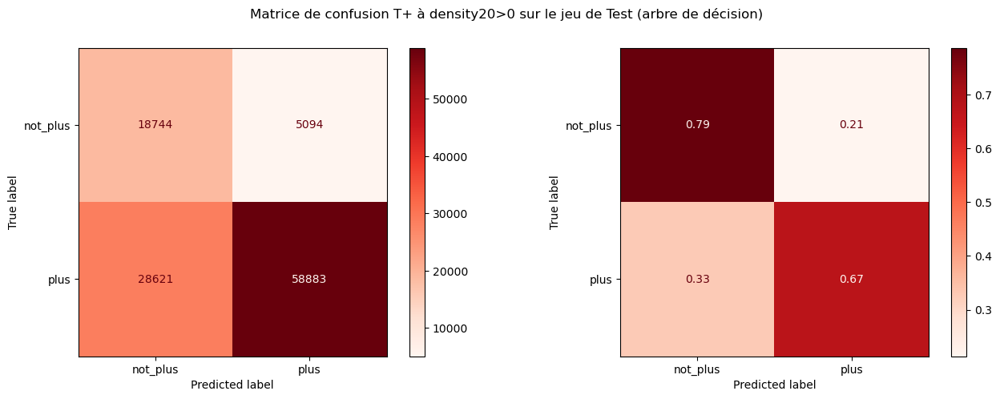

In [41]:
print("----- Arbre de décision - T+ - density20 > 0 -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_dens_train:2.3f}")
print(f"{'AUC':<10s} = {auc_dens_train:2.3f}")
print(f"{'MCC':<10s} = {mcc_dens_train:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_dens_test:2.3f}")
print(f"{'AUC':<10s} = {auc_dens_test:2.3f}")
print(f"{'MCC':<10s} = {mcc_dens_test:2.3f}")

# Confusion matrix
cmap_color = "Reds"
cmatrix = confusion_matrix(y_dens_test, y_dens_test_pred)
cmatrix_norm = confusion_matrix(y_dens_test, y_dens_test_pred, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T+ à density20>0 sur le jeu de Test (arbre de décision)")
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix,
    display_labels=labels_class_plus,
).plot(ax=ax1, cmap=cmap_color)

ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_norm,
    display_labels=labels_class_plus,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{plus_perf_dirpath}{sess}_t-plus-density_cmatrix-test")

# Show Figure
plt.show()

----- Arbre de décision - T+ - density20 > 0 (with Dist & Angle) -----
Train
Accuracy   = 0.737
AUC        = 0.755
MCC        = 0.430

Test
Accuracy   = 0.722
AUC        = 0.733
MCC        = 0.392


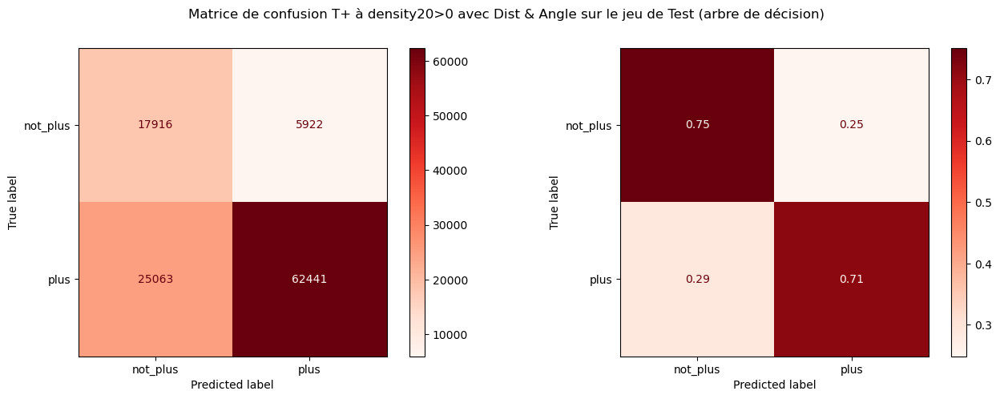

In [42]:
print("----- Arbre de décision - T+ - density20 > 0 (with Dist & Angle) -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_loc_dens_train:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_dens_train:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_dens_train:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_loc_dens_test:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_dens_test:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_dens_test:2.3f}")

# Confusion matrix
cmap_color = "Reds"
cmatrix_loc = confusion_matrix(y_loc_dens_test, y_loc_dens_test_pred)
cmatrix_loc_norm = confusion_matrix(y_loc_dens_test, y_loc_dens_test_pred, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T+ à density20>0 avec Dist & Angle sur le jeu de Test (arbre de décision)")
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc,
    display_labels=labels_class_plus,
).plot(ax=ax1, cmap=cmap_color)

ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc_norm,
    display_labels=labels_class_plus,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{plus_perf_dirpath}{sess}_t-plus-density_loc-cmatrix-test")

# Show Figure
plt.show()

In [43]:
# Decision tree text representation
dtree_dens_text = tree.export_text(
    dtree_dens_plus,
    feature_names=x_columns,
    #class_names=dtree_dens_plus.classes_,  # sklearn > 1.3.0
    max_depth=16
)

with open(f"{plus_tree_dirpath}{sess}_t-plus-density_text-dtree.txt", "w") as txt:
    txt.write(dtree_dens_text)

# Decision tree plot (too large)
dtree_dens_dot = tree.export_graphviz(
    dtree_dens_plus,
    feature_names=x_columns,
    class_names=dtree_dens_plus.classes_,
    filled=True
)
dtree_dens_dot = plots.node_color(dtree_dens_dot)

dtree_dens_graph = graphviz.Source(dtree_dens_dot, format="png")
dtree_dens_graph.render(f"{plus_tree_dirpath}{sess}_t-plus-density_dtree")
dtree_dens_graph

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.169179 to fit


In [44]:
# Decision tree text representation
dtree_loc_dens_text = tree.export_text(
    dtree_loc_dens_plus,
    feature_names=x_loc_columns,
    #class_names=dtree_loc_dens_plus.classes_,  # sklearn > 1.3.0
    max_depth=16
)

with open(f"{plus_tree_dirpath}{sess}_t-plus-density_loc-text-dtree.txt", "w") as txt:
    txt.write(dtree_loc_dens_text)

# Decision tree plot (too large)
dtree_loc_dens_dot = tree.export_graphviz(
    dtree_loc_dens_plus,
    feature_names=x_loc_columns,
    class_names=dtree_loc_dens_plus.classes_,
    filled=True
)
dtree_loc_dens_dot = plots.node_color(dtree_loc_dens_dot)

dtree_loc_dens_graph = graphviz.Source(dtree_loc_dens_dot, format="png")
dtree_loc_dens_graph.render(f"{plus_tree_dirpath}{sess}_t-plus-density_loc-dtree")
dtree_loc_dens_graph

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.175584 to fit


# Random Forest

In [45]:
depths_rf = [2, 6, 10, 20, 25]

# Results with best selected depth
results_dens_t_plus_rf = models.forest_depth_acc(
    x_dens_train, y_dens_train,
    x_dens_test, y_dens_test,
    depths=depths_rf, 
    classifier=RandomForestClassifier,
    n_estimators = 25,
    random_state=seed,
    class_weight="balanced",
    n_jobs=-1
)

# Results with best selected depth (with Dist & Angle)
results_loc_dens_t_plus_rf = models.forest_depth_acc(
    x_loc_dens_train, y_loc_dens_train,
    x_loc_dens_test, y_loc_dens_test,
    depths=depths_rf, 
    classifier=RandomForestClassifier,
    n_estimators = 25,
    random_state=seed,
    class_weight="balanced",
    n_jobs=-1
)

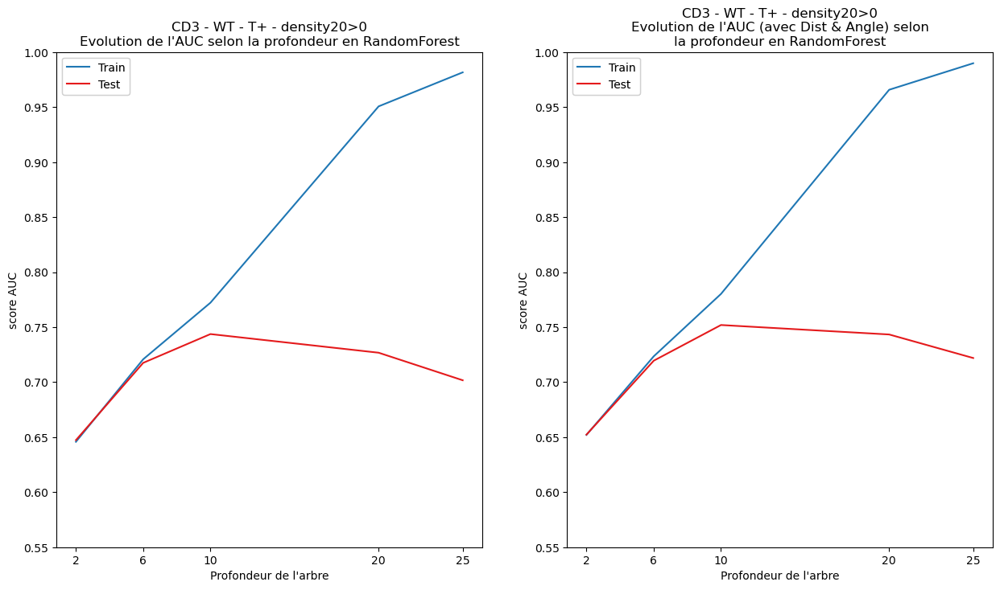

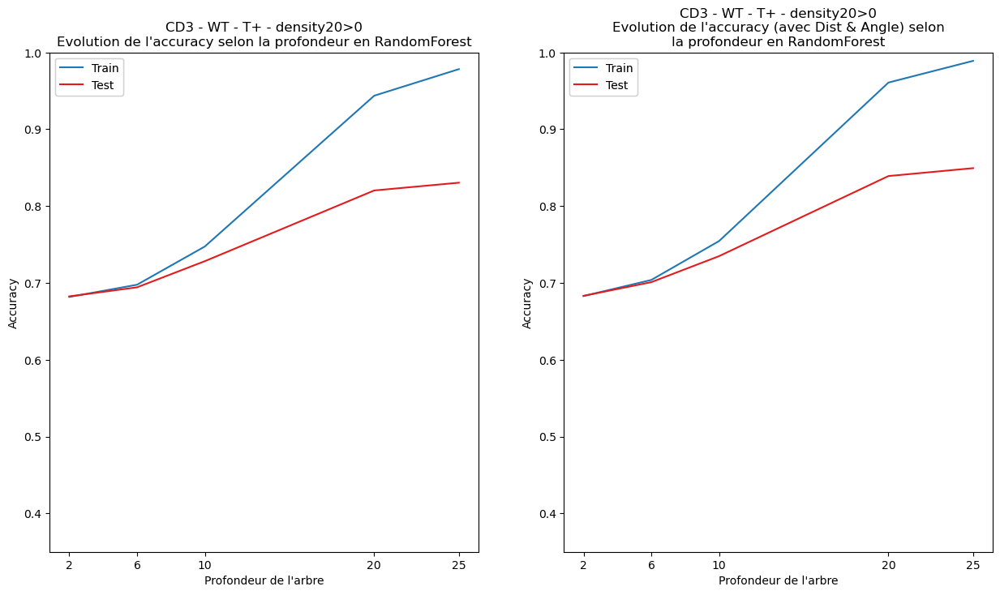

In [46]:
# Plot - auc
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_dens_t_plus_rf["auc_train"],
    results_dens_t_plus_rf["auc_test"],
    indices=results_dens_t_plus_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T+ - density20>0\n"
          "Evolution de l'AUC selon la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=results_dens_t_plus_rf["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=1, figure=(fig, ax1)
)

plots.plot(
    results_loc_dens_t_plus_rf["auc_train"],
    results_loc_dens_t_plus_rf["auc_test"],
    indices=results_loc_dens_t_plus_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T+ - density20>0\n"
          "Evolution de l'AUC (avec Dist & Angle) selon\n"
          "la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=results_loc_dens_t_plus_rf["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=1, figure=(fig, ax2)
)

# Saving plot
fig.savefig(f"{plus_perf_dirpath}{sess}_t-plus-density_auc-rforest")

# Showing plot
plt.show()

# Plot - accuracy
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_dens_t_plus_rf["acc_train"],
    results_dens_t_plus_rf["acc_test"],
    indices=results_dens_t_plus_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T+ - density20>0\n"
          "Evolution de l'accuracy selon la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=results_dens_t_plus_rf["depths"], showR2=False, showY=False,
    ybottom=0.35, ytop=1, figure=(fig, ax1)
)

plots.plot(
    results_loc_dens_t_plus_rf["acc_train"],
    results_loc_dens_t_plus_rf["acc_test"],
    indices=results_loc_dens_t_plus_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T+ - density20>0\n"
          "Evolution de l'accuracy (avec Dist & Angle) selon\n"
          "la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=results_loc_dens_t_plus_rf["depths"], showR2=False, showY=False,
    ybottom=0.35, ytop=1, figure=(fig, ax2)
)

# Saving plot
fig.savefig(f"{plus_perf_dirpath}{sess}_t-plus-density_accuracy-rforest")

# Showing plot
plt.show()

In [47]:
# print("----- Résumé des performances T plus - density20>0, arbre de décision -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_dens_t_plus_rf["depths"]] ; print("\n")
print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_plus_rf["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_plus_rf["auc_test"]] ; print("\n")

print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_plus_rf["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_plus_rf["acc_test"]] ; print("\n")

print("---")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_plus_rf["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_plus_rf["auc_test"]] ; print("\n")

print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_plus_rf["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_plus_rf["acc_test"]] ; print()

Profondeur          : 2     6     10    20    25    

AUC_train           : 0.65  0.72  0.77  0.95  0.98  
AUC_test            : 0.65  0.72  0.74  0.73  0.70  

Accuracy_train      : 0.68  0.70  0.75  0.94  0.98  
Accuracy_test       : 0.68  0.69  0.73  0.82  0.83  

---
AUC_train_dist      : 0.65  0.72  0.78  0.97  0.99  
AUC_test_dist       : 0.65  0.72  0.75  0.74  0.72  

Accuracy_train_dist : 0.68  0.70  0.75  0.96  0.99  
Accuracy_test_dist  : 0.68  0.70  0.73  0.84  0.85  


In [48]:
# Random search parameters
n_estimators_dens_plus = (10, 15, 20, 30)
n_depths_dens_plus = (2, 4, 8, 10, 15)

Best hyperparameters: {'n_estimators': 15, 'max_depth': 15}
Test Accuracy: 0.7833881194877046
Computing MDI importances
Elapsed time to compute mean decrease impurity (MDI) importance: 0.002 seconds

Computing permutation importances 
Elapsed time to compute permutation importance: 7.495 seconds



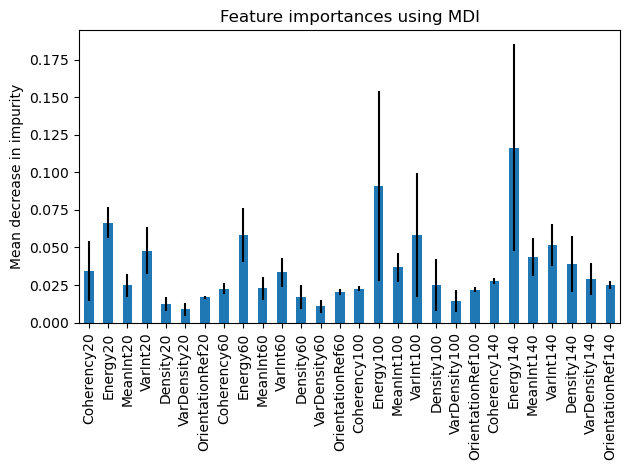

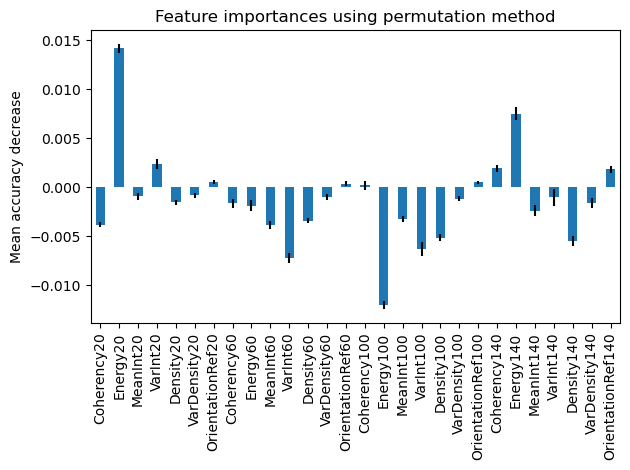

In [49]:
# Random forest (30, 20)
results_rf_dens_plus = models.perform_random_forest(
    x_train=x_dens_train,
    x_test=x_dens_test,
    y_train=y_dens_train,
    y_test=y_dens_test,
    columns=x_columns,
    n_estimators=n_estimators_dens_plus,
    n_depths=n_depths_dens_plus,
    class_weight="balanced",
    scale=False,
    seed=seed
)

# Save MDI importances
df_mdi_rf_dens_plus = pd.DataFrame(
    {
        "mean": results_rf_dens_plus["importance_mdi"]["mean"],
        "std": results_rf_dens_plus["importance_mdi"]["std"]
    }, index=x_columns
)

df_mdi_rf_dens_plus.to_csv(f"{plus_imp_dirpath}{sess}_t-plus-density_mdi_rforest.csv")  # save

# Save permutation importances
df_permutation_rf_dens_plus = pd.DataFrame(
    {
        "mean": results_rf_dens_plus["importance_permutation"]["mean"],
        "std": results_rf_dens_plus["importance_permutation"]["std"]
    }, index=x_columns
)

df_permutation_rf_dens_plus.to_csv(f"{plus_imp_dirpath}{sess}_t-plus-density_permu_rforest.csv")  # save

# Model with best parameters
rf_dens_plus = results_rf_dens_plus["model"]

Best hyperparameters: {'n_estimators': 15, 'max_depth': 15}
Test Accuracy: 0.799419805643872
Computing MDI importances
Elapsed time to compute mean decrease impurity (MDI) importance: 0.002 seconds

Computing permutation importances 
Elapsed time to compute permutation importance: 9.070 seconds



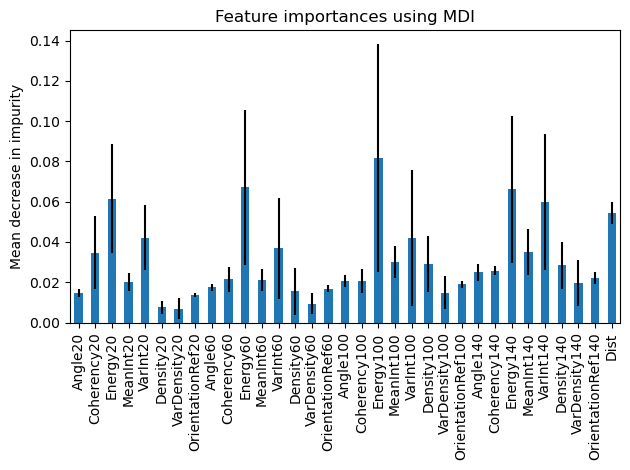

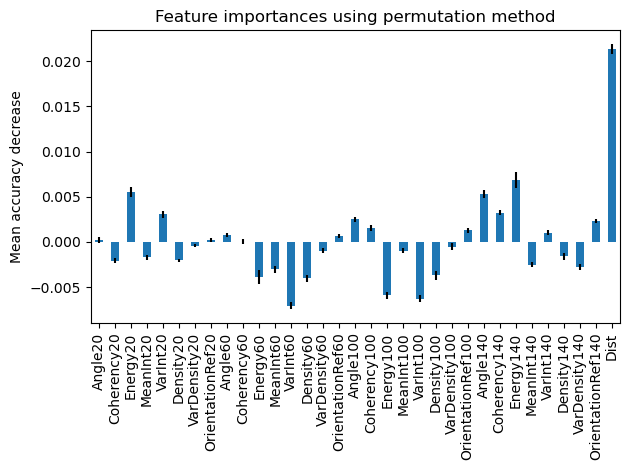

In [50]:
# Random forest with Dist & Angle
results_rf_loc_dens_plus = models.perform_random_forest(
    x_train=x_loc_dens_train,
    x_test=x_loc_dens_test,
    y_train=y_loc_dens_train,
    y_test=y_loc_dens_test,
    columns=x_loc_columns,
    n_estimators=n_estimators_dens_plus,
    n_depths=n_depths_dens_plus,
    class_weight="balanced",
    scale=False,
    seed=seed
)


# Save MDI importances
df_mdi_rf_loc_dens_plus = pd.DataFrame(
    {
        "mean": results_rf_loc_dens_plus["importance_mdi"]["mean"],
        "std": results_rf_loc_dens_plus["importance_mdi"]["std"]
    }, index=x_loc_columns
)

df_mdi_rf_loc_dens_plus.to_csv(f"{plus_imp_dirpath}{sess}_t-plus-density_loc-mdi_rforest.csv")  # save

# Save permutation importances
df_permutation_rf_loc_dens_plus = pd.DataFrame(
    {
        "mean": results_rf_loc_dens_plus["importance_permutation"]["mean"],
        "std": results_rf_loc_dens_plus["importance_permutation"]["std"]
    }, index=x_loc_columns
)

df_permutation_rf_loc_dens_plus.to_csv(f"{plus_imp_dirpath}{sess}_t-plus-density_loc-permu_rforest.csv")  # save

# Model with best parameters
rf_loc_dens_plus = results_rf_loc_dens_plus["model"]

In [51]:
# Prediction on train and validation
y_dens_train_pred_rf = rf_dens_plus.predict(x_dens_train)
y_dens_test_pred_rf = rf_dens_plus.predict(x_dens_test)

y_loc_dens_train_pred_rf = rf_loc_dens_plus.predict(x_loc_dens_train)
y_loc_dens_test_pred_rf = rf_loc_dens_plus.predict(x_loc_dens_test)

In [52]:
# Performance
fpr_dens_train_rf, tpr_dens_train_rf, _ = roc_curve(y_dens_train, y_dens_train_pred_rf)
fpr_dens_test_rf, tpr_dens_test_rf, _ = roc_curve(y_dens_test, y_dens_test_pred_rf)

fpr_loc_dens_train_rf, tpr_loc_dens_train_rf, _ = roc_curve(y_loc_dens_train, y_loc_dens_train_pred_rf)
fpr_loc_dens_test_rf, tpr_loc_dens_test_rf, _ = roc_curve(y_loc_dens_test, y_loc_dens_test_pred_rf)

# Model performances, how often is the classifier correct?
# train
acc_dens_train_rf = accuracy_score(y_dens_train, y_dens_train_pred_rf)
mcc_dens_train_rf = matthews_corrcoef(y_dens_train, y_dens_train_pred_rf)
auc_dens_train_rf = auc(fpr_dens_train_rf, tpr_dens_train_rf)
# test
acc_dens_test_rf = accuracy_score(y_dens_test, y_dens_test_pred_rf)
mcc_dens_test_rf = matthews_corrcoef(y_dens_test, y_dens_test_pred_rf)
auc_dens_test_rf = auc(fpr_dens_test_rf, tpr_dens_test_rf)

# with dist & angle
# train
acc_loc_dens_train_rf = accuracy_score(y_loc_dens_train, y_loc_dens_train_pred_rf)
mcc_loc_dens_train_rf = matthews_corrcoef(y_loc_dens_train, y_loc_dens_train_pred_rf)
auc_loc_dens_train_rf = auc(fpr_loc_dens_train_rf, tpr_loc_dens_train_rf)
# test
acc_loc_dens_test_rf = accuracy_score(y_loc_dens_test, y_loc_dens_test_pred_rf)
mcc_loc_dens_test_rf = matthews_corrcoef(y_loc_dens_test, y_loc_dens_test_pred_rf)
auc_loc_dens_test_rf = auc(fpr_loc_dens_test_rf, tpr_loc_dens_test_rf)

----- Random Forest T+ - density20>0 -----
Train
Accuracy   = 0.859
AUC        = 0.868
MCC        = 0.655

Test
Accuracy   = 0.783
AUC        = 0.747
MCC        = 0.444


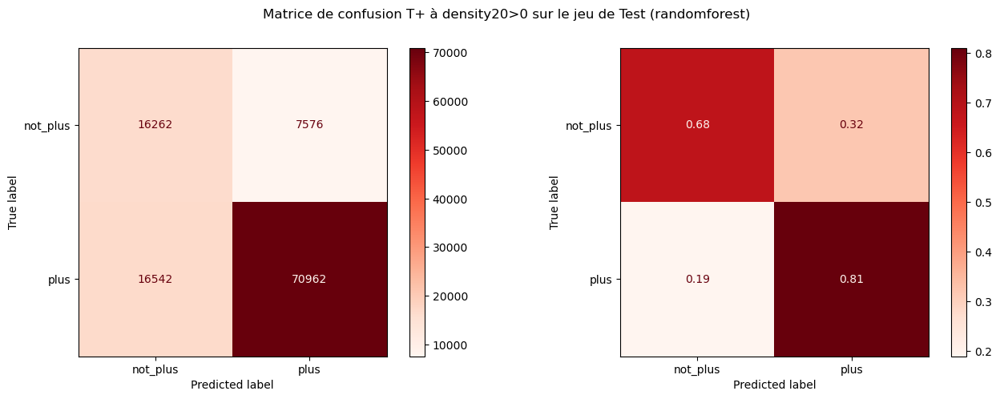

In [53]:
print("----- Random Forest T+ - density20>0 -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_dens_train_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_dens_train_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_dens_train_rf:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_dens_test_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_dens_test_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_dens_test_rf:2.3f}")


# Confusion matrix
cmap_color = "Reds"
cmatrix = confusion_matrix(y_dens_test, y_dens_test_pred_rf)
cmatrix_norm = confusion_matrix(y_dens_test, y_dens_test_pred_rf, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T+ à density20>0 sur le jeu de Test (randomforest)")
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix,
    display_labels=labels_class_plus,
).plot(ax=ax1, cmap=cmap_color)

ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_norm,
    display_labels=labels_class_plus,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{plus_perf_dirpath}{sess}_t-plus-density_cmatrix-rforest-test")

# Show Figure
plt.show()

----- Random Forest T+ (with Dist & Angle) - density20>0 -----
Train
Accuracy   = 0.875
AUC        = 0.883
MCC        = 0.688

Test
Accuracy   = 0.799
AUC        = 0.761
MCC        = 0.475


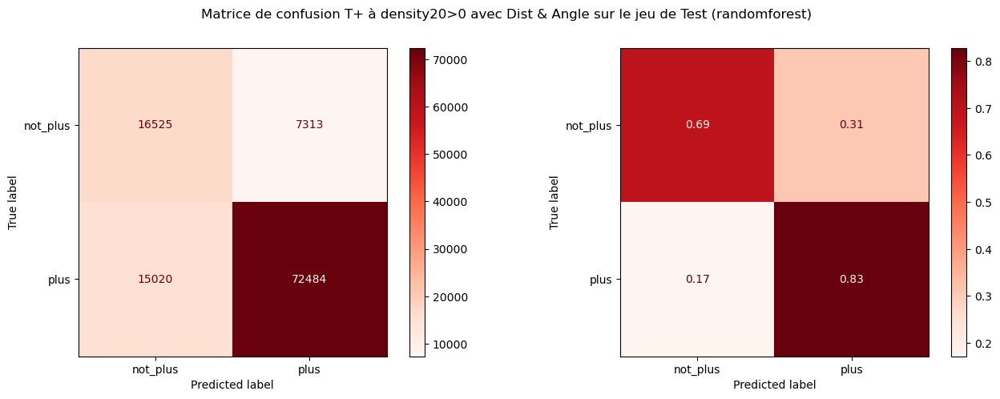

In [54]:
print("----- Random Forest T+ (with Dist & Angle) - density20>0 -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_loc_dens_train_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_dens_train_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_dens_train_rf:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_loc_dens_test_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_dens_test_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_dens_test_rf:2.3f}")


# Confusion matrix
cmap_color = "Reds"
cmatrix_loc = confusion_matrix(y_loc_dens_test, y_loc_dens_test_pred_rf)
cmatrix_loc_norm = confusion_matrix(y_loc_dens_test, y_loc_dens_test_pred_rf, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T+ à density20>0 avec Dist & Angle sur le jeu de Test (randomforest)")
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc,
    display_labels=labels_class_plus,
).plot(ax=ax1, cmap=cmap_color)

ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc_norm,
    display_labels=labels_class_plus,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{plus_perf_dirpath}{sess}_t-plus-density_loc-cmatrix-rforest-test")

# Show Figure
plt.show()

# T enrichie

Prédiction de fenêtres de classe **enriched**

In [55]:
# Respective directory for the designed class
enrich_perf_dirpath = auxiliary.create_dir(f"{sess_perf_dirpath}{'enriched'}")
enrich_tree_dirpath = auxiliary.create_dir(f"{sess_tree_dirpath}{'enriched'}")
enrich_imp_dirpath = auxiliary.create_dir(f"{sess_imp_dirpath}{'enriched'}")

### Jeu de données d'apprentissage et de validation (avec valeurs abérrantes)

In [56]:
# Target column
y_column = "class_t_enriched"

# Define x and y dataframe
xy = data[x_loc_columns + [y_column]].dropna()

# features
x = xy[x_columns].values
x_loc = xy[x_loc_columns].values  # with distance/angle

# target value
y = xy[y_column].values

## Train and Validation
x_train, x_test, y_train, y_test = train_test_split(
    x, y, test_size=0.3, random_state=seed, stratify=y
)

# With (Angle & Dist)
x_loc_train, x_loc_test, y_loc_train, y_loc_test = train_test_split(
    x_loc, y, test_size=0.3, random_state=seed, stratify=y
)

In [57]:
print(f"----- T enrichie -----")
print(f"\n{'Comptage des classes :':<30s}{'0':<6s}{'':2s}{'1':>6s}")
print(f"{'y:':30s}{sum(y == 0):>6d}{'':2s}{sum(y == 1):>6d}")
print(f"{'y_train:':30s}{sum(y_train == 0):>6d}{'':2s}{sum(y_train == 1):>6d}")
print(f"{'y_test:':30s}{sum(y_test == 0):>6d}{'':2s}{sum(y_test == 1):>6d}")
print(f"\nNombre d'observations totales : {y.shape[0]:_}")

----- T enrichie -----

Comptage des classes :        0            1
y:                            607467  163299
y_train:                      425227  114309
y_test:                       182240   48990

Nombre d'observations totales : 770_766


#### Arbre de décision

In [58]:
depths_dtree = [2, 4, 6, 8, 10, 15, 20]

# Results with best selected depth
results_t_enrich = models.forest_depth_acc(
    x_train, y_train, x_test, y_test,
    depths=depths_dtree, 
    classifier=DecisionTreeClassifier,
    random_state=seed,
    class_weight="balanced"
)

# Best number of depth with Dist & Angle
results_loc_t_enrich = models.forest_depth_acc(
    x_loc_train, y_loc_train, x_loc_test, y_loc_test,
    depths=depths_dtree, 
    classifier=DecisionTreeClassifier,
    random_state=seed,
    class_weight="balanced"
)

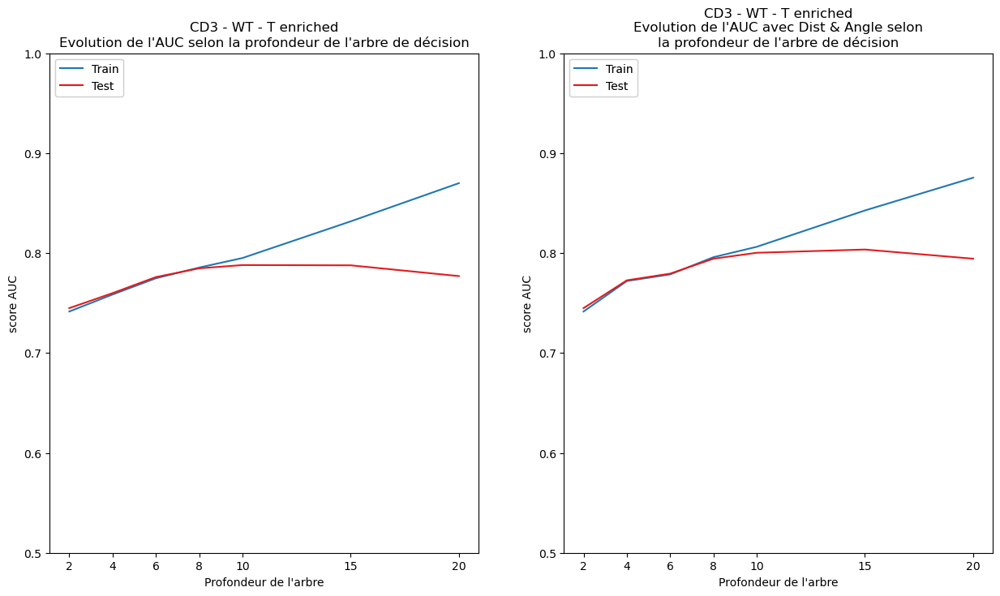

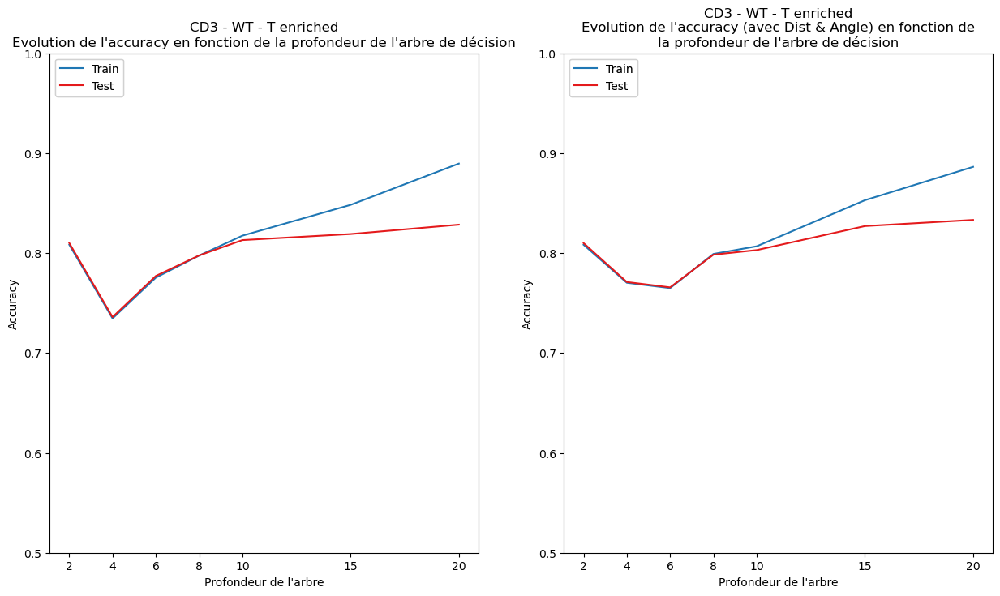

In [59]:
# Plot - AUC
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))
plots.plot(
    results_t_enrich["auc_train"],
    results_t_enrich["auc_test"],
    indices=results_t_enrich["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T enriched\n"
          "Evolution de l'AUC selon la profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=depths_dtree, showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax1)
)

plots.plot(
    results_loc_t_enrich["auc_train"],
    results_loc_t_enrich["auc_test"],
    indices=results_loc_t_enrich["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T enriched\n"
          "Evolution de l'AUC avec Dist & Angle selon\n"
          "la profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=depths_dtree, showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax2),
)

# Saving plot
fig.savefig(f"{enrich_perf_dirpath}{sess}_t-enriched_auc-decisiontree")

# Showing plot
plt.show()

# Plot - Accuracy
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_t_enrich["acc_train"],
    results_t_enrich["acc_test"],
    indices=results_t_enrich["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T enriched\n"
          "Evolution de l'accuracy en fonction de la "
          "profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=depths_dtree, showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax1)
)

plots.plot(
    results_loc_t_enrich["acc_train"],
    results_loc_t_enrich["acc_test"],
    indices=results_loc_t_enrich["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T enriched\n"
          "Evolution de l'accuracy (avec Dist & Angle) en "
          "fonction de\nla profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=depths_dtree, showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax2),
)

# Saving plot
fig.savefig(f"{enrich_perf_dirpath}{sess}_t-enriched_accuracy-decisiontree")

# Showing plot
plt.show()

In [60]:
print("----- Résumé des performances en classe T enrichie, arbre de décision -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_t_enrich["depths"]] ; print("\n")

print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich["auc_test"]] ; print("\n")
print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich["acc_test"]] ; print("\n")
print(f"{'MCC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich["mcc_train"]] ; print()
print(f"{'MCC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich["mcc_test"]] ; print("\n")

print("--- with Dist & Angle")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich["auc_test"]] ; print("\n")
print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich["acc_test"]] ; print("\n")
print(f"{'MCC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich["mcc_train"]] ; print()
print(f"{'MCC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich["mcc_test"]] ; print()

----- Résumé des performances en classe T enrichie, arbre de décision -----
Profondeur          : 2     4     6     8     10    15    20    

AUC_train           : 0.74  0.76  0.77  0.79  0.80  0.83  0.87  
AUC_test            : 0.74  0.76  0.78  0.78  0.79  0.79  0.78  

Accuracy_train      : 0.81  0.73  0.78  0.80  0.82  0.85  0.89  
Accuracy_test       : 0.81  0.74  0.78  0.80  0.81  0.82  0.83  

MCC_train           : 0.46  0.43  0.47  0.50  0.53  0.60  0.70  
MCC_test            : 0.46  0.44  0.48  0.50  0.52  0.52  0.52  

--- with Dist & Angle
AUC_train_dist      : 0.74  0.77  0.78  0.80  0.81  0.84  0.88  
AUC_test_dist       : 0.74  0.77  0.78  0.79  0.80  0.80  0.79  

Accuracy_train_dist : 0.81  0.77  0.76  0.80  0.81  0.85  0.89  
Accuracy_test_dist  : 0.81  0.77  0.77  0.80  0.80  0.83  0.83  

MCC_train_dist      : 0.46  0.47  0.47  0.52  0.54  0.62  0.70  
MCC_test_dist       : 0.46  0.47  0.47  0.51  0.53  0.55  0.55  


In [61]:
# Decision Tree (CART)
dtree_enriched = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=12,
    random_state=seed,
    class_weight="balanced"
)

# Decision Tree (CART) with Dist column
dtree_loc_enriched = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=12,
    random_state=seed,
    class_weight="balanced"
)

In [62]:
# Fitting models on data
dtree_enriched.fit(x_train, y_train)
dtree_loc_enriched.fit(x_loc_train, y_loc_train)

# Prediction on train and validation
y_train_pred = dtree_enriched.predict(x_train)
y_test_pred = dtree_enriched.predict(x_test)

y_loc_train_pred = dtree_loc_enriched.predict(x_loc_train)
y_loc_test_pred = dtree_loc_enriched.predict(x_loc_test)

# Labels (for re-assignment)
dtree_enriched.classes_ = \
dtree_loc_enriched.classes_ = \
labels_class_enrich = pd.Series(dtree_enriched.classes_).map(
    {0: 'not_enriched', 1: 'enriched'}
).values

In [63]:
# ROC values - false positive rate (fpr), and true positive rate (tpr)
fpr_train, tpr_train, _ = roc_curve(y_train, y_train_pred)
fpr_test, tpr_test, _ = roc_curve(y_test, y_test_pred)

fpr_loc_train, tpr_loc_train, _ = roc_curve(y_loc_train, y_loc_train_pred)
fpr_loc_test, tpr_loc_test, _ = roc_curve(y_loc_test, y_loc_test_pred)

# Model performances, how often is the classifier correct?
# train
acc_train = accuracy_score(y_train, y_train_pred)
mcc_train = matthews_corrcoef(y_train, y_train_pred)
auc_train = auc(fpr_train, tpr_train)
# test
acc_test = accuracy_score(y_test, y_test_pred)
mcc_test = matthews_corrcoef(y_test, y_test_pred)
auc_test = auc(fpr_test, tpr_test)

# with dist & angle
# train
acc_loc_train = accuracy_score(y_loc_train, y_loc_train_pred)
mcc_loc_train = matthews_corrcoef(y_loc_train, y_loc_train_pred)
auc_loc_train = auc(fpr_loc_train, tpr_loc_train)
# test
acc_loc_test = accuracy_score(y_loc_test, y_loc_test_pred)
mcc_loc_test = matthews_corrcoef(y_loc_test, y_loc_test_pred)
auc_loc_test = auc(fpr_loc_test, tpr_loc_test)

----- Arbre de décision T enrichie -----
Train
Accuracy   = 0.820
AUC        = 0.805
MCC        = 0.545

Test
Accuracy   = 0.811
AUC        = 0.790
MCC        = 0.520


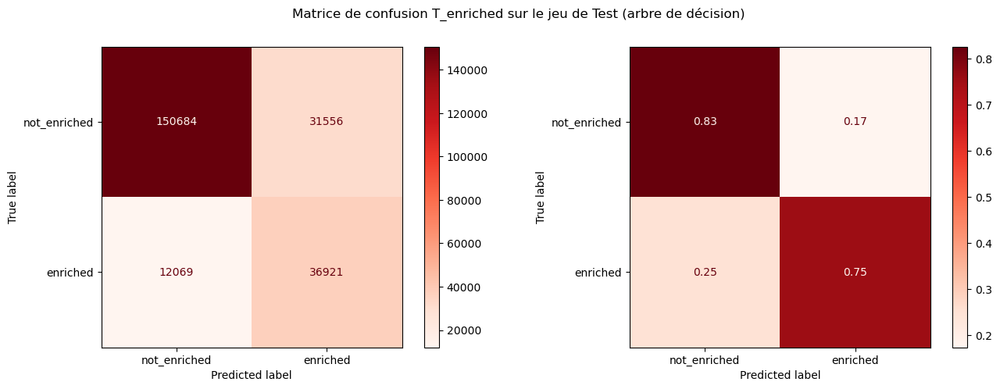

In [64]:
print("----- Arbre de décision T enrichie -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_train:2.3f}")
print(f"{'AUC':<10s} = {auc_train:2.3f}")
print(f"{'MCC':<10s} = {mcc_train:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_test:2.3f}")
print(f"{'AUC':<10s} = {auc_test:2.3f}")
print(f"{'MCC':<10s} = {mcc_test:2.3f}")

# Confusion matrix
cmap_color = "Reds"
cmatrix = confusion_matrix(y_test, y_test_pred)
cmatrix_norm = confusion_matrix(y_test, y_test_pred, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T_enriched sur le jeu de Test (arbre de décision)")
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix,
    display_labels=labels_class_enrich,
).plot(ax=ax1, cmap=cmap_color)

ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_norm,
    display_labels=labels_class_enrich,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{enrich_perf_dirpath}{sess}_t-enriched_cmatrix-dtree-test")

# Show Figure
plt.show()

----- Arbre de décision T enrichie (with Dist & Angle) -----
Train
Accuracy   = 0.820
AUC        = 0.818
MCC        = 0.560

Test
Accuracy   = 0.812
AUC        = 0.805
MCC        = 0.537


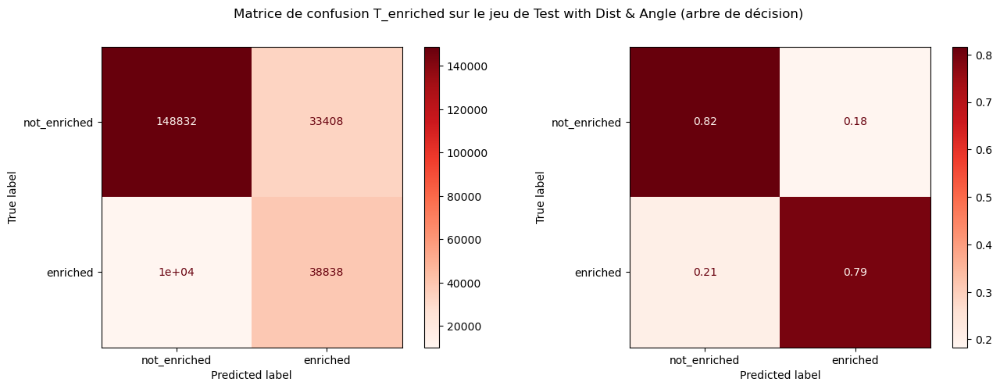

In [65]:
print("----- Arbre de décision T enrichie (with Dist & Angle) -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_loc_train:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_train:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_train:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_loc_test:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_test:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_test:2.3f}")

# Confusion matrix
cmap_color = "Reds"
cmatrix_loc = confusion_matrix(y_loc_test, y_loc_test_pred)
cmatrix_loc_norm = confusion_matrix(y_loc_test, y_loc_test_pred, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T_enriched sur le jeu de Test with Dist & Angle (arbre de décision)")

# Confusion Matrix displaying count
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc,
    display_labels=labels_class_enrich,
).plot(ax=ax1, cmap=cmap_color)

# Confusion Matrix displaying ratio on true label
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc_norm,
    display_labels=labels_class_enrich,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{enrich_perf_dirpath}{sess}_t-enriched_loc-cmatrix-dtree-test")

# Show Figure
plt.show()

In [66]:
# Decision tree text representation
dtree_text = tree.export_text(
    dtree_enriched,
    feature_names=x_columns,
    #class_names=dtree_enriched.classes_,  # sklearn > 1.3.0
    max_depth=16
)

with open(f"{enrich_tree_dirpath}{sess}_t-enriched_text-dtree.txt", "w") as txt:
    txt.write(dtree_text)

# Decision tree plot (too large)
dtree_dot = tree.export_graphviz(
    dtree_enriched,
    feature_names=x_columns,
    class_names=dtree_enriched.classes_,
    filled=True
)
dtree_dot = plots.node_color(dtree_dot)

dtree_graph = graphviz.Source(dtree_dot, format="png")
dtree_graph.render(f"{enrich_tree_dirpath}{sess}_t-enriched_dtree")
dtree_graph

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.079125 to fit


In [67]:
# Decision tree text representation
dtree_loc_text = tree.export_text(
    dtree_loc_enriched,
    feature_names=x_loc_columns,
    #class_names=dtree_loc_enriched.classes_,  # sklearn > 1.3.0
    max_depth=16
)

with open(f"{enrich_tree_dirpath}{sess}_t-enriched_loc-text-dtree.txt", "w") as txt:
    txt.write(dtree_loc_text)

# Decision tree plot (too large)
dtree_loc_dot = tree.export_graphviz(
    dtree_loc_enriched,
    feature_names=x_loc_columns,
    class_names=dtree_loc_enriched.classes_,
    filled=True
)
dtree_loc_dot = plots.node_color(dtree_loc_dot)

dtree_loc_graph = graphviz.Source(dtree_loc_dot, format="png")
dtree_loc_graph.render(f"{enrich_tree_dirpath}{sess}_t-enriched_loc-dtree")
dtree_loc_graph

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.0785698 to fit


# Random Forest


In [68]:
depths_rf = [2, 4, 6, 8, 10, 15, 20]

# Results with best selected depth
results_t_enrich_rf = models.forest_depth_acc(
    x_train, y_train, x_test, y_test,
    depths=depths_rf, 
    classifier=RandomForestClassifier,
    n_estimators = 100,
    random_state=seed,
    class_weight="balanced",
    n_jobs=-1
)

# Results with best selected depth (with Dist & Angle)
results_loc_t_enrich_rf = models.forest_depth_acc(
    x_loc_train, y_loc_train, x_loc_test, y_loc_test,
    depths=depths_rf, 
    classifier=RandomForestClassifier,
    n_estimators = 100,
    random_state=seed,
    class_weight="balanced",
    n_jobs=-1
)

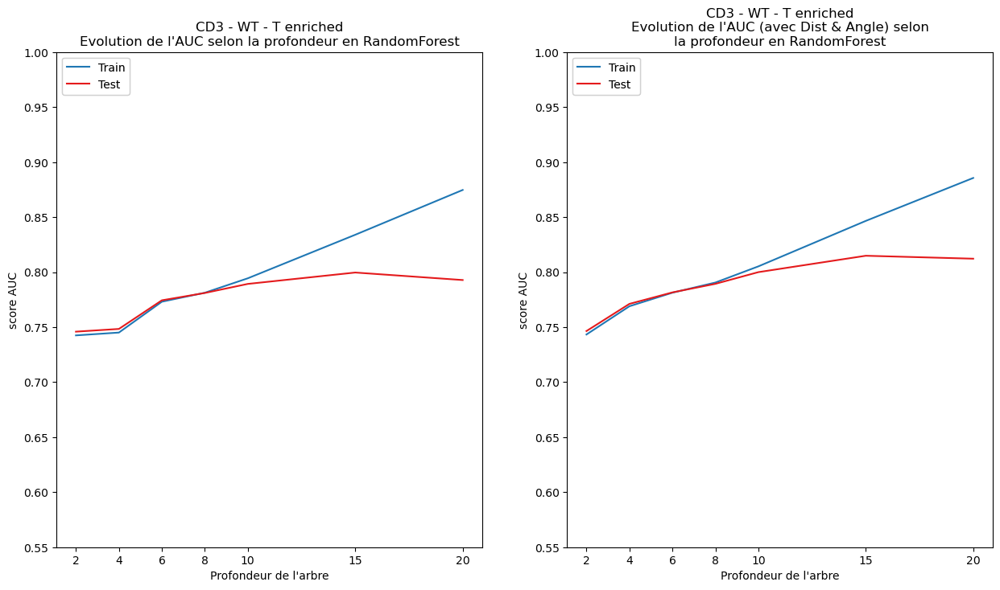

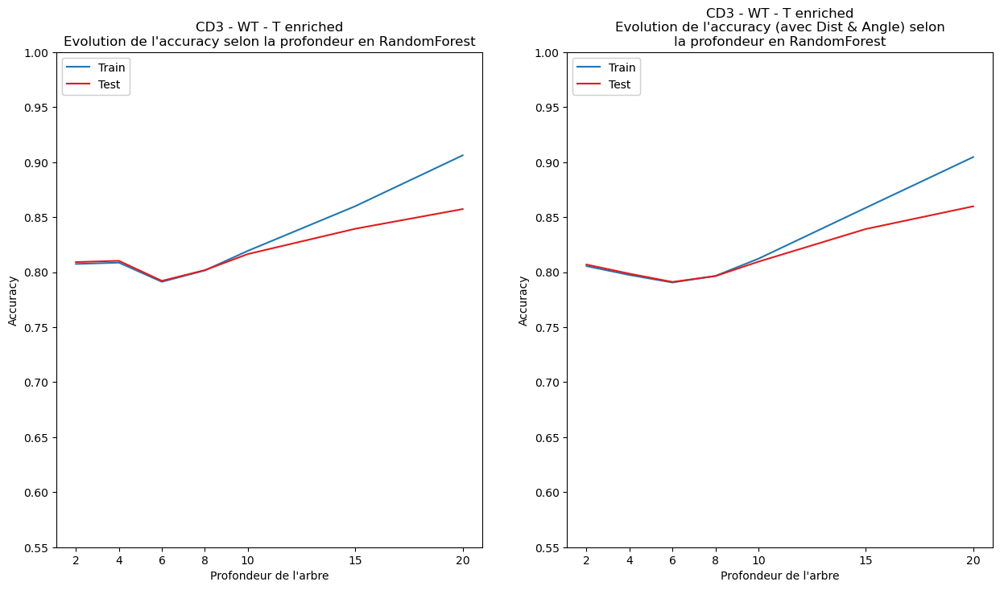

In [69]:
# Plot - auc
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_t_enrich_rf["auc_train"],
    results_t_enrich_rf["auc_test"],
    indices=results_t_enrich_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T enriched\n"
          "Evolution de l'AUC selon la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=results_t_enrich_rf["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=1, figure=(fig, ax1)
)

plots.plot(
    results_loc_t_enrich_rf["auc_train"],
    results_loc_t_enrich_rf["auc_test"],
    indices=results_loc_t_enrich_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T enriched\n"
          "Evolution de l'AUC (avec Dist & Angle) selon\n"
          "la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=results_loc_t_enrich_rf["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=1, figure=(fig, ax2)
)

# Saving plot
fig.savefig(f"{enrich_perf_dirpath}{sess}_t-enriched_auc-rforest")

# Showing plot
plt.show()

# Plot - accuracy
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_t_enrich_rf["acc_train"],
    results_t_enrich_rf["acc_test"],
    indices=results_t_enrich_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T enriched\n"
          "Evolution de l'accuracy selon la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=results_t_enrich_rf["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=1, figure=(fig, ax1)
)

plots.plot(
    results_loc_t_enrich_rf["acc_train"],
    results_loc_t_enrich_rf["acc_test"],
    indices=results_loc_t_enrich_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T enriched\n"
          "Evolution de l'accuracy (avec Dist & Angle) selon\n"
          "la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=results_loc_t_enrich_rf["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=1, figure=(fig, ax2)
)

# Saving plot
fig.savefig(f"{enrich_perf_dirpath}{sess}_t-enriched_accuracy-rforest")

# Showing plot
plt.show()

In [70]:
print("----- Résumé des performances en classe T enrichie, random forest -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_t_enrich_rf["depths"]] ; print("\n")

print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich_rf["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich_rf["auc_test"]] ; print("\n")
print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich_rf["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich_rf["acc_test"]] ; print("\n")
print(f"{'MCC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich_rf["mcc_train"]] ; print()
print(f"{'MCC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich_rf["mcc_test"]] ; print("\n")

print("--- with Dist & Angle")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich_rf["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich_rf["auc_test"]] ; print("\n")
print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich_rf["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich_rf["acc_test"]] ; print("\n")
print(f"{'MCC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich_rf["mcc_train"]] ; print()
print(f"{'MCC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich_rf["mcc_test"]] ; print()

----- Résumé des performances en classe T enrichie, random forest -----
Profondeur          : 2     4     6     8     10    15    20    

AUC_train           : 0.74  0.75  0.77  0.78  0.79  0.83  0.87  
AUC_test            : 0.75  0.75  0.77  0.78  0.79  0.80  0.79  

Accuracy_train      : 0.81  0.81  0.79  0.80  0.82  0.86  0.91  
Accuracy_test       : 0.81  0.81  0.79  0.80  0.82  0.84  0.86  

MCC_train           : 0.46  0.46  0.48  0.50  0.53  0.62  0.73  
MCC_test            : 0.46  0.47  0.48  0.50  0.52  0.56  0.58  

--- with Dist & Angle
AUC_train_dist      : 0.74  0.77  0.78  0.79  0.81  0.85  0.89  
AUC_test_dist       : 0.75  0.77  0.78  0.79  0.80  0.81  0.81  

Accuracy_train_dist : 0.81  0.80  0.79  0.80  0.81  0.86  0.90  
Accuracy_test_dist  : 0.81  0.80  0.79  0.80  0.81  0.84  0.86  

MCC_train_dist      : 0.46  0.48  0.49  0.51  0.54  0.63  0.73  
MCC_test_dist       : 0.46  0.49  0.49  0.51  0.53  0.58  0.60  


In [71]:
# Random search parameters
n_estimators_enrich = (10, 15, 20, 30)
n_depths_enrich = (2, 4, 8, 10, 15, 18)

Best hyperparameters: {'n_estimators': 20, 'max_depth': 15}
Test Accuracy: 0.8390650002162349
Computing MDI importances
Elapsed time to compute mean decrease impurity (MDI) importance: 0.003 seconds

Computing permutation importances 
Elapsed time to compute permutation importance: 19.846 seconds



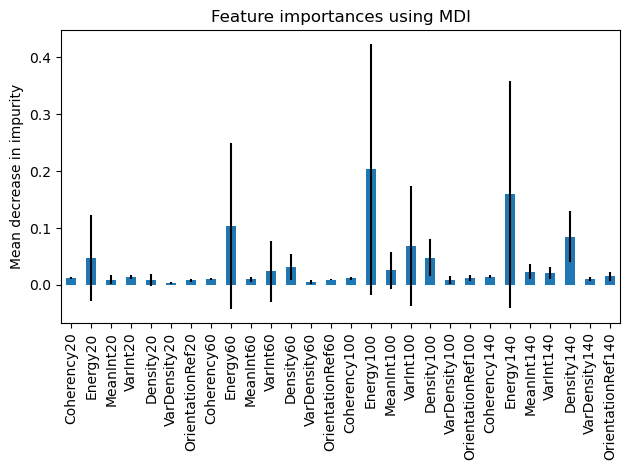

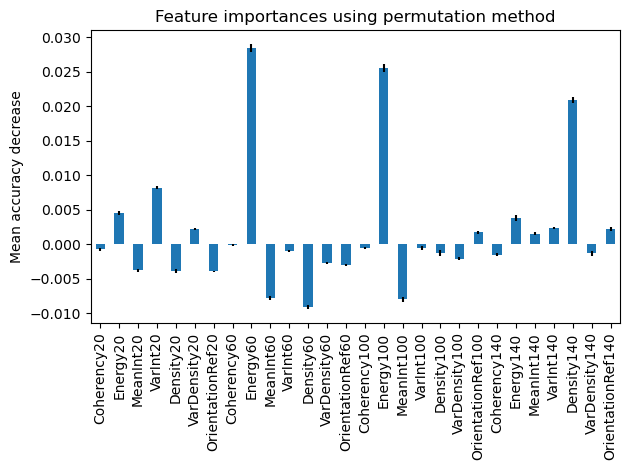

In [72]:
# RandomForest model
results_rf_enrich = models.perform_random_forest(
    x_train=x_train,
    x_test=x_test,
    y_train=y_train,
    y_test=y_test,
    columns=x_columns,
    n_estimators=n_estimators_enrich,
    n_depths=n_depths_enrich,
    class_weight="balanced",
    scale=False,
    seed=seed
)

# Save MDI importances
df_mdi_rf_enrich = pd.DataFrame(
    {
        "mean": results_rf_enrich["importance_mdi"]["mean"],
        "std": results_rf_enrich["importance_mdi"]["std"]
    }, index=x_columns
)

df_mdi_rf_enrich.to_csv(f"{enrich_imp_dirpath}{sess}_t-enriched_mdi_rforest.csv")  # save

# Save permutation importances
df_permutation_rf_enrich = pd.DataFrame(
    {
        "mean": results_rf_enrich["importance_permutation"]["mean"],
        "std": results_rf_enrich["importance_permutation"]["std"]
    }, index=x_columns
)

df_permutation_rf_enrich.to_csv(f"{enrich_imp_dirpath}{sess}_t-enriched_permu_rforest.csv")  # save

# Model with best parameters
rf_enrich = results_rf_enrich["model"]

Best hyperparameters: {'n_estimators': 20, 'max_depth': 15}
Test Accuracy: 0.8385200882238464
Computing MDI importances
Elapsed time to compute mean decrease impurity (MDI) importance: 0.004 seconds

Computing permutation importances 
Elapsed time to compute permutation importance: 21.687 seconds



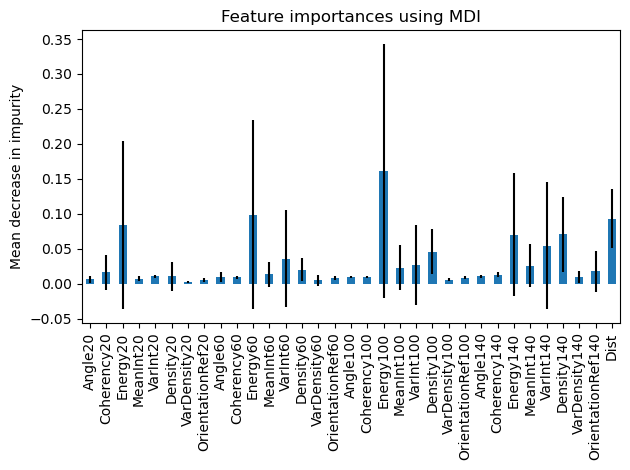

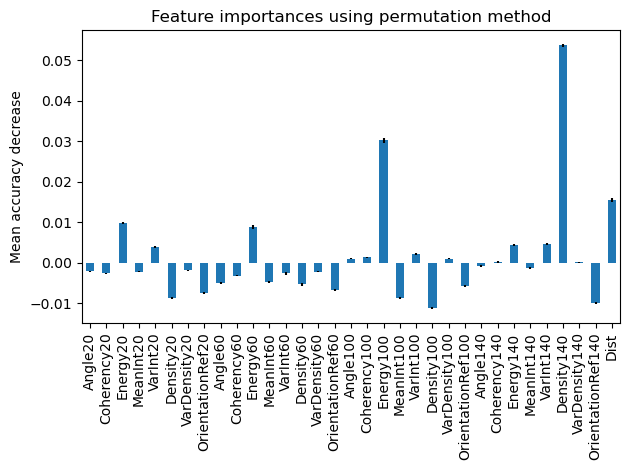

In [73]:
# RandomForest model with Dist & Angle columns
results_rf_loc_enrich = models.perform_random_forest(
    x_train=x_loc_train,
    x_test=x_loc_test,
    y_train=y_loc_train,
    y_test=y_loc_test,
    columns=x_loc_columns,
    n_estimators=n_estimators_enrich,
    n_depths=n_depths_enrich,
    class_weight="balanced",
    scale=False,
    seed=seed
)

# Save MDI importances
df_mdi_rf_loc_enrich = pd.DataFrame(
    {
        "mean": results_rf_loc_enrich["importance_mdi"]["mean"],
        "std": results_rf_loc_enrich["importance_mdi"]["std"]
    }, index=x_loc_columns
)

df_mdi_rf_loc_enrich.to_csv(f"{enrich_imp_dirpath}{sess}_t-enriched_loc-mdi_rforest.csv")  # save

# Save permutation importances
df_permutation_rf_loc_plus = pd.DataFrame(
    {
        "mean": results_rf_loc_enrich["importance_permutation"]["mean"],
        "std": results_rf_loc_enrich["importance_permutation"]["std"]
    }, index=x_loc_columns
)

df_permutation_rf_loc_plus.to_csv(f"{enrich_imp_dirpath}{sess}_t-enriched_loc-permu_rforest.csv")

# Model with best parameters
rf_loc_enrich = results_rf_loc_enrich["model"]

In [74]:
# Prediction on train and validation
y_train_pred_rf = rf_enrich.predict(x_train)
y_test_pred_rf = rf_enrich.predict(x_test)

y_loc_train_pred_rf = rf_loc_enrich.predict(x_loc_train)
y_loc_test_pred_rf = rf_loc_enrich.predict(x_loc_test)

# Labels
labels_class_enrich

array(['not_enriched', 'enriched'], dtype=object)

In [75]:
# ROC values - false positive rate (fpr), and true positive rate (tpr)
fpr_train_rf, tpr_train_rf, _ = roc_curve(y_train, y_train_pred_rf)
fpr_test_rf, tpr_test_rf, _ = roc_curve(y_test, y_test_pred_rf)

fpr_loc_train_rf, tpr_loc_train_rf, _ = roc_curve(y_loc_train, y_loc_train_pred_rf)
fpr_loc_test_rf, tpr_loc_test_rf, _ = roc_curve(y_loc_test, y_loc_test_pred_rf)

# Model performances, how often is the classifier correct?
# train
acc_train_rf = accuracy_score(y_train, y_train_pred_rf)
mcc_train_rf = matthews_corrcoef(y_train, y_train_pred_rf)
auc_train_rf = auc(fpr_train_rf, tpr_train_rf)
# test
acc_test_rf = accuracy_score(y_test, y_test_pred_rf)
mcc_test_rf = matthews_corrcoef(y_test, y_test_pred_rf)
auc_test_rf = auc(fpr_test_rf, tpr_test_rf)

# with dist & angle
# train
acc_loc_train_rf = accuracy_score(y_loc_train, y_loc_train_pred_rf)
mcc_loc_train_rf = matthews_corrcoef(y_loc_train, y_loc_train_pred_rf)
auc_loc_train_rf = auc(fpr_loc_train_rf, tpr_loc_train_rf)
# test
acc_loc_test_rf = accuracy_score(y_loc_test, y_loc_test_pred_rf)
mcc_loc_test_rf = matthews_corrcoef(y_loc_test, y_loc_test_pred_rf)
auc_loc_test_rf = auc(fpr_loc_test_rf, tpr_loc_test_rf)

----- Random Forest T_enriched -----
Train
Accuracy   = 0.860
AUC        = 0.833
MCC        = 0.619

Test
Accuracy   = 0.839
AUC        = 0.799
MCC        = 0.558


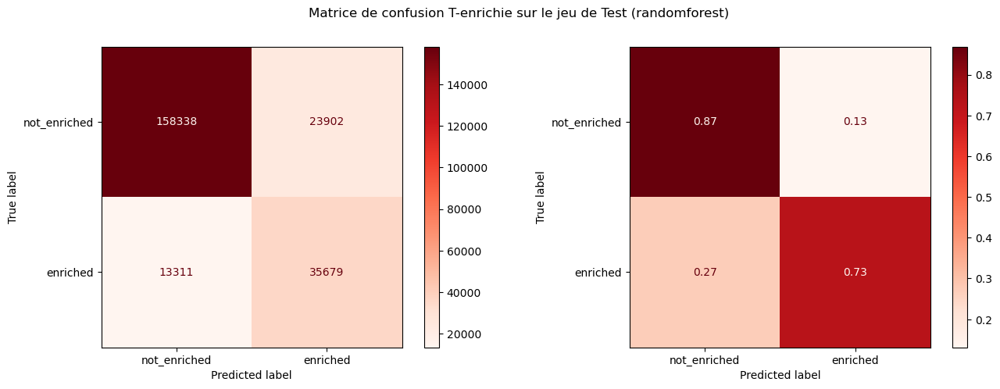

In [76]:
print("----- Random Forest T_enriched -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_train_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_train_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_train_rf:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_test_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_test_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_test_rf:2.3f}")


# Confusion matrix
cmap_color = "Reds"
cmatrix = confusion_matrix(y_test, y_test_pred_rf)
cmatrix_norm = confusion_matrix(y_test, y_test_pred_rf, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T-enrichie sur le jeu de Test (randomforest)")
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix,
    display_labels=labels_class_enrich,
).plot(ax=ax1, cmap=cmap_color)

ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_norm,
    display_labels=labels_class_enrich,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{enrich_perf_dirpath}{sess}_t-enriched_cmatrix-rforest-test")

# Show Figure
plt.show()

----- Random Forest T_enriched (with Dist & Angle) -----
Train
Accuracy   = 0.857
AUC        = 0.845
MCC        = 0.628

Test
Accuracy   = 0.839
AUC        = 0.814
MCC        = 0.574


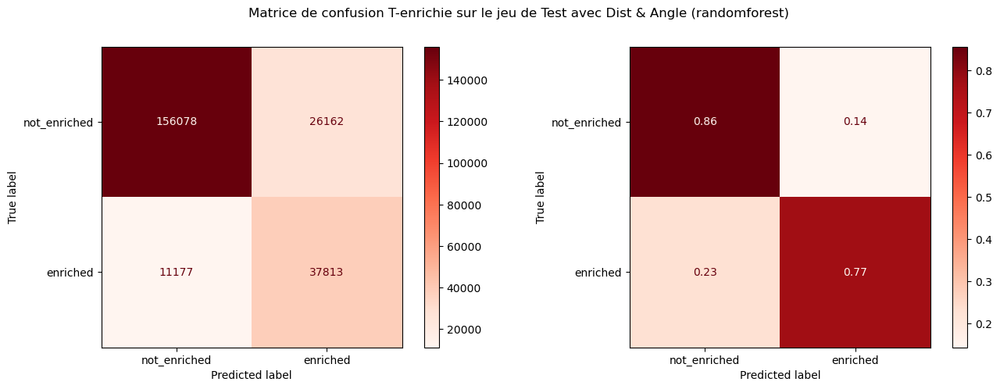

In [77]:
print("----- Random Forest T_enriched (with Dist & Angle) -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_loc_train_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_train_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_train_rf:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_loc_test_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_test_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_test_rf:2.3f}")


# Confusion matrix
cmap_color = "Reds"
cmatrix_loc = confusion_matrix(y_loc_test, y_loc_test_pred_rf)
cmatrix_loc_norm = confusion_matrix(y_loc_test, y_loc_test_pred_rf, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T-enrichie sur le jeu de Test avec Dist & Angle (randomforest)")

# Confusion Matrix displaying count
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc,
    display_labels=labels_class_enrich,
).plot(ax=ax1, cmap=cmap_color)

# Confusion Matrix displaying ratio on true label
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc_norm,
    display_labels=labels_class_enrich,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{enrich_perf_dirpath}{sess}_t-enriched_loc-cmatrix-rforest-test")

# Show Figure
plt.show()

# T enrichie & Density20 > 0

Prédictions des fenêtres avec fibres de classes T-enrichie

### Jeu de données d'apprentissage et de validation à densité20 > 0 (sans valeurs aberrantes)

In [78]:
mask_cd3_density_in = data["Density20"] > 0

In [79]:
# Target column
y_column = "class_t_enriched"

# Define x and y dataframe
xy = data[mask_cd3_density_in][x_loc_columns + [y_column]].dropna()

# features
x_dens = xy[x_columns].values  # x
x_dens_loc = xy[x_loc_columns].values  # x_loc

# target value
y_dens = xy[y_column].values  # y

# Train and Validation set
x_dens_train, x_dens_test, y_dens_train, y_dens_test = train_test_split(
    x_dens, y_dens, test_size=0.3, random_state=seed, stratify=y_dens
)

# Train and Validation set with Angle & Dist
x_loc_dens_train, x_loc_dens_test, y_loc_dens_train, y_loc_dens_test = train_test_split(
    x_dens_loc, y_dens, test_size=0.3, random_state=seed, stratify=y_dens
)

In [80]:
print(f"----- T enrichie - density20 > 0-----")
print(f"\n{'Comptage des classes :':<30s}{'0':<6s}{'':2s}{'1':>6s}")
print(f"{'y:':30s}{sum(y_dens == 0):>6d}{'':2s}{sum(y_dens == 1):>6d}")
print(f"{'y_train:':30s}{sum(y_dens_train == 0):>6d}{'':2s}{sum(y_dens_train == 1):>6d}")
print(f"{'y_test:':30s}{sum(y_dens_test == 0):>6d}{'':2s}{sum(y_dens_test == 1):>6d}")
print(f"\nNombre d'observations totales : {y_dens.shape[0]:_}")

----- T enrichie - density20 > 0-----

Comptage des classes :        0            1
y:                            258104  113036
y_train:                      180673   79125
y_test:                        77431   33911

Nombre d'observations totales : 371_140


# Arbre de décision

In [81]:
depths_dtree = [2, 4, 6, 8, 10, 15, 20]

# Results with best selected depth
results_dens_t_enrich = models.forest_depth_acc(
    x_dens_train, y_dens_train,
    x_dens_test, y_dens_test,
    depths=depths_dtree, 
    classifier=DecisionTreeClassifier,
    random_state=seed,
    class_weight="balanced",
)

# Results with best selected depth (with Dist & Angle)
results_loc_dens_t_enrich = models.forest_depth_acc(
    x_loc_dens_train, y_loc_dens_train,
    x_loc_dens_test, y_loc_dens_test,
    depths=depths_dtree, 
    classifier=DecisionTreeClassifier,
    random_state=seed,
    class_weight="balanced",
)

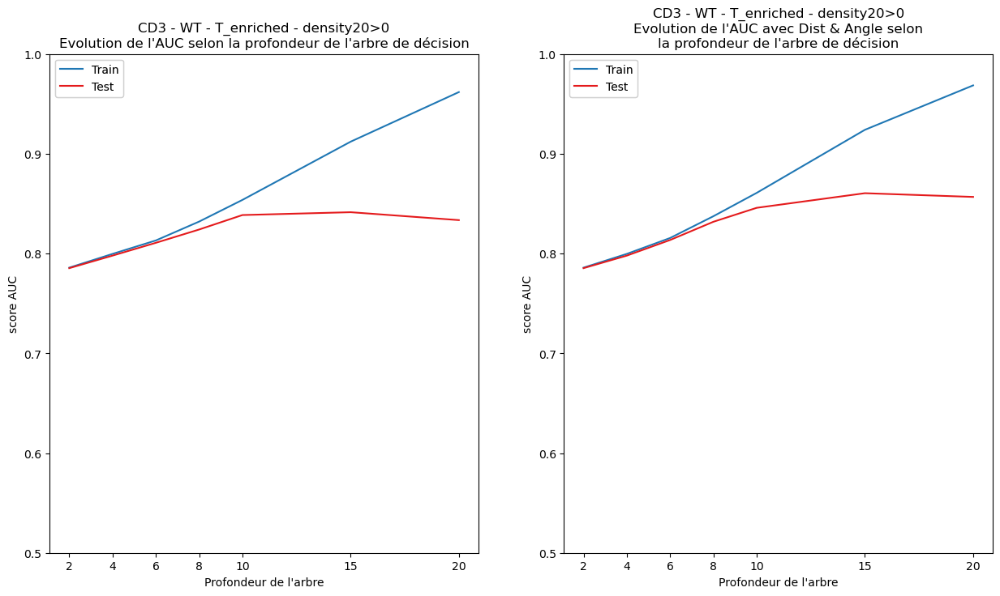

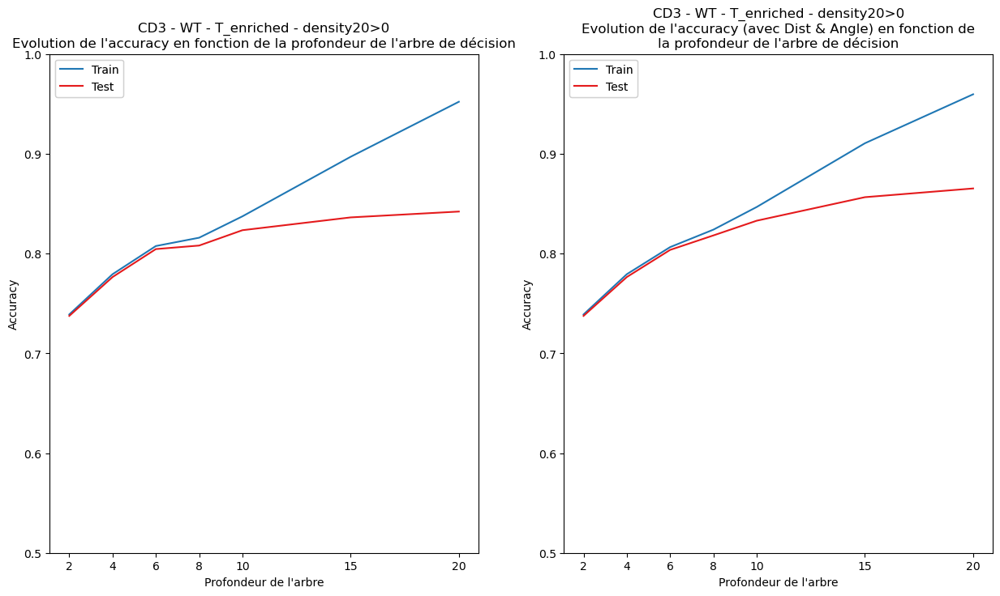

In [82]:
# Plot - AUC
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))
plots.plot(
    results_dens_t_enrich["auc_train"],
    results_dens_t_enrich["auc_test"],
    indices=results_dens_t_enrich["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T_enriched - density20>0\n"
          "Evolution de l'AUC selon la profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=results_dens_t_enrich["depths"], showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax1),
)

plots.plot(
    results_loc_dens_t_enrich["auc_train"],
    results_loc_dens_t_enrich["auc_test"],
    indices=results_loc_dens_t_enrich["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T_enriched - density20>0\n"
          "Evolution de l'AUC avec Dist & Angle selon\n"
          "la profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=results_loc_dens_t_enrich["depths"], showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax2),
)

# Saving plot
fig.savefig(f"{enrich_perf_dirpath}{sess}_t-enriched-density_auc-decisiontree")

# Showing plot
plt.show()

# Plot - accuracy
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_dens_t_enrich["acc_train"],
    results_dens_t_enrich["acc_test"],
    indices=results_dens_t_enrich["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T_enriched - density20>0\n"
          "Evolution de l'accuracy en fonction de la "
          "profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=results_dens_t_enrich["depths"], showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax1)
)

plots.plot(
    results_loc_dens_t_enrich["acc_train"],
    results_loc_dens_t_enrich["acc_test"],
    indices=results_loc_dens_t_enrich["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T_enriched - density20>0\n"
          "Evolution de l'accuracy (avec Dist & Angle) en "
          "fonction de\nla profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=results_loc_dens_t_enrich["depths"], showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax2),
)

# Saving plot
fig.savefig(f"{enrich_perf_dirpath}{sess}_t-enriched-density_accuracy-decisiontree")

# Showing plot
plt.show()

In [83]:
print("----- Résumé des performances en classe T enrichie - density, arbre de décision -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_dens_t_enrich["depths"]] ; print("\n")

print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich["auc_test"]] ; print("\n")
print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich["acc_test"]] ; print("\n")
print(f"{'MCC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich["mcc_train"]] ; print()
print(f"{'MCC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich["mcc_test"]] ; print("\n")

print("--- with Dist & Angle")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich["auc_test"]] ; print("\n")
print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich["acc_test"]] ; print("\n")
print(f"{'MCC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich["mcc_train"]] ; print()
print(f"{'MCC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich["mcc_test"]] ; print()

----- Résumé des performances en classe T enrichie - density, arbre de décision -----
Profondeur          : 2     4     6     8     10    15    20    

AUC_train           : 0.79  0.80  0.81  0.83  0.85  0.91  0.96  
AUC_test            : 0.79  0.80  0.81  0.82  0.84  0.84  0.83  

Accuracy_train      : 0.74  0.78  0.81  0.82  0.84  0.90  0.95  
Accuracy_test       : 0.74  0.78  0.80  0.81  0.82  0.84  0.84  

MCC_train           : 0.53  0.56  0.59  0.62  0.66  0.78  0.89  
MCC_test            : 0.53  0.55  0.59  0.61  0.63  0.65  0.64  

--- with Dist & Angle
AUC_train_dist      : 0.79  0.80  0.82  0.84  0.86  0.92  0.97  
AUC_test_dist       : 0.79  0.80  0.81  0.83  0.85  0.86  0.86  

Accuracy_train_dist : 0.74  0.78  0.81  0.82  0.85  0.91  0.96  
Accuracy_test_dist  : 0.74  0.78  0.80  0.82  0.83  0.86  0.87  

MCC_train_dist      : 0.53  0.56  0.59  0.63  0.68  0.81  0.91  
MCC_test_dist       : 0.53  0.55  0.59  0.62  0.65  0.69  0.69  


In [84]:
# Decision Tree (CART)
dtree_dens_enrich = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=12,
    random_state=seed,
    class_weight="balanced",
)

# Decision Tree (CART) with Dist column
dtree_loc_dens_enrich = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=12,
    random_state=seed,
    class_weight="balanced",
)

In [85]:
# Fitting models to the data
dtree_dens_enrich.fit(x_dens_train, y_dens_train)
dtree_loc_dens_enrich.fit(x_loc_dens_train, y_loc_dens_train)

# Prediction on train and validation
y_dens_train_pred = dtree_dens_enrich.predict(x_dens_train)
y_dens_test_pred = dtree_dens_enrich.predict(x_dens_test)

y_loc_dens_train_pred = dtree_loc_dens_enrich.predict(x_loc_dens_train)
y_loc_dens_test_pred = dtree_loc_dens_enrich.predict(x_loc_dens_test)

# Labels
dtree_dens_enrich.classes_ = \
dtree_loc_dens_enrich.classes_ = \
labels_class_enrich = pd.Series(dtree_dens_enrich.classes_).map(
    {0: 'not_enriched', 1: 'enriched'}
).values

In [86]:
# Performance
fpr_dens_train, tpr_dens_train, _ = roc_curve(y_dens_train, y_dens_train_pred)
fpr_dens_test, tpr_dens_test, _ = roc_curve(y_dens_test, y_dens_test_pred)

fpr_loc_dens_train, tpr_loc_dens_train, _ = roc_curve(y_loc_dens_train, y_loc_dens_train_pred)
fpr_loc_dens_test, tpr_loc_dens_test, _ = roc_curve(y_loc_dens_test, y_loc_dens_test_pred)

# Model performances, how often is the classifier correct?
# train
acc_dens_train = accuracy_score(y_dens_train, y_dens_train_pred)
mcc_dens_train = matthews_corrcoef(y_dens_train, y_dens_train_pred)
auc_dens_train = auc(fpr_dens_train, tpr_dens_train)
# test
acc_dens_test = accuracy_score(y_dens_test, y_dens_test_pred)
mcc_dens_test = matthews_corrcoef(y_dens_test, y_dens_test_pred)
auc_dens_test = auc(fpr_dens_test, tpr_dens_test)

# with dist & angle
# train
acc_loc_dens_train = accuracy_score(y_loc_dens_train, y_loc_dens_train_pred)
mcc_loc_dens_train = matthews_corrcoef(y_loc_dens_train, y_loc_dens_train_pred)
auc_loc_dens_train = auc(fpr_loc_dens_train, tpr_loc_dens_train)
# test
acc_loc_dens_test = accuracy_score(y_loc_dens_test, y_loc_dens_test_pred)
mcc_loc_dens_test = matthews_corrcoef(y_loc_dens_test, y_loc_dens_test_pred)
auc_loc_dens_test = auc(fpr_loc_dens_test, tpr_loc_dens_test)

----- Arbre de décision - T_enriched - density20 > 0 -----
Train
Accuracy   = 0.853
AUC        = 0.866
MCC        = 0.691

Test
Accuracy   = 0.830
AUC        = 0.840
MCC        = 0.640


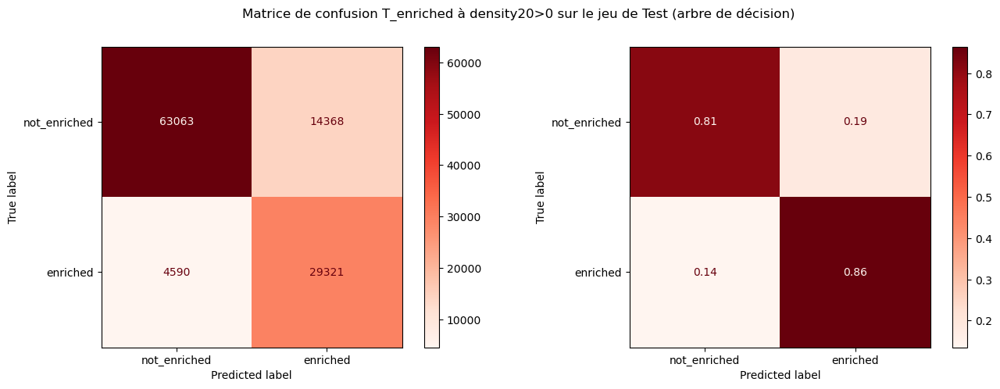

In [87]:
print("----- Arbre de décision - T_enriched - density20 > 0 -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_dens_train:2.3f}")
print(f"{'AUC':<10s} = {auc_dens_train:2.3f}")
print(f"{'MCC':<10s} = {mcc_dens_train:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_dens_test:2.3f}")
print(f"{'AUC':<10s} = {auc_dens_test:2.3f}")
print(f"{'MCC':<10s} = {mcc_dens_test:2.3f}")

# Confusion matrix
cmap_color = "Reds"
cmatrix = confusion_matrix(y_dens_test, y_dens_test_pred)
cmatrix_norm = confusion_matrix(y_dens_test, y_dens_test_pred, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T_enriched à density20>0 sur le jeu de Test (arbre de décision)")
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix,
    display_labels=labels_class_enrich,
).plot(ax=ax1, cmap=cmap_color)

ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_norm,
    display_labels=labels_class_enrich,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{enrich_perf_dirpath}{sess}_t-enriched-density_cmatrix-test")

# Show Figure
plt.show()

----- Arbre de décision - T_enriched - density20 > 0 (with Dist & Angle) -----
Train
Accuracy   = 0.860
AUC        = 0.873
MCC        = 0.705

Test
Accuracy   = 0.839
AUC        = 0.849
MCC        = 0.658


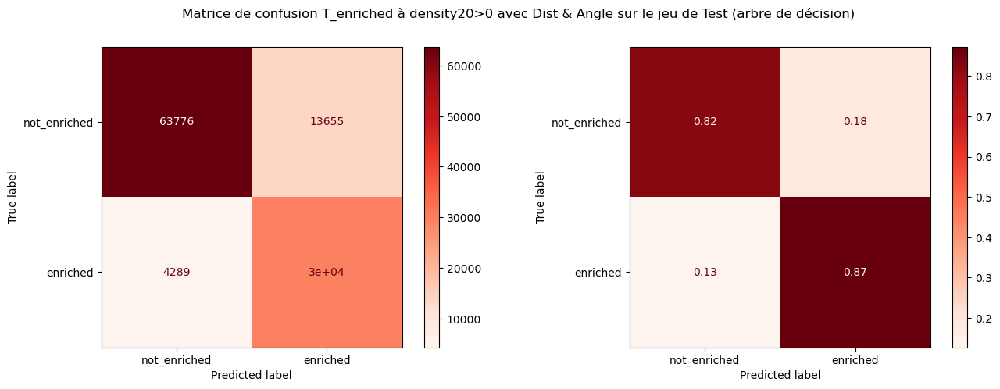

In [88]:
print("----- Arbre de décision - T_enriched - density20 > 0 (with Dist & Angle) -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_loc_dens_train:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_dens_train:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_dens_train:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_loc_dens_test:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_dens_test:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_dens_test:2.3f}")

# Confusion matrix
cmap_color = "Reds"
cmatrix_loc = confusion_matrix(y_loc_dens_test, y_loc_dens_test_pred)
cmatrix_loc_norm = confusion_matrix(y_loc_dens_test, y_loc_dens_test_pred, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T_enriched à density20>0 avec Dist & Angle sur le jeu de Test (arbre de décision)")
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc,
    display_labels=labels_class_enrich,
).plot(ax=ax1, cmap=cmap_color)

ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc_norm,
    display_labels=labels_class_enrich,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{enrich_perf_dirpath}{sess}_t-enriched-density_loc-cmatrix-test")

# Show Figure
plt.show()

In [89]:
# Decision tree text representation
dtree_dens_text = tree.export_text(
    dtree_dens_enrich,
    feature_names=x_columns,
    #class_names=dtree_dens_enrich.classes_,  # sklearn > 1.3.0
    max_depth=16
)

with open(f"{enrich_tree_dirpath}{sess}_t-enriched-density_text-dtree.txt", "w") as txt:
    txt.write(dtree_dens_text)

# Decision tree plot (too large)
dtree_dens_dot = tree.export_graphviz(
    dtree_dens_enrich,
    feature_names=x_columns,
    class_names=dtree_dens_enrich.classes_,
    filled=True
)
dtree_dens_dot = plots.node_color(dtree_dens_dot)

dtree_dens_graph = graphviz.Source(dtree_dens_dot, format="png")
dtree_dens_graph.render(f"{enrich_tree_dirpath}{sess}_t-enriched-density_dtree")
dtree_dens_graph

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.0822246 to fit


In [90]:
# Decision tree text representation
dtree_loc_dens_text = tree.export_text(
    dtree_loc_dens_enrich,
    feature_names=x_loc_columns,
    #class_names=dtree_loc_dens_enrich.classes_,  # sklearn > 1.3.0
    max_depth=16
)

with open(f"{enrich_tree_dirpath}{sess}_t-enriched-density_loc-text-dtree.txt", "w") as txt:
    txt.write(dtree_loc_dens_text)

# Decision tree plot (too large)
dtree_loc_dens_dot = tree.export_graphviz(
    dtree_loc_dens_enrich,
    feature_names=x_loc_columns,
    class_names=dtree_loc_dens_enrich.classes_,
    filled=True
)
dtree_loc_dens_dot = plots.node_color(dtree_loc_dens_dot)

dtree_loc_dens_graph = graphviz.Source(dtree_loc_dens_dot, format="png")
dtree_loc_dens_graph.render(f"{enrich_tree_dirpath}{sess}_t-enriched-density_loc-dtree")
dtree_loc_dens_graph

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.0859167 to fit


# Random Forest

In [91]:
depths_rf = [2, 6, 10, 15, 20]

# Results with best selected depth
results_dens_t_enrich_rf = models.forest_depth_acc(
    x_dens_train, y_dens_train,
    x_dens_test, y_dens_test,
    depths=depths_rf, 
    classifier=RandomForestClassifier,
    n_estimators = 25,
    random_state=seed,
    class_weight="balanced",
    n_jobs=-1
)

# Results with best selected depth (with Dist & Angle)
results_loc_dens_t_enrich_rf = models.forest_depth_acc(
    x_loc_dens_train, y_loc_dens_train,
    x_loc_dens_test, y_loc_dens_test,
    depths=depths_rf, 
    classifier=RandomForestClassifier,
    n_estimators = 25,
    random_state=seed,
    class_weight="balanced",
    n_jobs=-1
)

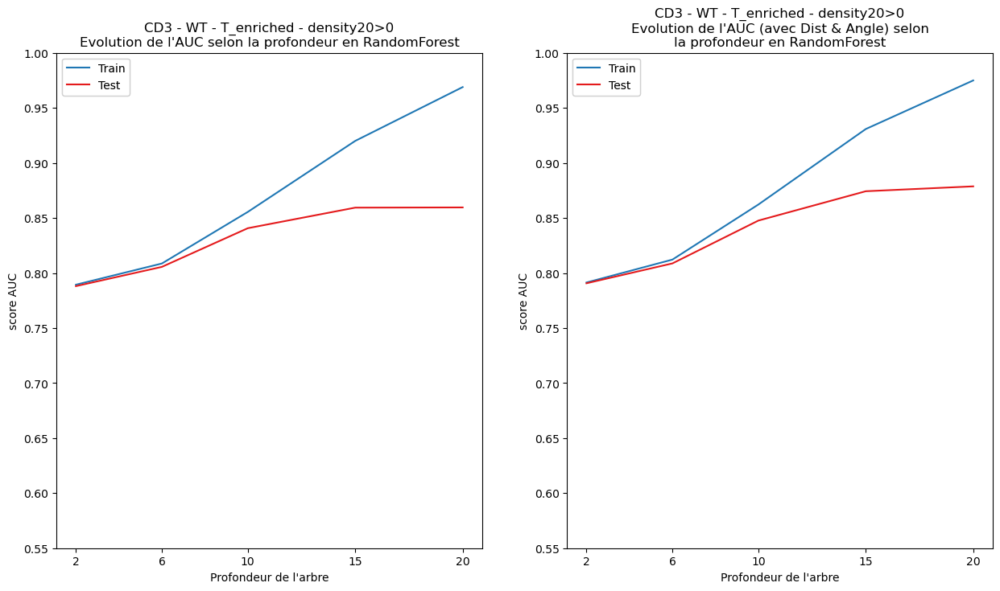

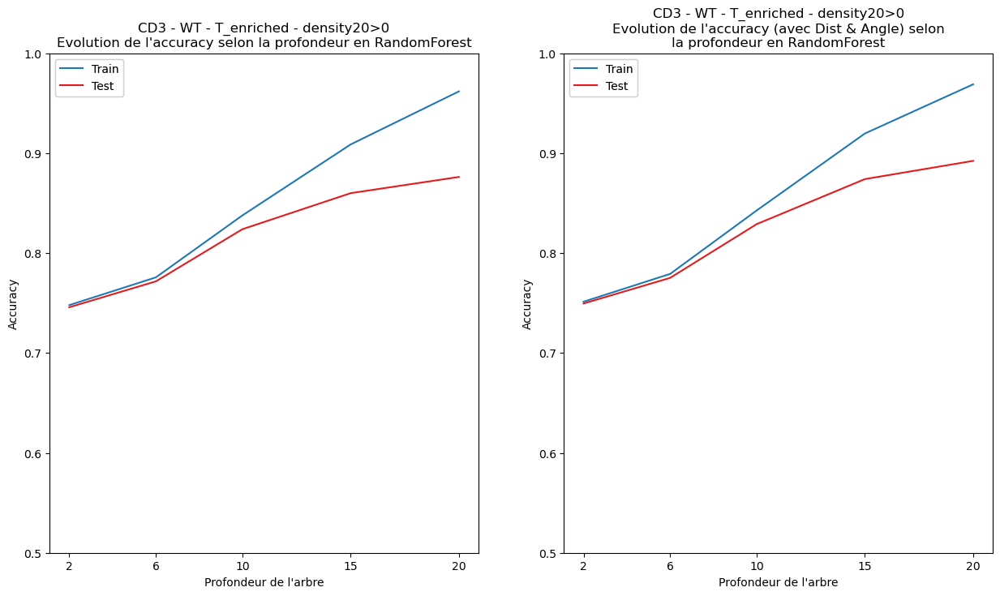

In [92]:
# Plot - auc
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_dens_t_enrich_rf["auc_train"],
    results_dens_t_enrich_rf["auc_test"],
    indices=results_dens_t_enrich_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T_enriched - density20>0\n"
          "Evolution de l'AUC selon la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=results_dens_t_enrich_rf["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=1, figure=(fig, ax1)
)

plots.plot(
    results_loc_dens_t_enrich_rf["auc_train"],
    results_loc_dens_t_enrich_rf["auc_test"],
    indices=results_loc_dens_t_enrich_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T_enriched - density20>0\n"
          "Evolution de l'AUC (avec Dist & Angle) selon\n"
          "la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=results_loc_dens_t_enrich_rf["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=1, figure=(fig, ax2)
)

# Saving plot
fig.savefig(f"{enrich_perf_dirpath}{sess}_t-enriched-density_auc-rforest")

# Showing plot
plt.show()

# Plot - accuracy
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_dens_t_enrich_rf["acc_train"],
    results_dens_t_enrich_rf["acc_test"],
    indices=results_dens_t_enrich_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T_enriched - density20>0\n"
          "Evolution de l'accuracy selon la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=results_dens_t_enrich_rf["depths"], showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax1)
)

plots.plot(
    results_loc_dens_t_enrich_rf["acc_train"],
    results_loc_dens_t_enrich_rf["acc_test"],
    indices=results_loc_dens_t_enrich_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T_enriched - density20>0\n"
          "Evolution de l'accuracy (avec Dist & Angle) selon\n"
          "la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=results_loc_dens_t_enrich_rf["depths"], showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax2)
)

# Saving plot
fig.savefig(f"{enrich_perf_dirpath}{sess}_t-enriched-density-accuracy-rforest")

# Showing plot
plt.show()

In [93]:
print("----- Résumé des performances T enrichie - density20>0, arbre de décision -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_dens_t_enrich_rf["depths"]] ; print("\n")

print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich_rf["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich_rf["auc_test"]] ; print("\n")
print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich_rf["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich_rf["acc_test"]] ; print("\n")
print(f"{'MCC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich_rf["mcc_train"]] ; print()
print(f"{'MCC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich_rf["mcc_test"]] ; print("\n")

print("--- with Dist & Angle")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich_rf["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich_rf["auc_test"]] ; print("\n")
print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich_rf["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich_rf["acc_test"]] ; print("\n")
print(f"{'MCC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich_rf["mcc_train"]] ; print()
print(f"{'MCC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich_rf["mcc_test"]] ; print()

----- Résumé des performances T enrichie - density20>0, arbre de décision -----
Profondeur          : 2     6     10    15    20    

AUC_train           : 0.79  0.81  0.86  0.92  0.97  
AUC_test            : 0.79  0.81  0.84  0.86  0.86  

Accuracy_train      : 0.75  0.78  0.84  0.91  0.96  
Accuracy_test       : 0.75  0.77  0.82  0.86  0.88  

MCC_train           : 0.53  0.57  0.67  0.80  0.91  
MCC_test            : 0.53  0.56  0.64  0.69  0.71  

--- with Dist & Angle
AUC_train_dist      : 0.79  0.81  0.86  0.93  0.97  
AUC_test_dist       : 0.79  0.81  0.85  0.87  0.88  

Accuracy_train_dist : 0.75  0.78  0.84  0.92  0.97  
Accuracy_test_dist  : 0.75  0.78  0.83  0.87  0.89  

MCC_train_dist      : 0.54  0.58  0.68  0.83  0.93  
MCC_test_dist       : 0.54  0.57  0.65  0.72  0.75  


In [94]:
# Random search parameters
n_estimators_dens_enrich = (10, 15, 20, 30)
n_depths_dens_enrich = (2, 4, 8, 10, 15)

Best hyperparameters: {'n_estimators': 15, 'max_depth': 15}
Test Accuracy: 0.8574841479405795
Computing MDI importances
Elapsed time to compute mean decrease impurity (MDI) importance: 0.002 seconds

Computing permutation importances 
Elapsed time to compute permutation importance: 7.181 seconds



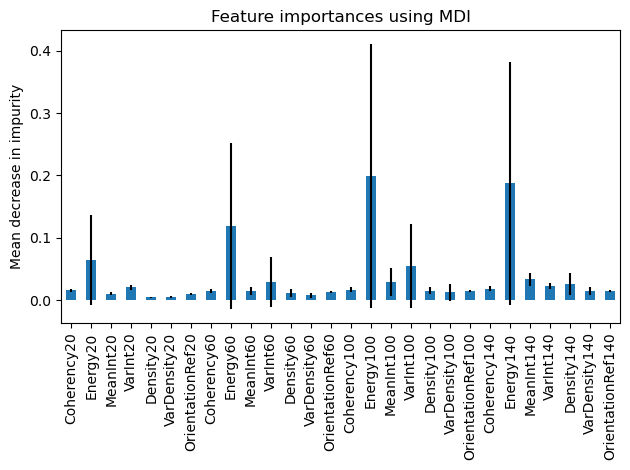

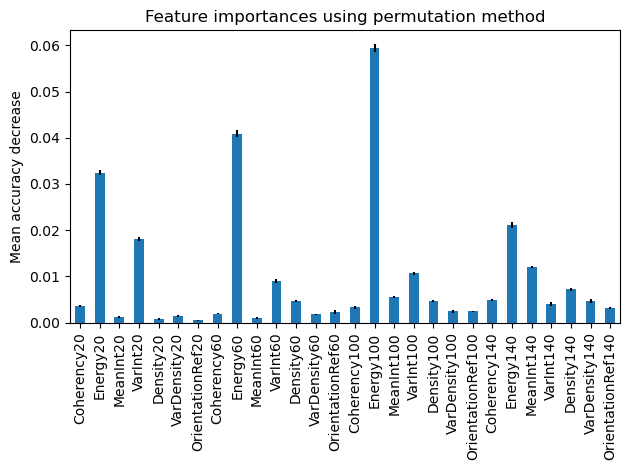

In [95]:
# Random forest
results_rf_dens_enrich = models.perform_random_forest(
    x_train=x_dens_train,
    x_test=x_dens_test,
    y_train=y_dens_train,
    y_test=y_dens_test,
    columns=x_columns,
    n_estimators=n_estimators_dens_enrich,
    n_depths=n_depths_dens_enrich,
    class_weight="balanced",
    scale=False,
    seed=seed
)

# Save MDI importances
df_mdi_rf_dens_enrich = pd.DataFrame(
    {
        "mean": results_rf_dens_enrich["importance_mdi"]["mean"],
        "std": results_rf_dens_enrich["importance_mdi"]["std"]
    }, index=x_columns
)

df_mdi_rf_dens_enrich.to_csv(f"{enrich_imp_dirpath}{sess}_t-enriched-density_mdi_rforest.csv")  # save

# Save permutation importances
df_permutation_rf_dens_enrich = pd.DataFrame(
    {
        "mean": results_rf_dens_enrich["importance_permutation"]["mean"],
        "std": results_rf_dens_enrich["importance_permutation"]["std"]
    }, index=x_columns
)

df_permutation_rf_dens_enrich.to_csv(f"{enrich_imp_dirpath}{sess}_t-enriched-density_permu_rforest.csv")  # save

# Model with best parameters
rf_dens_enrich = results_rf_dens_enrich["model"]

Best hyperparameters: {'n_estimators': 15, 'max_depth': 15}
Test Accuracy: 0.8704891236011568
Computing MDI importances
Elapsed time to compute mean decrease impurity (MDI) importance: 0.003 seconds

Computing permutation importances 
Elapsed time to compute permutation importance: 8.707 seconds



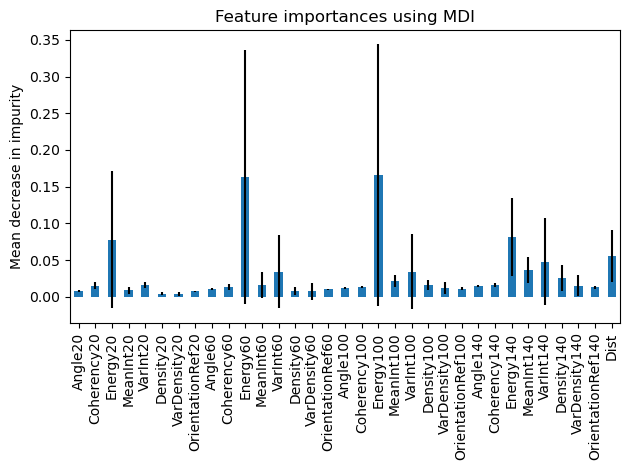

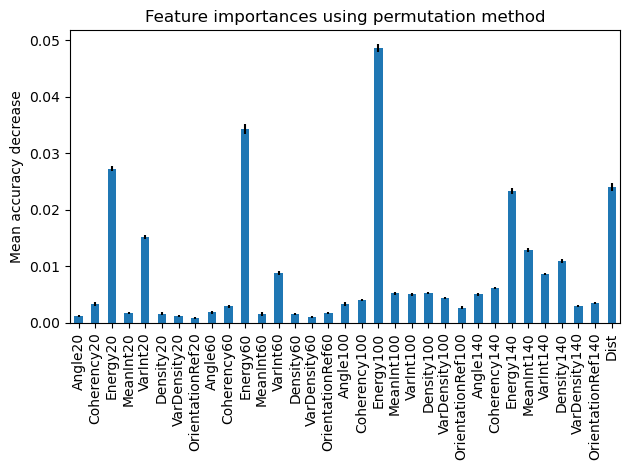

In [96]:
# Random forest with Dist & Angle
results_rf_loc_dens_enrich = models.perform_random_forest(
    x_train=x_loc_dens_train,
    x_test=x_loc_dens_test,
    y_train=y_loc_dens_train,
    y_test=y_loc_dens_test,
    columns=x_loc_columns,
    n_estimators=n_estimators_dens_enrich,
    n_depths=n_depths_dens_enrich,
    class_weight="balanced",
    scale=False,
    seed=seed
)

# Save MDI importances
df_mdi_rf_loc_dens_enrich = pd.DataFrame(
    {
        "mean": results_rf_loc_dens_enrich["importance_mdi"]["mean"],
        "std": results_rf_loc_dens_enrich["importance_mdi"]["std"]
    }, index=x_loc_columns
)

df_mdi_rf_loc_dens_enrich.to_csv(f"{enrich_imp_dirpath}{sess}_t-enriched-density_loc-mdi_rforest.csv")  # save

# Save permutation importances
df_permutation_rf_loc_dens_enrich = pd.DataFrame(
    {
        "mean": results_rf_loc_dens_enrich["importance_permutation"]["mean"],
        "std": results_rf_loc_dens_enrich["importance_permutation"]["std"]
    }, index=x_loc_columns
)

df_permutation_rf_loc_dens_enrich.to_csv(f"{enrich_imp_dirpath}{sess}_t-enriched-density_loc-permu_rforest.csv")  # save

# Model with best parameters
rf_loc_dens_enrich = results_rf_loc_dens_enrich["model"]

In [97]:
# Model Accuracy, how often is the classifier correct?
y_dens_train_pred_rf = rf_dens_enrich.predict(x_dens_train)
y_dens_test_pred_rf = rf_dens_enrich.predict(x_dens_test)

y_loc_dens_train_pred_rf = rf_loc_dens_enrich.predict(x_loc_dens_train)
y_loc_dens_test_pred_rf = rf_loc_dens_enrich.predict(x_loc_dens_test)

In [98]:
# Performance
fpr_dens_train_rf, tpr_dens_train_rf, _ = roc_curve(y_dens_train, y_dens_train_pred_rf)
fpr_dens_test_rf, tpr_dens_test_rf, _ = roc_curve(y_dens_test, y_dens_test_pred_rf)

fpr_loc_dens_train_rf, tpr_loc_dens_train_rf, _ = roc_curve(y_loc_dens_train, y_loc_dens_train_pred_rf)
fpr_loc_dens_test_rf, tpr_loc_dens_test_rf, _ = roc_curve(y_loc_dens_test, y_loc_dens_test_pred_rf)

# Model performances, how often is the classifier correct?
# train
acc_dens_train_rf = accuracy_score(y_dens_train, y_dens_train_pred_rf)
mcc_dens_train_rf = matthews_corrcoef(y_dens_train, y_dens_train_pred_rf)
auc_dens_train_rf = auc(fpr_dens_train_rf, tpr_dens_train_rf)
# test
acc_dens_test_rf = accuracy_score(y_dens_test, y_dens_test_pred_rf)
mcc_dens_test_rf = matthews_corrcoef(y_dens_test, y_dens_test_pred_rf)
auc_dens_test_rf = auc(fpr_dens_test_rf, tpr_dens_test_rf)

# with dist & angle
# train
acc_loc_dens_train_rf = accuracy_score(y_loc_dens_train, y_loc_dens_train_pred_rf)
mcc_loc_dens_train_rf = matthews_corrcoef(y_loc_dens_train, y_loc_dens_train_pred_rf)
auc_loc_dens_train_rf = auc(fpr_loc_dens_train_rf, tpr_loc_dens_train_rf)
# test
acc_loc_dens_test_rf = accuracy_score(y_loc_dens_test, y_loc_dens_test_pred_rf)
mcc_loc_dens_test_rf = matthews_corrcoef(y_loc_dens_test, y_loc_dens_test_pred_rf)
auc_loc_dens_test_rf = auc(fpr_loc_dens_test_rf, tpr_loc_dens_test_rf)

----- Random Forest T_enriched - density20>0 -----
Train
Accuracy   = 0.906
AUC        = 0.917
MCC        = 0.798

Test
Accuracy   = 0.857
AUC        = 0.857
MCC        = 0.685


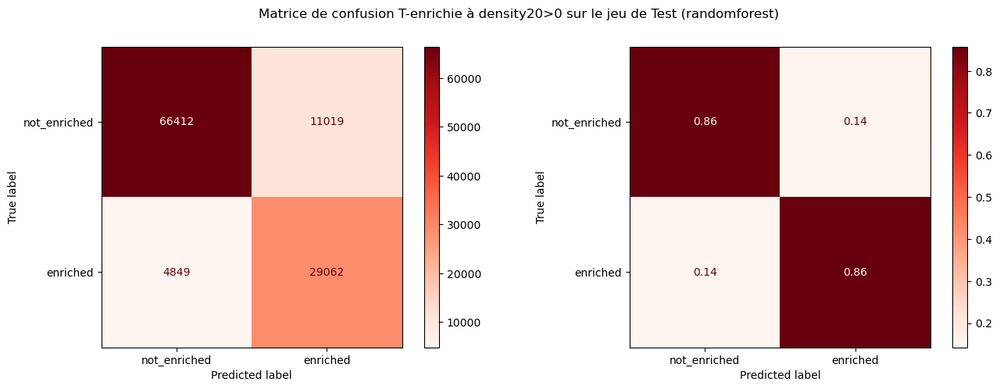

In [99]:
print("----- Random Forest T_enriched - density20>0 -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_dens_train_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_dens_train_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_dens_train_rf:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_dens_test_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_dens_test_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_dens_test_rf:2.3f}")


# Confusion matrix
cmap_color = "Reds"
cmatrix = confusion_matrix(y_dens_test, y_dens_test_pred_rf)
cmatrix_norm = confusion_matrix(y_dens_test, y_dens_test_pred_rf, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T-enrichie à density20>0 sur le jeu de Test (randomforest)")
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix,
    display_labels=labels_class_enrich,
).plot(ax=ax1, cmap=cmap_color)

ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_norm,
    display_labels=labels_class_enrich,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{enrich_perf_dirpath}{sess}_t-enriched-density_cmatrix-rforest-test")

# Show Figure
plt.show()

----- Random Forest T_enriched (with Dist & Angle) - density20>0 -----
Train
Accuracy   = 0.916
AUC        = 0.927
MCC        = 0.818

Test
Accuracy   = 0.870
AUC        = 0.871
MCC        = 0.713


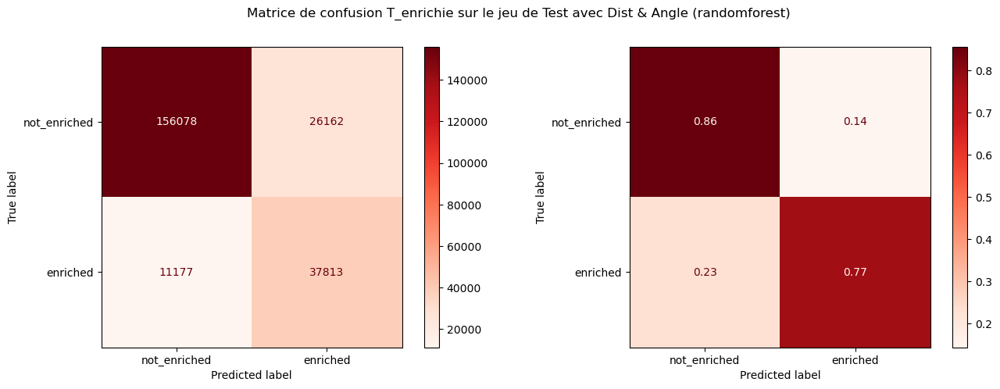

In [100]:
print("----- Random Forest T_enriched (with Dist & Angle) - density20>0 -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_loc_dens_train_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_dens_train_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_dens_train_rf:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_loc_dens_test_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_dens_test_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_dens_test_rf:2.3f}")

# Confusion matrix
cmap_color = "Reds"
cmatrix_loc = confusion_matrix(y_loc_test, y_loc_test_pred_rf)
cmatrix_loc_norm = confusion_matrix(y_loc_test, y_loc_test_pred_rf, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T_enrichie sur le jeu de Test avec Dist & Angle (randomforest)")

# Confusion Matrix displaying count
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc,
    display_labels=labels_class_enrich,
).plot(ax=ax1, cmap=cmap_color)

# Confusion Matrix displaying ratio on true label
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc_norm,
    display_labels=labels_class_enrich,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{enrich_perf_dirpath}{sess}_t-enriched-density_loc-cmatrix-rforest-test")

# Show Figure
plt.show()

# T enrichie 2

Prédiction de fenêtres de classe **enriched_2**

In [101]:
# Respective directory for the designed class
enrich2_perf_dirpath = auxiliary.create_dir(f"{sess_perf_dirpath}{'enriched_2'}")
enrich2_tree_dirpath = auxiliary.create_dir(f"{sess_tree_dirpath}{'enriched_2'}")
enrich2_imp_dirpath = auxiliary.create_dir(f"{sess_imp_dirpath}{'enriched_2'}")

In [102]:
# Target column
y_column = "class_t_enriched_2"

# Define x and y dataframe
xy = data[x_loc_columns + [y_column]].dropna()

# features
x = xy[x_columns].values
x_loc = xy[x_loc_columns].values  # with distance/angle

# target value
y = xy[y_column].values

## Train and Validation
x_train, x_test, y_train, y_test = train_test_split(
    x, y, test_size=0.3, random_state=seed, stratify=y
)

# With (Angle & Dist)
x_loc_train, x_loc_test, y_loc_train, y_loc_test = train_test_split(
    x_loc, y, test_size=0.3, random_state=seed, stratify=y
)

In [103]:
print(f"----- T enrichie 2 -----")
print(f"\n{'Comptage des classes :':<30s}{'0':<6s}{'':2s}{'1':>6s}")
print(f"{'y:':30s}{sum(y == 0):>6d}{'':2s}{sum(y == 1):>6d}")
print(f"{'y_train:':30s}{sum(y_train == 0):>6d}{'':2s}{sum(y_train == 1):>6d}")
print(f"{'y_test:':30s}{sum(y_test == 0):>6d}{'':2s}{sum(y_test == 1):>6d}")
print(f"\nNombre d'observations totales : {y.shape[0]:_}")

----- T enrichie 2 -----

Comptage des classes :        0            1
y:                            650866  119900
y_train:                      455606   83930
y_test:                       195260   35970

Nombre d'observations totales : 770_766


#### Arbre de décision

In [104]:
depths_dtree = [2, 4, 6, 8, 10, 15, 20]

# Results with best selected depth
results_t_enrich_2 = models.forest_depth_acc(
    x_train, y_train, x_test, y_test,
    depths=depths_dtree, 
    classifier=DecisionTreeClassifier,
    random_state=seed,
    class_weight="balanced"
)

# Results with best seleccted depth with Dist & Angle
results_loc_t_enrich_2 = models.forest_depth_acc(
    x_loc_train, y_loc_train, x_loc_test, y_loc_test,
    depths=depths_dtree, 
    classifier=DecisionTreeClassifier,
    random_state=seed,
    class_weight="balanced"
)

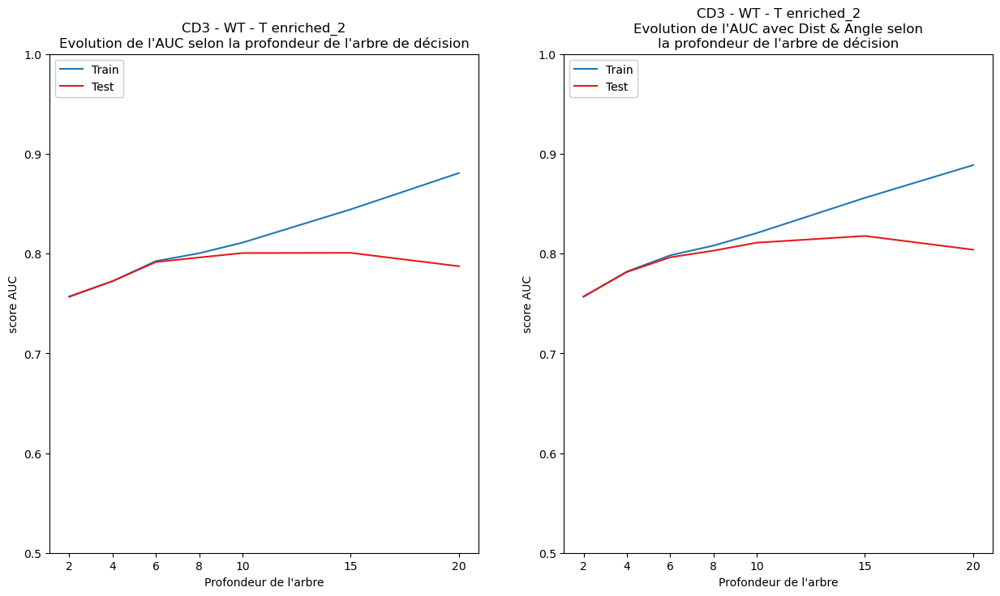

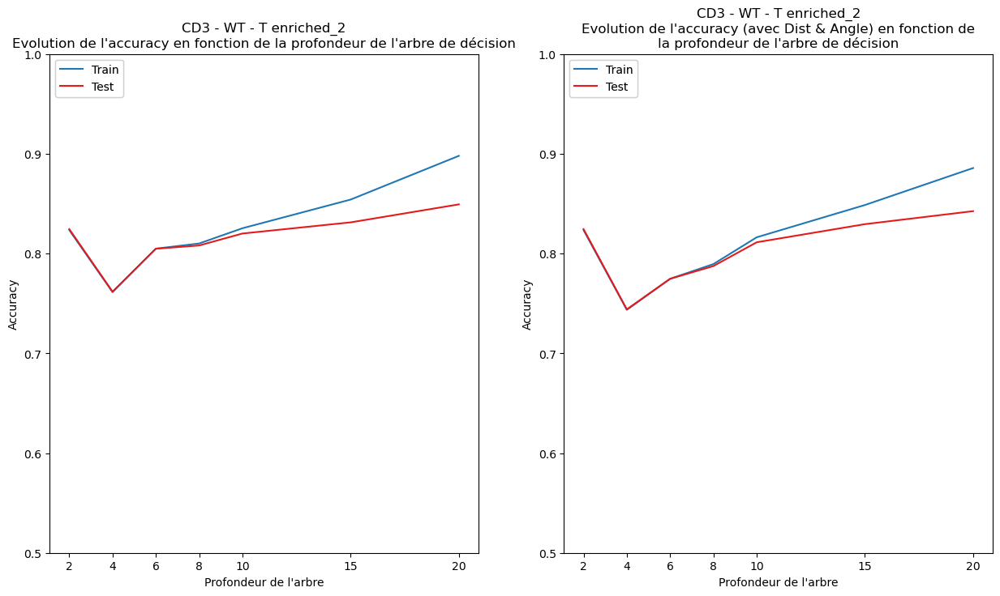

In [105]:
# Plot - AUC
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))
plots.plot(
    results_t_enrich_2["auc_train"],
    results_t_enrich_2["auc_test"],
    indices=results_t_enrich_2["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T enriched_2\n"
          "Evolution de l'AUC selon la profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=depths_dtree, showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax1)
)

plots.plot(
    results_loc_t_enrich_2["auc_train"],
    results_loc_t_enrich_2["auc_test"],
    indices=results_loc_t_enrich_2["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T enriched_2\n"
          "Evolution de l'AUC avec Dist & Angle selon\n"
          "la profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=depths_dtree, showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax2),
)

# Saving plot
fig.savefig(f"{enrich2_perf_dirpath}{sess}_t-enriched-2_auc-decisiontree")

# Showing plot
plt.show()

# Plot - Accuracy
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_t_enrich_2["acc_train"],
    results_t_enrich_2["acc_test"],
    indices=results_t_enrich_2["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T enriched_2\n"
          "Evolution de l'accuracy en fonction de la "
          "profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=depths_dtree, showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax1)
)

plots.plot(
    results_loc_t_enrich_2["acc_train"],
    results_loc_t_enrich_2["acc_test"],
    indices=results_loc_t_enrich_2["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T enriched_2\n"
          "Evolution de l'accuracy (avec Dist & Angle) en "
          "fonction de\nla profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=depths_dtree, showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax2),
)

# Saving plot
fig.savefig(f"{enrich2_perf_dirpath}{sess}_t-enriched-2_accuracy-decisiontree")

# Showing plot
plt.show()

In [106]:
print("----- Résumé des performances en classe T enrichie 2, arbre de décision -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_t_enrich_2["depths"]] ; print("\n")

print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich_2["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich_2["auc_test"]] ; print("\n")
print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich_2["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich_2["acc_test"]] ; print("\n")
print(f"{'MCC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich_2["mcc_train"]] ; print()
print(f"{'MCC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich_2["mcc_test"]] ; print("\n")

print("--- with Dist & Angle")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich_2["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich_2["auc_test"]] ; print("\n")
print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich_2["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich_2["acc_test"]] ; print("\n")
print(f"{'MCC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich_2["mcc_train"]] ; print()
print(f"{'MCC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich_2["mcc_test"]] ; print()

----- Résumé des performances en classe T enrichie 2, arbre de décision -----
Profondeur          : 2     4     6     8     10    15    20    

AUC_train           : 0.76  0.77  0.79  0.80  0.81  0.84  0.88  
AUC_test            : 0.76  0.77  0.79  0.80  0.80  0.80  0.79  

Accuracy_train      : 0.82  0.76  0.80  0.81  0.83  0.85  0.90  
Accuracy_test       : 0.82  0.76  0.80  0.81  0.82  0.83  0.85  

MCC_train           : 0.44  0.42  0.47  0.49  0.51  0.58  0.67  
MCC_test            : 0.45  0.42  0.47  0.48  0.49  0.50  0.51  

--- with Dist & Angle
AUC_train_dist      : 0.76  0.78  0.80  0.81  0.82  0.86  0.89  
AUC_test_dist       : 0.76  0.78  0.80  0.80  0.81  0.82  0.80  

Accuracy_train_dist : 0.82  0.74  0.77  0.79  0.82  0.85  0.89  
Accuracy_test_dist  : 0.82  0.74  0.77  0.79  0.81  0.83  0.84  

MCC_train_dist      : 0.44  0.43  0.46  0.48  0.51  0.58  0.66  
MCC_test_dist       : 0.45  0.42  0.46  0.47  0.50  0.52  0.52  


In [107]:
# Decision Tree (CART)
dtree_enriched_2 = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=10,
    random_state=seed,
    class_weight="balanced"
)

# Decision Tree (CART) with Dist column
dtree_loc_enriched_2 = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=10,
    random_state=seed,
    class_weight="balanced"
)

In [108]:
# Fitting models on data
dtree_enriched_2.fit(x_train, y_train)
dtree_loc_enriched_2.fit(x_loc_train, y_loc_train)

# Prediction on train and validation
y_train_pred = dtree_enriched_2.predict(x_train)
y_test_pred = dtree_enriched_2.predict(x_test)

y_loc_train_pred = dtree_loc_enriched_2.predict(x_loc_train)
y_loc_test_pred = dtree_loc_enriched_2.predict(x_loc_test)

# Labels (for re-assignment)
dtree_enriched_2.classes_ = \
dtree_loc_enriched_2.classes_ = \
labels_class_enrich_2 = pd.Series(dtree_enriched_2.classes_).map(
    {0: 'not_enriched-2', 1: 'enriched-2'}
).values

In [109]:
# ROC values - false positive rate (fpr), and true positive rate (tpr)
fpr_train, tpr_train, _ = roc_curve(y_train, y_train_pred)
fpr_test, tpr_test, _ = roc_curve(y_test, y_test_pred)

fpr_loc_train, tpr_loc_train, _ = roc_curve(y_loc_train, y_loc_train_pred)
fpr_loc_test, tpr_loc_test, _ = roc_curve(y_loc_test, y_loc_test_pred)

# Model performances, how often is the classifier correct?
# train
acc_train = accuracy_score(y_train, y_train_pred)
mcc_train = matthews_corrcoef(y_train, y_train_pred)
auc_train = auc(fpr_train, tpr_train)
# test
acc_test = accuracy_score(y_test, y_test_pred)
mcc_test = matthews_corrcoef(y_test, y_test_pred)
auc_test = auc(fpr_test, tpr_test)

# with dist & angle
# train
acc_loc_train = accuracy_score(y_loc_train, y_loc_train_pred)
mcc_loc_train = matthews_corrcoef(y_loc_train, y_loc_train_pred)
auc_loc_train = auc(fpr_loc_train, tpr_loc_train)
# test
acc_loc_test = accuracy_score(y_loc_test, y_loc_test_pred)
mcc_loc_test = matthews_corrcoef(y_loc_test, y_loc_test_pred)
auc_loc_test = auc(fpr_loc_test, tpr_loc_test)

----- Arbre de décision T enrichie 2 -----
Train
Accuracy   = 0.818
AUC        = 0.809
MCC        = 0.502

Test
Accuracy   = 0.815
AUC        = 0.802
MCC        = 0.491


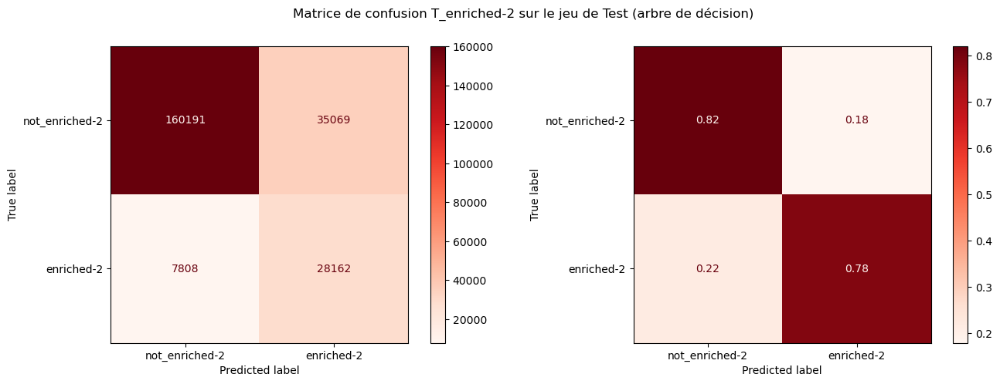

In [110]:
print("----- Arbre de décision T enrichie 2 -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_train:2.3f}")
print(f"{'AUC':<10s} = {auc_train:2.3f}")
print(f"{'MCC':<10s} = {mcc_train:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_test:2.3f}")
print(f"{'AUC':<10s} = {auc_test:2.3f}")
print(f"{'MCC':<10s} = {mcc_test:2.3f}")

# Confusion matrix
cmap_color = "Reds"
cmatrix = confusion_matrix(y_test, y_test_pred)
cmatrix_norm = confusion_matrix(y_test, y_test_pred, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T_enriched-2 sur le jeu de Test (arbre de décision)")
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix,
    display_labels=labels_class_enrich_2,
).plot(ax=ax1, cmap=cmap_color)

ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_norm,
    display_labels=labels_class_enrich_2,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{enrich2_perf_dirpath}{sess}_t-enriched-2_cmatrix-dtree-test")

# Show Figure
plt.show()

----- Arbre de décision T enrichie 2 (with Dist & Angle) -----
Train
Accuracy   = 0.812
AUC        = 0.819
MCC        = 0.510

Test
Accuracy   = 0.808
AUC        = 0.811
MCC        = 0.498


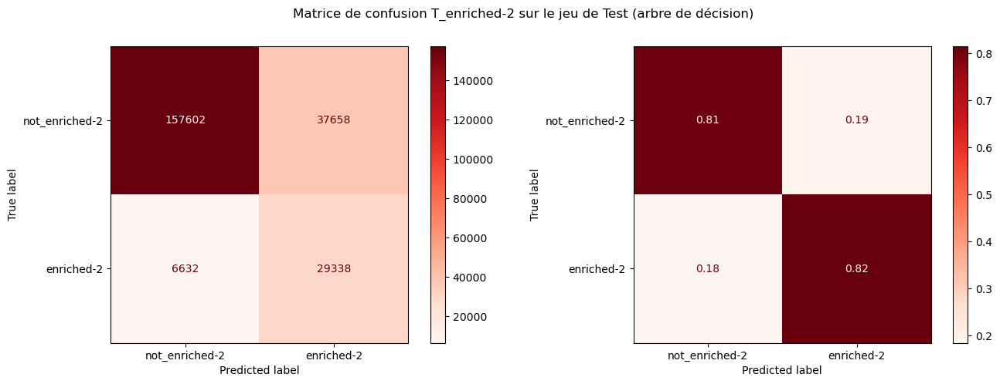

In [111]:
print("----- Arbre de décision T enrichie 2 (with Dist & Angle) -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_loc_train:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_train:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_train:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_loc_test:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_test:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_test:2.3f}")

# Confusion matrix
cmap_color = "Reds"
cmatrix_loc = confusion_matrix(y_loc_test, y_loc_test_pred)
cmatrix_loc_norm = confusion_matrix(y_loc_test, y_loc_test_pred, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T_enriched-2 sur le jeu de Test (arbre de décision)")
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc,
    display_labels=labels_class_enrich_2,
).plot(ax=ax1, cmap=cmap_color)

ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc_norm,
    display_labels=labels_class_enrich_2,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{enrich2_perf_dirpath}{sess}_t-enriched-2_loc-cmatrix-dtree-test")

# Show Figure
plt.show()

In [112]:
# Decision tree text representation
dtree_text = tree.export_text(
    dtree_enriched_2,
    feature_names=x_columns,
    #class_names=dtree_enriched_2.classes_,  # sklearn > 1.3.0
    max_depth=16
)

with open(f"{enrich2_tree_dirpath}{sess}_t-enriched-2_text-dtree.txt", "w") as txt:
    txt.write(dtree_text)

# Decision tree plot (too large)
dtree_dot = tree.export_graphviz(
    dtree_enriched_2,
    feature_names=x_columns,
    class_names=dtree_enriched_2.classes_,
    filled=True
)
dtree_dot = plots.node_color(dtree_dot)

dtree_graph = graphviz.Source(dtree_dot, format="png")
dtree_graph.render(f"{enrich2_tree_dirpath}{sess}_t-enriched-2_dtree")
dtree_graph

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.194095 to fit


In [113]:
# Decision tree text representation
dtree_loc_text = tree.export_text(
    dtree_loc_enriched_2,
    feature_names=x_loc_columns,
    #class_names=dtree_loc_enriched_2.classes_,  # sklearn > 1.3.0
    max_depth=16
)

with open(f"{enrich2_tree_dirpath}{sess}_t-enriched-2_loc-text-dtree.txt", "w") as txt:
    txt.write(dtree_loc_text)

# Decision tree plot (too large)
dtree_loc_dot = tree.export_graphviz(
    dtree_loc_enriched_2,
    feature_names=x_loc_columns,
    class_names=dtree_loc_enriched_2.classes_,
    filled=True
)
dtree_loc_dot = plots.node_color(dtree_loc_dot)

dtree_loc_graph = graphviz.Source(dtree_loc_dot, format="png")
dtree_loc_graph.render(f"{enrich2_tree_dirpath}{sess}_t-enriched-2_loc-dtree")
dtree_loc_graph

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.173802 to fit


# Random Forest

In [114]:
depths_rf = [2, 4, 6, 8, 10, 15, 20]

# Results with best selected depth
results_t_enrich_2_rf = models.forest_depth_acc(
    x_train, y_train, x_test, y_test,
    depths=depths_rf, 
    classifier=RandomForestClassifier,
    n_estimators = 100,
    random_state=seed,
    class_weight="balanced",
    n_jobs=-1
)

# Results with best selected depth (with Dist & Angle)
results_loc_t_enrich_2_rf = models.forest_depth_acc(
    x_loc_train, y_loc_train, x_loc_test, y_loc_test,
    depths=depths_rf, 
    classifier=RandomForestClassifier,
    n_estimators = 100,
    random_state=seed,
    class_weight="balanced",
    n_jobs=-1
)

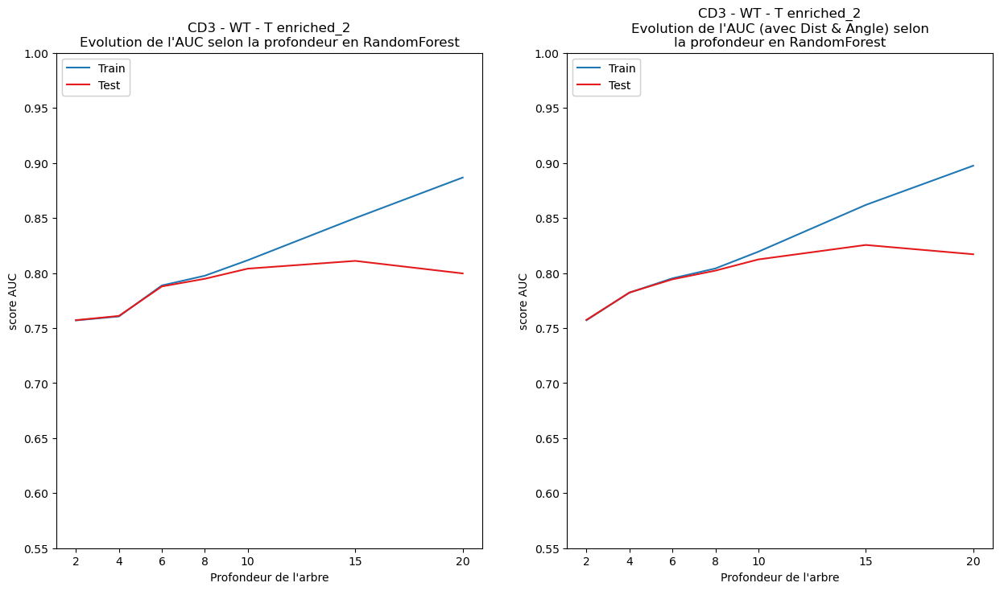

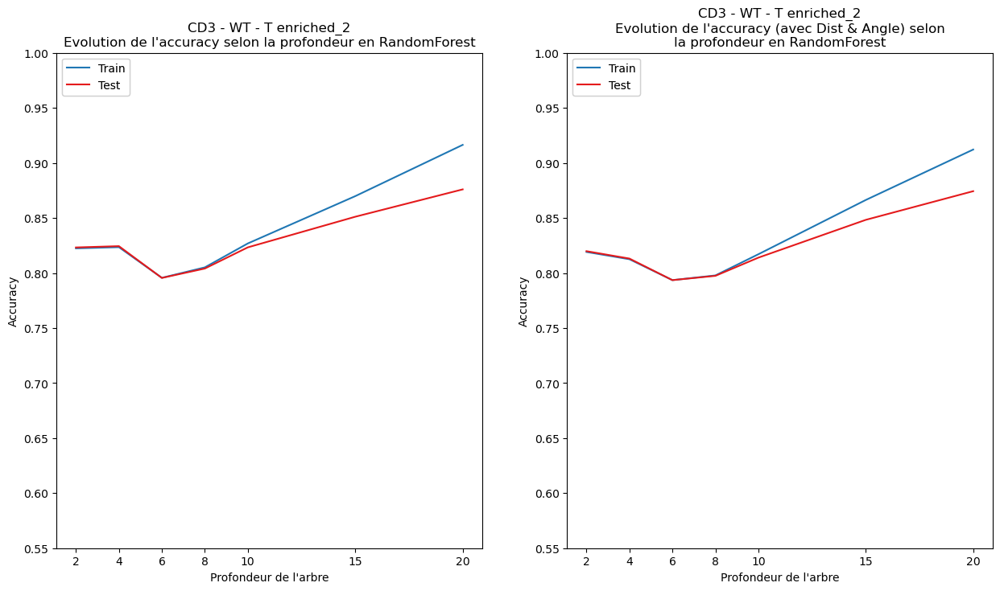

In [115]:
# Plot - auc
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_t_enrich_2_rf["auc_train"],
    results_t_enrich_2_rf["auc_test"],
    indices=results_t_enrich_2_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T enriched_2\n"
          "Evolution de l'AUC selon la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=results_t_enrich_2_rf["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=1, figure=(fig, ax1)
)

plots.plot(
    results_loc_t_enrich_2_rf["auc_train"],
    results_loc_t_enrich_2_rf["auc_test"],
    indices=results_loc_t_enrich_2_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T enriched_2\n"
          "Evolution de l'AUC (avec Dist & Angle) selon\n"
          "la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=results_loc_t_enrich_2_rf["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=1, figure=(fig, ax2)
)

# Saving plot
fig.savefig(f"{enrich2_perf_dirpath}{sess}_t-enriched-2_auc-rforest")

# Showing plot
plt.show()

# Plot - accuracy
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_t_enrich_2_rf["acc_train"],
    results_t_enrich_2_rf["acc_test"],
    indices=results_t_enrich_2_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T enriched_2\n"
          "Evolution de l'accuracy selon la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=results_t_enrich_2_rf["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=1, figure=(fig, ax1)
)

plots.plot(
    results_loc_t_enrich_2_rf["acc_train"],
    results_loc_t_enrich_2_rf["acc_test"],
    indices=results_loc_t_enrich_2_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T enriched_2\n"
          "Evolution de l'accuracy (avec Dist & Angle) selon\n"
          "la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=results_loc_t_enrich_2_rf["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=1, figure=(fig, ax2)
)

# Saving plot
fig.savefig(f"{enrich2_perf_dirpath}{sess}_t-enriched-2_accuracy-rforest")

# Showing plot
plt.show()

In [116]:
print("----- Résumé des performances en classe T enrichie-2, random forest -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_t_enrich_2_rf["depths"]] ; print("\n")

print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich_2_rf["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich_2_rf["auc_test"]] ; print("\n")
print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich_2_rf["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich_2_rf["acc_test"]] ; print("\n")
print(f"{'MCC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich_2_rf["mcc_train"]] ; print()
print(f"{'MCC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enrich_2_rf["mcc_test"]] ; print("\n")

print("--- with Dist & Angle")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich_2_rf["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich_2_rf["auc_test"]] ; print("\n")
print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich_2_rf["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich_2_rf["acc_test"]] ; print("\n")
print(f"{'MCC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich_2_rf["mcc_train"]] ; print()
print(f"{'MCC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_t_enrich_2_rf["mcc_test"]] ; print()

----- Résumé des performances en classe T enrichie-2, random forest -----
Profondeur          : 2     4     6     8     10    15    20    

AUC_train           : 0.76  0.76  0.79  0.80  0.81  0.85  0.89  
AUC_test            : 0.76  0.76  0.79  0.79  0.80  0.81  0.80  

Accuracy_train      : 0.82  0.82  0.80  0.81  0.83  0.87  0.92  
Accuracy_test       : 0.82  0.82  0.80  0.80  0.82  0.85  0.88  

MCC_train           : 0.44  0.45  0.46  0.48  0.51  0.60  0.71  
MCC_test            : 0.45  0.45  0.46  0.47  0.50  0.54  0.56  

--- with Dist & Angle
AUC_train_dist      : 0.76  0.78  0.80  0.80  0.82  0.86  0.90  
AUC_test_dist       : 0.76  0.78  0.79  0.80  0.81  0.83  0.82  

Accuracy_train_dist : 0.82  0.81  0.79  0.80  0.82  0.87  0.91  
Accuracy_test_dist  : 0.82  0.81  0.79  0.80  0.81  0.85  0.87  

MCC_train_dist      : 0.44  0.47  0.47  0.48  0.51  0.61  0.71  
MCC_test_dist       : 0.44  0.47  0.47  0.48  0.50  0.55  0.58  


In [117]:
# Random search parameters
n_estimators_enrich_2 = (10, 15, 20, 30)
n_depths_enrich_2 = (2, 4, 8, 10, 15, 18)

Best hyperparameters: {'n_estimators': 20, 'max_depth': 15}
Test Accuracy: 0.8505773472300308
Computing MDI importances
Elapsed time to compute mean decrease impurity (MDI) importance: 0.005 seconds

Computing permutation importances 
Elapsed time to compute permutation importance: 19.096 seconds



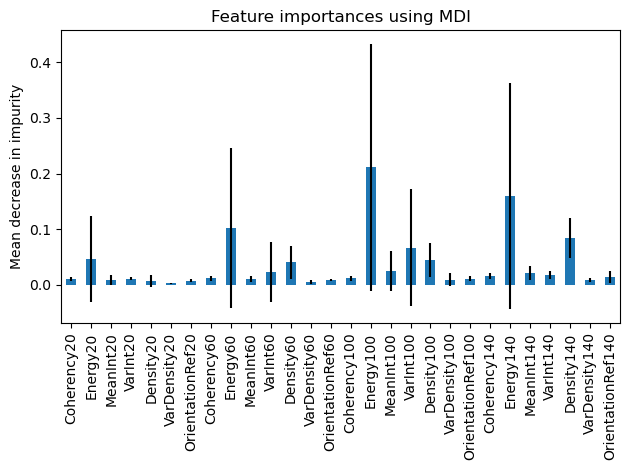

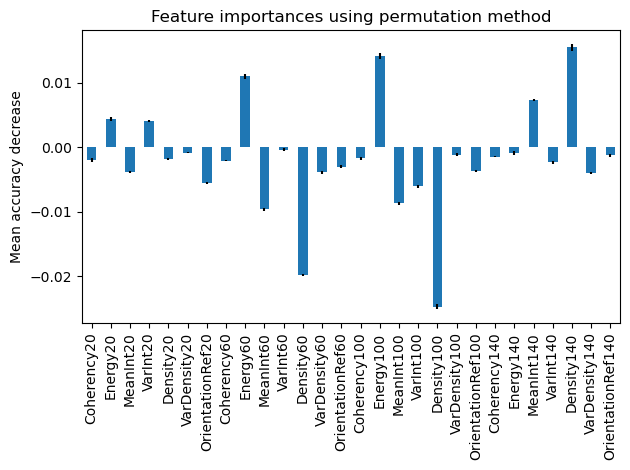

In [118]:
# RandomForest model
results_rf_enrich_2 = models.perform_random_forest(
    x_train=x_train,
    x_test=x_test,
    y_train=y_train,
    y_test=y_test,
    columns=x_columns,
    n_estimators=n_estimators_enrich_2,
    n_depths=n_depths_enrich_2,
    class_weight="balanced",
    scale=False,
    seed=seed
)

# Save MDI importances
df_mdi_rf_enrich_2 = pd.DataFrame(
    {
        "mean": results_rf_enrich_2["importance_mdi"]["mean"],
        "std": results_rf_enrich_2["importance_mdi"]["std"]
    }, index=x_columns
)

df_mdi_rf_enrich_2.to_csv(f"{enrich2_imp_dirpath}{sess}_t-enriched-2_mdi_rforest.csv")  # save

# Save permutation importances
df_permutation_rf_enrich_2 = pd.DataFrame(
    {
        "mean": results_rf_enrich_2["importance_permutation"]["mean"],
        "std": results_rf_enrich_2["importance_permutation"]["std"]
    }, index=x_columns
)

df_permutation_rf_enrich_2.to_csv(f"{enrich2_imp_dirpath}{sess}_t-enriched-2_permu_rforest.csv")  # save

# Model with best parameters
rf_enrich_2 = results_rf_enrich_2["model"]

Best hyperparameters: {'n_estimators': 20, 'max_depth': 15}
Test Accuracy: 0.846897028932232
Computing MDI importances
Elapsed time to compute mean decrease impurity (MDI) importance: 0.007 seconds

Computing permutation importances 
Elapsed time to compute permutation importance: 23.240 seconds



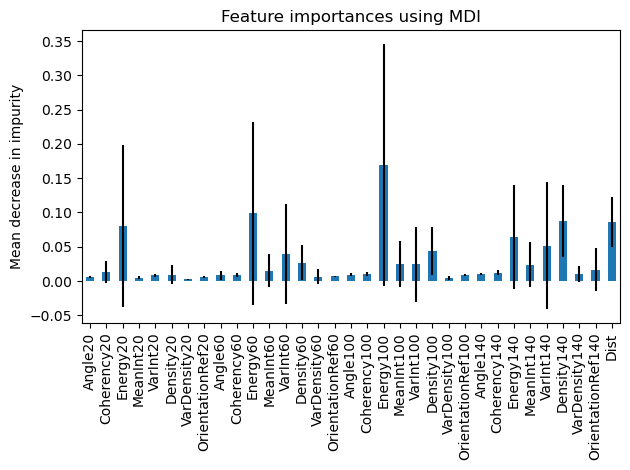

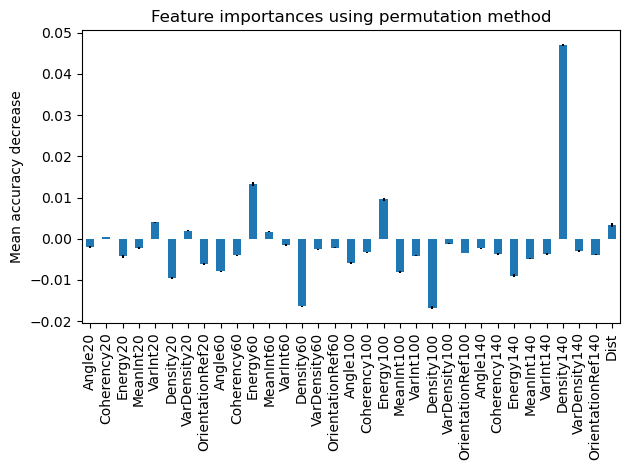

In [119]:
# RandomForest model with Dist & Angle columns
results_rf_loc_enrich_2 = models.perform_random_forest(
    x_train=x_loc_train,
    x_test=x_loc_test,
    y_train=y_loc_train,
    y_test=y_loc_test,
    columns=x_loc_columns,
    n_estimators=n_estimators_enrich_2,
    n_depths=n_depths_enrich_2,
    class_weight="balanced",
    scale=False,
    seed=seed
)

# Save MDI importances
df_mdi_rf_loc_enrich_2 = pd.DataFrame(
    {
        "mean": results_rf_loc_enrich_2["importance_mdi"]["mean"],
        "std": results_rf_loc_enrich_2["importance_mdi"]["std"]
    }, index=x_loc_columns
)

df_mdi_rf_loc_enrich_2.to_csv(f"{enrich2_imp_dirpath}{sess}_t-enriched-2_loc-mdi_rforest.csv")  # save

# Save permutation importances
df_permutation_rf_loc_plus = pd.DataFrame(
    {
        "mean": results_rf_loc_enrich_2["importance_permutation"]["mean"],
        "std": results_rf_loc_enrich_2["importance_permutation"]["std"]
    }, index=x_loc_columns
)

df_permutation_rf_loc_plus.to_csv(f"{enrich2_imp_dirpath}{sess}_t-enriched-2_loc-permu_rforest.csv")

# Model with best parameters
rf_loc_enrich_2 = results_rf_loc_enrich_2["model"]

In [120]:
# Prediction on train and validation
y_train_pred_rf = rf_enrich_2.predict(x_train)
y_test_pred_rf = rf_enrich_2.predict(x_test)

y_loc_train_pred_rf = rf_loc_enrich_2.predict(x_loc_train)
y_loc_test_pred_rf = rf_loc_enrich_2.predict(x_loc_test)

# Labels
labels_class_enrich_2

array(['not_enriched-2', 'enriched-2'], dtype=object)

In [121]:
# ROC values - false positive rate (fpr), and true positive rate (tpr)
fpr_train_rf, tpr_train_rf, _ = roc_curve(y_train, y_train_pred_rf)
fpr_test_rf, tpr_test_rf, _ = roc_curve(y_test, y_test_pred_rf)

fpr_loc_train_rf, tpr_loc_train_rf, _ = roc_curve(y_loc_train, y_loc_train_pred_rf)
fpr_loc_test_rf, tpr_loc_test_rf, _ = roc_curve(y_loc_test, y_loc_test_pred_rf)

# Model performances, how often is the classifier correct?
# train
acc_train_rf = accuracy_score(y_train, y_train_pred_rf)
mcc_train_rf = matthews_corrcoef(y_train, y_train_pred_rf)
auc_train_rf = auc(fpr_train_rf, tpr_train_rf)
# test
acc_test_rf = accuracy_score(y_test, y_test_pred_rf)
mcc_test_rf = matthews_corrcoef(y_test, y_test_pred_rf)
auc_test_rf = auc(fpr_test_rf, tpr_test_rf)

# with dist & angle
# train
acc_loc_train_rf = accuracy_score(y_loc_train, y_loc_train_pred_rf)
mcc_loc_train_rf = matthews_corrcoef(y_loc_train, y_loc_train_pred_rf)
auc_loc_train_rf = auc(fpr_loc_train_rf, tpr_loc_train_rf)
# test
acc_loc_test_rf = accuracy_score(y_loc_test, y_loc_test_pred_rf)
mcc_loc_test_rf = matthews_corrcoef(y_loc_test, y_loc_test_pred_rf)
auc_loc_test_rf = auc(fpr_loc_test_rf, tpr_loc_test_rf)

----- Random Forest T_enriched-2 -----
Train
Accuracy   = 0.870
AUC        = 0.849
MCC        = 0.601

Test
Accuracy   = 0.851
AUC        = 0.809
MCC        = 0.535


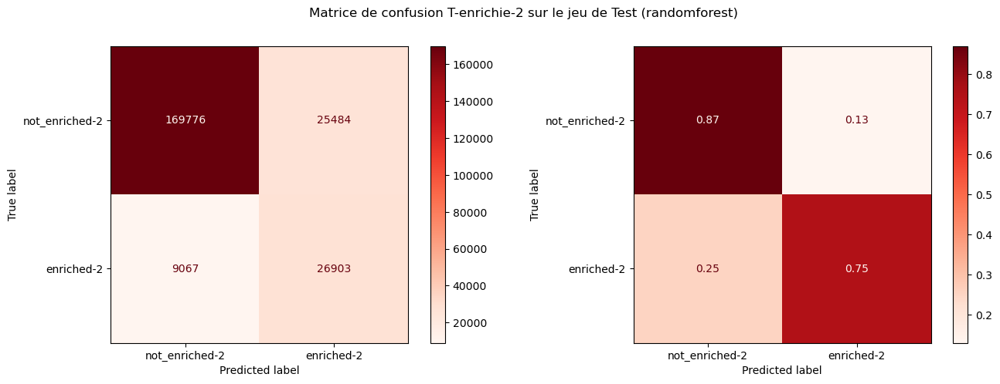

In [122]:
print("----- Random Forest T_enriched-2 -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_train_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_train_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_train_rf:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_test_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_test_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_test_rf:2.3f}")


# Confusion matrix
cmap_color = "Reds"
cmatrix = confusion_matrix(y_test, y_test_pred_rf)
cmatrix_norm = confusion_matrix(y_test, y_test_pred_rf, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T-enrichie-2 sur le jeu de Test (randomforest)")
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix,
    display_labels=labels_class_enrich_2,
).plot(ax=ax1, cmap=cmap_color)

ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_norm,
    display_labels=labels_class_enrich_2,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{enrich2_perf_dirpath}{sess}_t-enriched-2_cmatrix-rforest-test")

# Show Figure
plt.show()

----- Random Forest T_enriched-2 (with Dist & Angle) -----
Train
Accuracy   = 0.865
AUC        = 0.860
MCC        = 0.608

Test
Accuracy   = 0.847
AUC        = 0.823
MCC        = 0.546


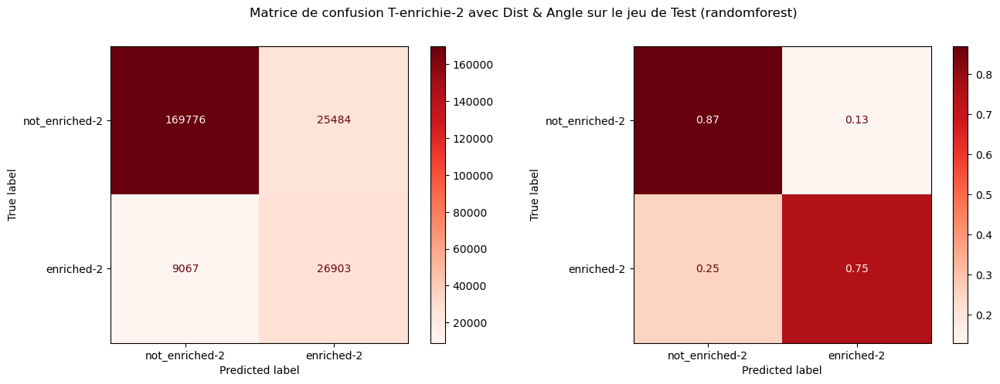

In [123]:
print("----- Random Forest T_enriched-2 (with Dist & Angle) -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_loc_train_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_train_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_train_rf:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_loc_test_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_test_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_test_rf:2.3f}")


# Confusion matrix
cmap_color = "Reds"
cmatrix_loc = confusion_matrix(y_loc_test, y_loc_test_pred_rf)
cmatrix_loc_norm = confusion_matrix(y_loc_test, y_loc_test_pred_rf, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T-enrichie-2 avec Dist & Angle sur le jeu de Test (randomforest)")
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix,
    display_labels=labels_class_enrich_2,
).plot(ax=ax1, cmap=cmap_color)

ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_norm,
    display_labels=labels_class_enrich_2,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{enrich2_perf_dirpath}{sess}_t-enriched-2_loc-cmatrix-rforest-test")

# Show Figure
plt.show()

# T enrichie 2 & Density20 > 0

Prédiction des fenêtres avec fibres de classes T-enrichie-2

##### Jeu de données d'apprentissage et de validation (à densité20 > 0)

In [124]:
# Target column
y_column = "class_t_enriched_2"

# Define x and y dataframe
xy = data[mask_cd3_density_in][x_loc_columns + [y_column]].dropna()

# features
x_dens = xy[x_columns].values  # x
x_dens_loc = xy[x_loc_columns].values  # x_loc

# target value
y_dens = xy[y_column].values  # y

# Train and Validation set
x_dens_train, x_dens_test, y_dens_train, y_dens_test = train_test_split(
    x_dens, y_dens, test_size=0.3, random_state=seed, stratify=y_dens
)

# Train and Validation set with Angle & Dist
x_loc_dens_train, x_loc_dens_test, y_loc_dens_train, y_loc_dens_test = train_test_split(
    x_dens_loc, y_dens, test_size=0.3, random_state=seed, stratify=y_dens
)

In [125]:
print(f"----- T enrichie 2 (density20 > 0)-----")
print(f"\n{'Comptage des classes :':<30s}{'0':<6s}{'':2s}{'1':>6s}")
print(f"{'y:':30s}{sum(y_dens == 0):>6d}{'':2s}{sum(y_dens == 1):>6d}")
print(f"{'y_train:':30s}{sum(y_dens_train == 0):>6d}{'':2s}{sum(y_dens_train == 1):>6d}")
print(f"{'y_test:':30s}{sum(y_dens_test == 0):>6d}{'':2s}{sum(y_dens_test == 1):>6d}")
print(f"\nNombre d'observations totales : {y_dens.shape[0]:_}")

----- T enrichie 2 (density20 > 0)-----

Comptage des classes :        0            1
y:                            285326   85814
y_train:                      199728   60070
y_test:                        85598   25744

Nombre d'observations totales : 371_140


# Arbre de décision

In [126]:
depths_dtree = [2, 4, 6, 8, 10, 15, 20]

# Results with best selected depth
results_dens_t_enrich_2 = models.forest_depth_acc(
    x_dens_train, y_dens_train,
    x_dens_test, y_dens_test,
    depths=depths_dtree,
    random_state=seed,
    classifier=DecisionTreeClassifier,
    class_weight="balanced",
)

# Results with best selected depth (with Dist & Angle)
results_loc_dens_t_enrich_2 = models.forest_depth_acc(
    x_loc_dens_train, y_loc_dens_train,
    x_loc_dens_test, y_loc_dens_test,
    depths=depths_dtree,
    random_state=seed,
    classifier=DecisionTreeClassifier,
    class_weight="balanced",
)

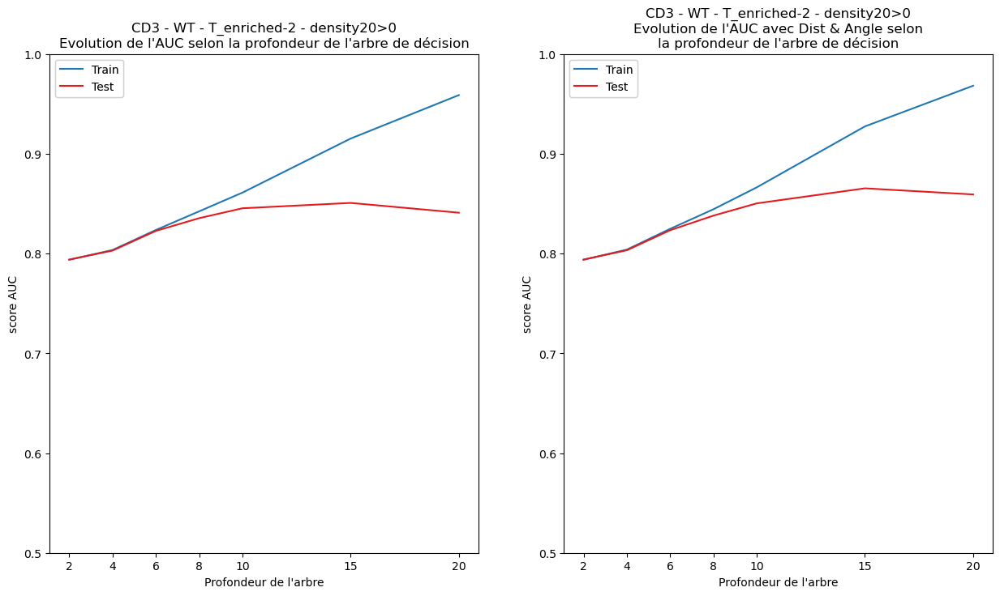

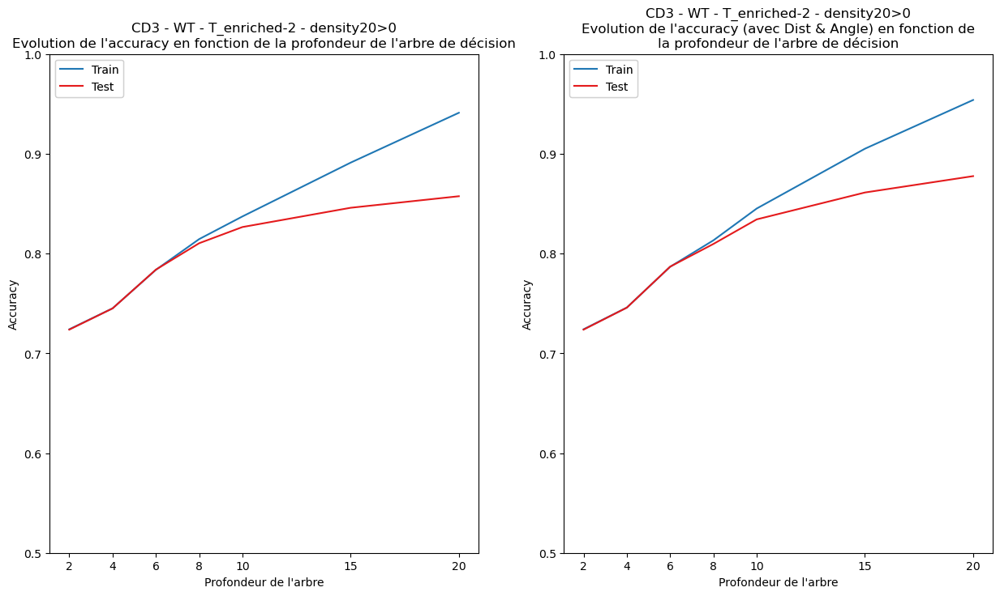

In [127]:
# Plot - AUC
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))
plots.plot(
    results_dens_t_enrich_2["auc_train"],
    results_dens_t_enrich_2["auc_test"],
    indices=results_dens_t_enrich_2["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T_enriched-2 - density20>0\n"
          "Evolution de l'AUC selon la profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=results_dens_t_enrich_2["depths"], showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax1),
)

plots.plot(
    results_loc_dens_t_enrich_2["auc_train"],
    results_loc_dens_t_enrich_2["auc_test"],
    indices=results_loc_dens_t_enrich_2["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T_enriched-2 - density20>0\n"
          "Evolution de l'AUC avec Dist & Angle selon\n"
          "la profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=results_loc_dens_t_enrich_2["depths"], showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax2),
)

# Saving plot
fig.savefig(f"{enrich2_perf_dirpath}{sess}_t-enriched-2-density_auc-decisiontree")

# Showing plot
plt.show()

# Plot - accuracy
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_dens_t_enrich_2["acc_train"],
    results_dens_t_enrich_2["acc_test"],
    indices=results_dens_t_enrich_2["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T_enriched-2 - density20>0\n"
          "Evolution de l'accuracy en fonction de la "
          "profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=results_dens_t_enrich_2["depths"], showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax1)
)

plots.plot(
    results_loc_dens_t_enrich_2["acc_train"],
    results_loc_dens_t_enrich_2["acc_test"],
    indices=results_loc_dens_t_enrich_2["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T_enriched-2 - density20>0\n"
          "Evolution de l'accuracy (avec Dist & Angle) en "
          "fonction de\nla profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=results_loc_dens_t_enrich_2["depths"], showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax2),
)

# Saving plot
fig.savefig(f"{enrich2_perf_dirpath}{sess}_t-enriched-2-density_accuracy-decisiontree")

# Showing plot
plt.show()

In [128]:
print("----- Résumé des performances en classe T enrichie_2 - density, arbre de décision -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_dens_t_enrich_2["depths"]] ; print("\n")

print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich_2["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich_2["auc_test"]] ; print("\n")
print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich_2["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich_2["acc_test"]] ; print("\n")
print(f"{'MCC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich_2["mcc_train"]] ; print()
print(f"{'MCC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich_2["mcc_test"]] ; print("\n")

print("--- with Dist & Angle")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich_2["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich_2["auc_test"]] ; print("\n")
print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich_2["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich_2["acc_test"]] ; print("\n")
print(f"{'MCC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich_2["mcc_train"]] ; print()
print(f"{'MCC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich_2["mcc_test"]] ; print()


----- Résumé des performances en classe T enrichie_2 - density, arbre de décision -----
Profondeur          : 2     4     6     8     10    15    20    

AUC_train           : 0.79  0.80  0.82  0.84  0.86  0.92  0.96  
AUC_test            : 0.79  0.80  0.82  0.84  0.85  0.85  0.84  

Accuracy_train      : 0.72  0.75  0.78  0.81  0.84  0.89  0.94  
Accuracy_test       : 0.72  0.75  0.78  0.81  0.83  0.85  0.86  

MCC_train           : 0.50  0.52  0.56  0.60  0.64  0.75  0.86  
MCC_test            : 0.50  0.51  0.56  0.59  0.61  0.63  0.64  

--- with Dist & Angle
AUC_train_dist      : 0.79  0.80  0.82  0.84  0.87  0.93  0.97  
AUC_test_dist       : 0.79  0.80  0.82  0.84  0.85  0.87  0.86  

Accuracy_train_dist : 0.72  0.75  0.79  0.81  0.85  0.91  0.95  
Accuracy_test_dist  : 0.72  0.75  0.79  0.81  0.83  0.86  0.88  

MCC_train_dist      : 0.50  0.52  0.56  0.60  0.65  0.78  0.88  
MCC_test_dist       : 0.50  0.51  0.56  0.59  0.62  0.67  0.68  


In [129]:
# Decision Tree (CART)
dtree_dens_enrich_2 = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=10,
    random_state=seed,
    class_weight="balanced",
)

# Decision Tree (CART) with Dist column
dtree_loc_dens_enrich_2 = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=10,
    random_state=seed,
    class_weight="balanced",
)

In [130]:
# Fitting models to the data
dtree_dens_enrich_2.fit(x_dens_train, y_dens_train)
dtree_loc_dens_enrich_2.fit(x_loc_dens_train, y_loc_dens_train)

# Prediction on train and validation
y_dens_train_pred = dtree_dens_enrich_2.predict(x_dens_train)
y_dens_test_pred = dtree_dens_enrich_2.predict(x_dens_test)

y_loc_dens_train_pred = dtree_loc_dens_enrich_2.predict(x_loc_dens_train)
y_loc_dens_test_pred = dtree_loc_dens_enrich_2.predict(x_loc_dens_test)

# Labels
dtree_dens_enrich_2.classes_ = \
dtree_loc_dens_enrich_2.classes_ = \
labels_class_enrich_2 = pd.Series(dtree_dens_enrich_2.classes_).map(
    {0: 'not_enriched_2', 1: 'enriched_2'}
).values

----- Arbre de décision - T_enriched-2 - density20 > 0 -----
Train
Accuracy   = 0.853
AUC        = 0.866
MCC        = 0.691

Test
Accuracy   = 0.830
AUC        = 0.840
MCC        = 0.640


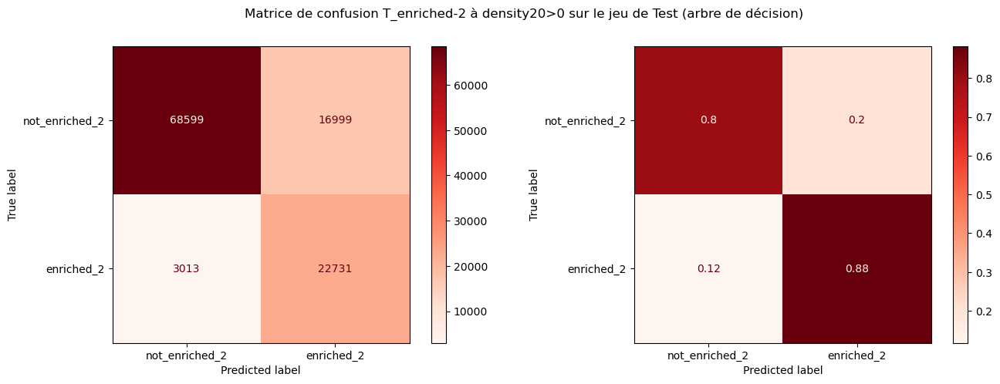

In [131]:
print("----- Arbre de décision - T_enriched-2 - density20 > 0 -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_dens_train:2.3f}")
print(f"{'AUC':<10s} = {auc_dens_train:2.3f}")
print(f"{'MCC':<10s} = {mcc_dens_train:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_dens_test:2.3f}")
print(f"{'AUC':<10s} = {auc_dens_test:2.3f}")
print(f"{'MCC':<10s} = {mcc_dens_test:2.3f}")

# Confusion matrix
cmap_color = "Reds"
cmatrix = confusion_matrix(y_dens_test, y_dens_test_pred)
cmatrix_norm = confusion_matrix(y_dens_test, y_dens_test_pred, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T_enriched-2 à density20>0 sur le jeu de Test (arbre de décision)")
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix,
    display_labels=labels_class_enrich_2,
).plot(ax=ax1, cmap=cmap_color)

ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_norm,
    display_labels=labels_class_enrich_2,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{enrich2_perf_dirpath}{sess}_t-enriched-2-density_cmatrix-test")

# Show Figure
plt.show()

----- Arbre de décision - T_enriched-2 - density20 > 0 (with Dist & Angle) -----
Train
Accuracy   = 0.860
AUC        = 0.873
MCC        = 0.705

Test
Accuracy   = 0.839
AUC        = 0.849
MCC        = 0.658


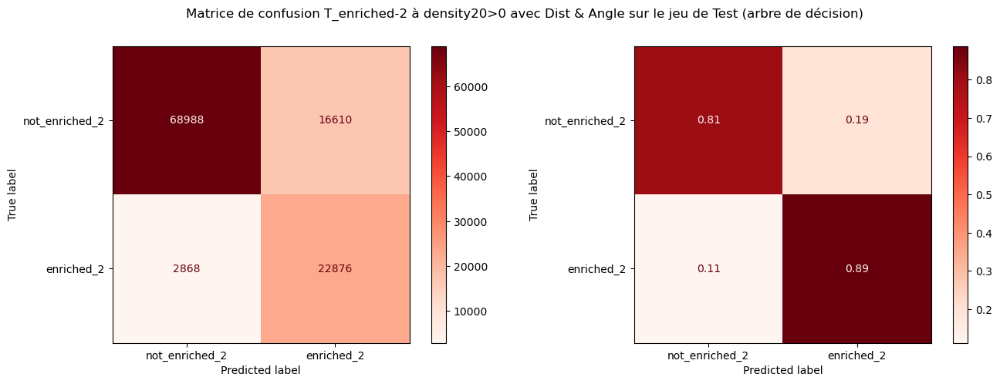

In [132]:
print("----- Arbre de décision - T_enriched-2 - density20 > 0 (with Dist & Angle) -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_loc_dens_train:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_dens_train:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_dens_train:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_loc_dens_test:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_dens_test:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_dens_test:2.3f}")

# Confusion matrix
cmap_color = "Reds"
cmatrix_loc = confusion_matrix(y_loc_dens_test, y_loc_dens_test_pred)
cmatrix_loc_norm = confusion_matrix(y_loc_dens_test, y_loc_dens_test_pred, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T_enriched-2 à density20>0 avec Dist & Angle sur le jeu de Test (arbre de décision)")
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc,
    display_labels=labels_class_enrich_2,
).plot(ax=ax1, cmap=cmap_color)

ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc_norm,
    display_labels=labels_class_enrich_2,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{enrich2_perf_dirpath}{sess}_t-enriched-2-density_loc-cmatrix-test")

# Show Figure
plt.show()

In [133]:
# Decision tree text representation
dtree_dens_text = tree.export_text(
    dtree_dens_enrich_2,
    feature_names=x_columns,
    #class_names=dtree_dens_enrich_2.classes_,  # sklearn > 1.3.0
    max_depth=16
)

with open(f"{enrich2_tree_dirpath}{sess}_t-enriched-2-density_text-dtree.txt", "w") as txt:
    txt.write(dtree_dens_text)

# Decision tree plot (too large)
dtree_dens_dot = tree.export_graphviz(
    dtree_dens_enrich_2,
    feature_names=x_columns,
    class_names=dtree_dens_enrich_2.classes_,
    filled=True
)
dtree_dens_dot = plots.node_color(dtree_dens_dot)

dtree_dens_graph = graphviz.Source(dtree_dens_dot, format="png")
dtree_dens_graph.render(f"{enrich2_tree_dirpath}{sess}_t-enriched-2-density_dtree")
dtree_dens_graph


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.195386 to fit


In [134]:
# Decision tree text representation
dtree_loc_dens_text = tree.export_text(
    dtree_loc_dens_enrich_2,
    feature_names=x_loc_columns,
    #class_names=dtree_loc_dens_enrich_2.classes_,  # sklearn > 1.3.0
    max_depth=16
)

with open(f"{enrich2_tree_dirpath}{sess}_t-enriched-2-density_loc-text-dtree.txt", "w") as txt:
    txt.write(dtree_loc_dens_text)

# Decision tree plot (too large)
dtree_loc_dens_dot = tree.export_graphviz(
    dtree_loc_dens_enrich_2,
    feature_names=x_loc_columns,
    class_names=dtree_loc_dens_enrich_2.classes_,
    filled=True
)
dtree_loc_dens_dot = plots.node_color(dtree_loc_dens_dot)

dtree_loc_dens_graph = graphviz.Source(dtree_loc_dens_dot, format="png")
dtree_loc_dens_graph.render(f"{enrich2_tree_dirpath}{sess}_t-enriched-2-density_loc-dtree")
dtree_loc_dens_graph

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.19744 to fit


# Random Forest

In [135]:
depths_rf = [2, 6, 10, 15, 20]
results_dens_t_enrich_2_rf = models.forest_depth_acc(
    x_dens_train, y_dens_train,
    x_dens_test, y_dens_test,
    depths=depths_rf, 
    classifier=RandomForestClassifier,
    n_estimators = 25,
    random_state=seed,
    class_weight="balanced",
    n_jobs=-1
)

results_loc_dens_t_enrich_2_rf = models.forest_depth_acc(
    x_loc_dens_train, y_loc_dens_train,
    x_loc_dens_test, y_loc_dens_test,
    depths=depths_rf, 
    classifier=RandomForestClassifier,
    n_estimators = 25,
    random_state=seed,
    class_weight="balanced",
    n_jobs=-1
)

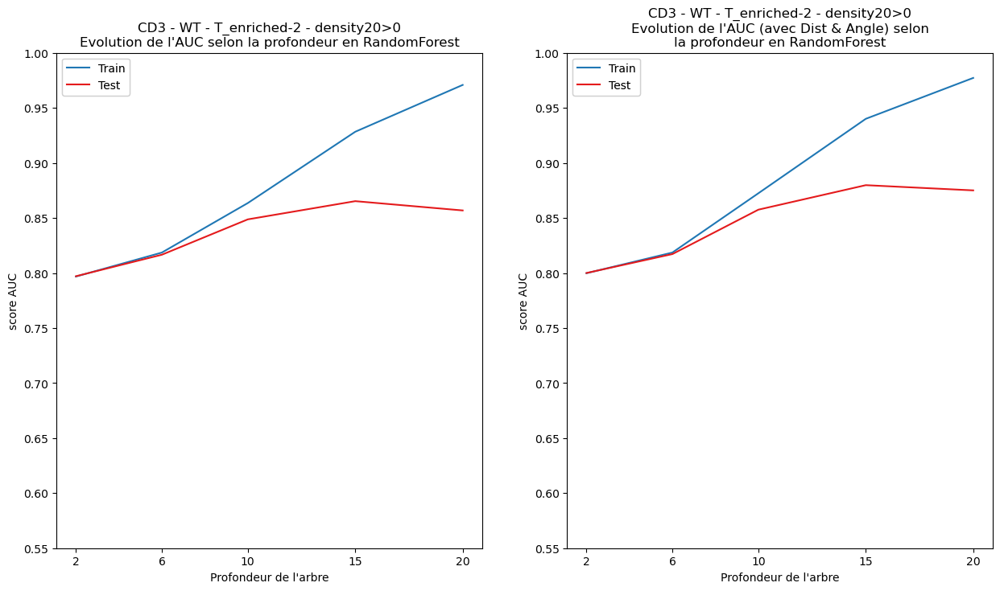

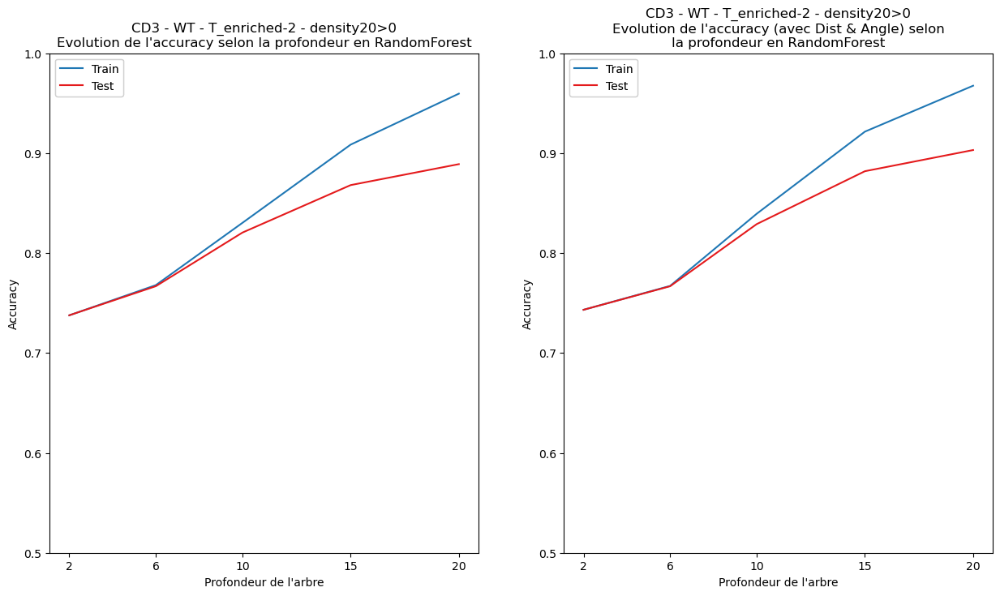

In [136]:
# Plot - auc
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_dens_t_enrich_2_rf["auc_train"],
    results_dens_t_enrich_2_rf["auc_test"],
    indices=results_dens_t_enrich_2_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T_enriched-2 - density20>0\n"
          "Evolution de l'AUC selon la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=results_dens_t_enrich_2_rf["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=1, figure=(fig, ax1)
)

plots.plot(
    results_loc_dens_t_enrich_2_rf["auc_train"],
    results_loc_dens_t_enrich_2_rf["auc_test"],
    indices=results_loc_dens_t_enrich_2_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T_enriched-2 - density20>0\n"
          "Evolution de l'AUC (avec Dist & Angle) selon\n"
          "la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="score AUC",
    xticks=results_loc_dens_t_enrich_2_rf["depths"], showR2=False, showY=False,
    ybottom=0.55, ytop=1, figure=(fig, ax2)
)

# Saving plot
fig.savefig(f"{enrich2_perf_dirpath}{sess}_t-enriched-2-density_auc-rforest")

# Showing plot
plt.show()

# Plot - accuracy
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_dens_t_enrich_2_rf["acc_train"],
    results_dens_t_enrich_2_rf["acc_test"],
    indices=results_dens_t_enrich_2_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T_enriched-2 - density20>0\n"
          "Evolution de l'accuracy selon la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=results_dens_t_enrich_2_rf["depths"], showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax1)
)

plots.plot(
    results_loc_dens_t_enrich_2_rf["acc_train"],
    results_loc_dens_t_enrich_2_rf["acc_test"],
    indices=results_loc_dens_t_enrich_2_rf["depths"],
    label=("Train", "Test"),
    title=f"{type.upper()} - {condition.upper()} - T_enriched-2 - density20>0\n"
          "Evolution de l'accuracy (avec Dist & Angle) selon\n"
          "la profondeur en RandomForest",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=results_loc_dens_t_enrich_2_rf["depths"], showR2=False, showY=False,
    ybottom=0.5, ytop=1, figure=(fig, ax2)
)

# Saving plot
fig.savefig(f"{enrich2_perf_dirpath}{sess}_t-enriched-2-density_accuracy-rforest")

# Showing plot
plt.show()

In [137]:
print("----- Résumé des performances T enrichie 2 - density20>0, arbre de décision -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_dens_t_enrich_2_rf["depths"]] ; print("\n")

print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich_2_rf["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich_2_rf["auc_test"]] ; print("\n")
print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich_2_rf["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich_2_rf["acc_test"]] ; print("\n")
print(f"{'MCC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich_2_rf["mcc_train"]] ; print()
print(f"{'MCC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dens_t_enrich_2_rf["mcc_test"]] ; print("\n")

print("--- with Dist & Angle")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich_2_rf["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich_2_rf["auc_test"]] ; print("\n")
print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich_2_rf["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich_2_rf["acc_test"]] ; print("\n")
print(f"{'MCC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich_2_rf["mcc_train"]] ; print()
print(f"{'MCC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_loc_dens_t_enrich_2_rf["mcc_test"]] ; print()

----- Résumé des performances T enrichie 2 - density20>0, arbre de décision -----
Profondeur          : 2     6     10    15    20    

AUC_train           : 0.80  0.82  0.86  0.93  0.97  
AUC_test            : 0.80  0.82  0.85  0.87  0.86  

Accuracy_train      : 0.74  0.77  0.83  0.91  0.96  
Accuracy_test       : 0.74  0.77  0.82  0.87  0.89  

MCC_train           : 0.50  0.54  0.64  0.78  0.90  
MCC_test            : 0.50  0.54  0.61  0.67  0.70  

--- with Dist & Angle
AUC_train_dist      : 0.80  0.82  0.87  0.94  0.98  
AUC_test_dist       : 0.80  0.82  0.86  0.88  0.88  

Accuracy_train_dist : 0.74  0.77  0.84  0.92  0.97  
Accuracy_test_dist  : 0.74  0.77  0.83  0.88  0.90  

MCC_train_dist      : 0.51  0.54  0.65  0.81  0.92  
MCC_test_dist       : 0.51  0.54  0.63  0.70  0.73  


In [138]:
# Random search parameters
n_estimators_dens_enrich_2 = (10, 15, 20, 30)
n_depths_dens_enrich_2 = (2, 4, 8, 10, 15)

Best hyperparameters: {'n_estimators': 15, 'max_depth': 15}
Test Accuracy: 0.865648183075569
Computing MDI importances
Elapsed time to compute mean decrease impurity (MDI) importance: 0.002 seconds

Computing permutation importances 
Elapsed time to compute permutation importance: 7.131 seconds



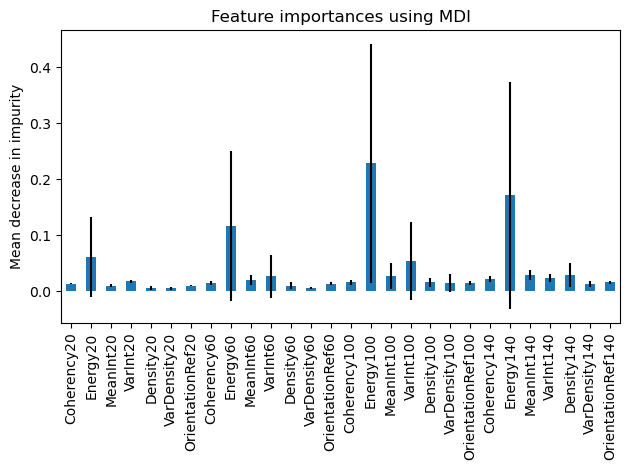

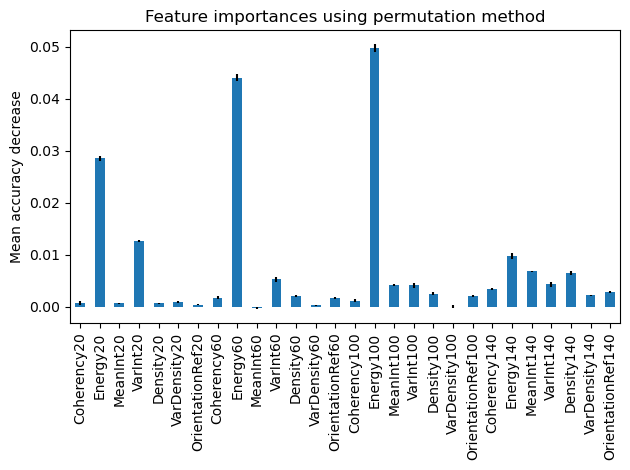

In [139]:
# RandomForest model
results_rf_dens_enrich_2 = models.perform_random_forest(
    x_train=x_dens_train,
    x_test=x_dens_test,
    y_train=y_dens_train,
    y_test=y_dens_test,
    columns=x_columns,
    n_estimators=n_estimators_dens_enrich_2,
    n_depths=n_depths_dens_enrich_2,
    class_weight="balanced",
    scale=False,
    seed=seed
)

# Save MDI importances
df_mdi_rf_dens_enrich_2 = pd.DataFrame(
    {
        "mean": results_rf_dens_enrich_2["importance_mdi"]["mean"],
        "std": results_rf_dens_enrich_2["importance_mdi"]["std"]
    }, index=x_columns
)

df_mdi_rf_dens_enrich_2.to_csv(f"{enrich2_imp_dirpath}{sess}_t-enriched-2-density_mdi_rforest.csv")  # save

# Save permutation importances
df_permutation_rf_dens_enrich_2 = pd.DataFrame(
    {
        "mean": results_rf_dens_enrich_2["importance_permutation"]["mean"],
        "std": results_rf_dens_enrich_2["importance_permutation"]["std"]
    }, index=x_columns
)

df_permutation_rf_dens_enrich_2.to_csv(f"{enrich2_imp_dirpath}{sess}_t-enriched-2-density_permu_rforest.csv")  # save

# Model with best parameters
rf_dens_enrich_2 = results_rf_dens_enrich_2["model"]

Best hyperparameters: {'n_estimators': 15, 'max_depth': 15}
Test Accuracy: 0.8796141617718382
Computing MDI importances
Elapsed time to compute mean decrease impurity (MDI) importance: 0.002 seconds

Computing permutation importances 
Elapsed time to compute permutation importance: 8.280 seconds



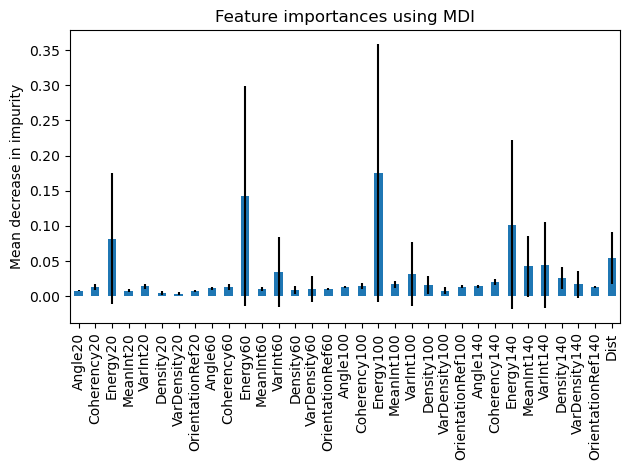

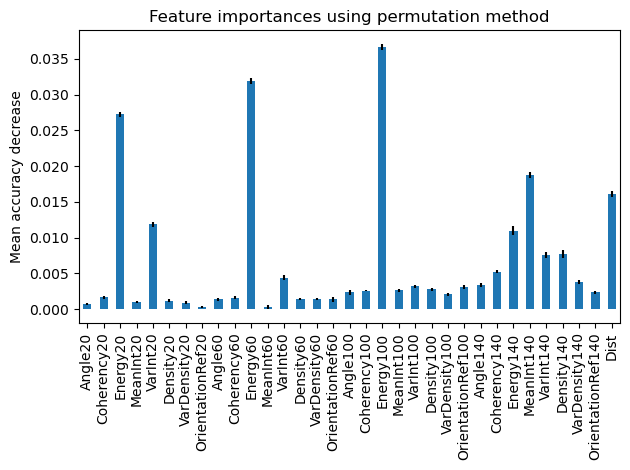

In [140]:
# Random forest with Dist & Angle
results_rf_loc_dens_enrich_2 = models.perform_random_forest(
    x_train=x_loc_dens_train,
    x_test=x_loc_dens_test,
    y_train=y_loc_dens_train,
    y_test=y_loc_dens_test,
    columns=x_loc_columns,
    n_estimators=n_estimators_dens_enrich_2,
    n_depths=n_depths_dens_enrich_2,
    class_weight="balanced",
    scale=False,
    seed=seed
)

# Save MDI importances
df_mdi_rf_loc_dens_enrich_2 = pd.DataFrame(
    {
        "mean": results_rf_loc_dens_enrich_2["importance_mdi"]["mean"],
        "std": results_rf_loc_dens_enrich_2["importance_mdi"]["std"]
    }, index=x_loc_columns
)

df_mdi_rf_loc_dens_enrich_2.to_csv(f"{enrich2_imp_dirpath}{sess}_t-enriched-2-density_loc-mdi_rforest.csv")  # save

# Save permutation importances
df_permutation_rf_loc_dens_enrich_2 = pd.DataFrame(
    {
        "mean": results_rf_loc_dens_enrich_2["importance_permutation"]["mean"],
        "std": results_rf_loc_dens_enrich_2["importance_permutation"]["std"]
    }, index=x_loc_columns
)

df_permutation_rf_loc_dens_enrich_2.to_csv(f"{enrich2_imp_dirpath}{sess}_t-enriched-2-density_loc-permu_rforest.csv")  # save

# Model with best parameters
rf_loc_dens_enrich_2 = results_rf_loc_dens_enrich_2["model"]

In [141]:
# Model Accuracy, how often is the classifier correct?
y_dens_train_pred_rf = rf_dens_enrich_2.predict(x_dens_train)
y_dens_test_pred_rf = rf_dens_enrich_2.predict(x_dens_test)

y_loc_dens_train_pred_rf = rf_loc_dens_enrich_2.predict(x_loc_dens_train)
y_loc_dens_test_pred_rf = rf_loc_dens_enrich_2.predict(x_loc_dens_test)

In [142]:
# Performance
fpr_dens_train_rf, tpr_dens_train_rf, _ = roc_curve(y_dens_train, y_dens_train_pred_rf)
fpr_dens_test_rf, tpr_dens_test_rf, _ = roc_curve(y_dens_test, y_dens_test_pred_rf)

fpr_loc_dens_train_rf, tpr_loc_dens_train_rf, _ = roc_curve(y_loc_dens_train, y_loc_dens_train_pred_rf)
fpr_loc_dens_test_rf, tpr_loc_dens_test_rf, _ = roc_curve(y_loc_dens_test, y_loc_dens_test_pred_rf)

# Model performances, how often is the classifier correct?
# train
acc_dens_train_rf = accuracy_score(y_dens_train, y_dens_train_pred_rf)
mcc_dens_train_rf = matthews_corrcoef(y_dens_train, y_dens_train_pred_rf)
auc_dens_train_rf = auc(fpr_dens_train_rf, tpr_dens_train_rf)
# test
acc_dens_test_rf = accuracy_score(y_dens_test, y_dens_test_pred_rf)
mcc_dens_test_rf = matthews_corrcoef(y_dens_test, y_dens_test_pred_rf)
auc_dens_test_rf = auc(fpr_dens_test_rf, tpr_dens_test_rf)

# with dist & angle
# train
acc_loc_dens_train_rf = accuracy_score(y_loc_dens_train, y_loc_dens_train_pred_rf)
mcc_loc_dens_train_rf = matthews_corrcoef(y_loc_dens_train, y_loc_dens_train_pred_rf)
auc_loc_dens_train_rf = auc(fpr_loc_dens_train_rf, tpr_loc_dens_train_rf)
# test
acc_loc_dens_test_rf = accuracy_score(y_loc_dens_test, y_loc_dens_test_pred_rf)
mcc_loc_dens_test_rf = matthews_corrcoef(y_loc_dens_test, y_loc_dens_test_pred_rf)
auc_loc_dens_test_rf = auc(fpr_loc_dens_test_rf, tpr_loc_dens_test_rf)

----- Random Forest T_enriched-2 - density20>0 -----
Train
Accuracy   = 0.906
AUC        = 0.926
MCC        = 0.778

Test
Accuracy   = 0.866
AUC        = 0.863
MCC        = 0.668


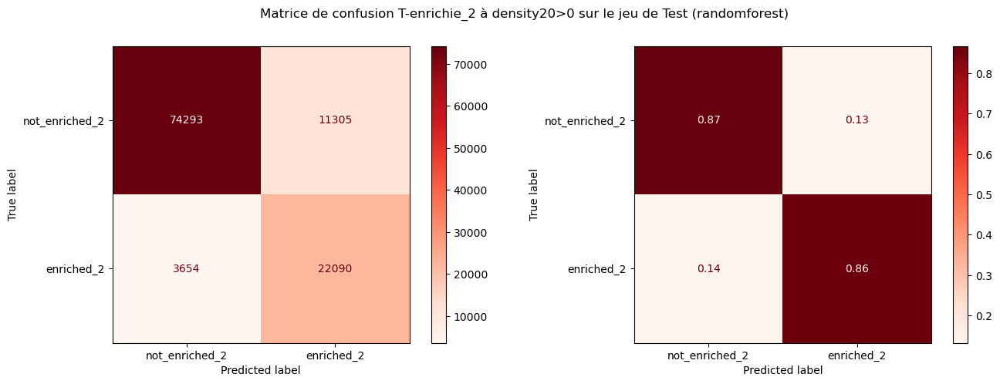

In [143]:
print("----- Random Forest T_enriched-2 - density20>0 -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_dens_train_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_dens_train_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_dens_train_rf:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_dens_test_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_dens_test_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_dens_test_rf:2.3f}")


# Confusion matrix
cmap_color = "Reds"
cmatrix = confusion_matrix(y_dens_test, y_dens_test_pred_rf)
cmatrix_norm = confusion_matrix(y_dens_test, y_dens_test_pred_rf, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T-enrichie_2 à density20>0 sur le jeu de Test (randomforest)")
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix,
    display_labels=labels_class_enrich_2,
).plot(ax=ax1, cmap=cmap_color)

ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_norm,
    display_labels=labels_class_enrich_2,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{enrich2_perf_dirpath}{sess}_t-enriched-2-density_cmatrix-rforest-test")

# Show Figure
plt.show()

----- Random Forest T_enriched-2 (with Dist & Angle) - density20>0 -----
Train
Accuracy   = 0.920
AUC        = 0.937
MCC        = 0.807

Test
Accuracy   = 0.880
AUC        = 0.876
MCC        = 0.698


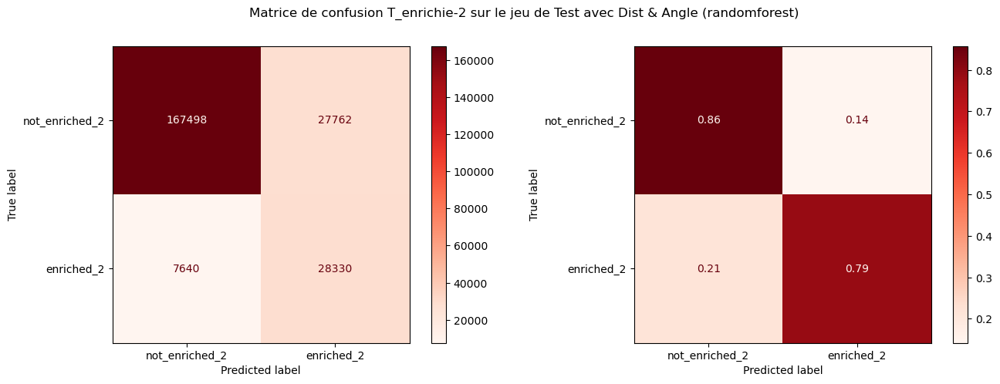

In [144]:
print("----- Random Forest T_enriched-2 (with Dist & Angle) - density20>0 -----")
print("Train")
print(f"{'Accuracy':<10s} = {acc_loc_dens_train_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_dens_train_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_dens_train_rf:2.3f}")
print()
print("Test")
print(f"{'Accuracy':<10s} = {acc_loc_dens_test_rf:2.3f}")
print(f"{'AUC':<10s} = {auc_loc_dens_test_rf:2.3f}")
print(f"{'MCC':<10s} = {mcc_loc_dens_test_rf:2.3f}")

# Confusion matrix
cmap_color = "Reds"
cmatrix_loc = confusion_matrix(y_loc_test, y_loc_test_pred_rf)
cmatrix_loc_norm = confusion_matrix(y_loc_test, y_loc_test_pred_rf, normalize="true")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
fig.suptitle("Matrice de confusion T_enrichie-2 sur le jeu de Test avec Dist & Angle (randomforest)")

# Confusion Matrix displaying count
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc,
    display_labels=labels_class_enrich_2,
).plot(ax=ax1, cmap=cmap_color)

# Confusion Matrix displaying ratio on true label
ConfusionMatrixDisplay(
    confusion_matrix=cmatrix_loc_norm,
    display_labels=labels_class_enrich_2,
).plot(ax=ax2, cmap=cmap_color)

# Save figure
fig.savefig(f"{enrich2_perf_dirpath}{sess}_t-enriched-2-density_loc-cmatrix-rforest-test")

# Show Figure
plt.show()